
# Exploring Feature Extraction Capabilities of the STEN for Creeping Landslides with Varying Input Lengths
## Introduction
This notebook investigates the feature extraction capabilities of our STEN model in the context of creeping landslides, focusing on exploring how the length of historical input data affects the model's ability to capture seasonal and trend-based deformation patterns.
Responding to a reviewer's suggestion, we aim to delve deeper into the neural network's feature extraction capabilities, investigating how the extracted features evolve as we adjust the length of the historical input data used by the STEN. By analyzing the cyclic and trend-related features learned by the network under different input length scenarios, we seek to gain insights into how the STEN model handles the complex temporal dynamics of slow-moving landslide processes.
### Objective

The primary objective of this study is to explore and interpret the impact of varying historical input lengths on the cyclic and trend-based features extracted by the neural network model for creeping landslide deformation data. This investigation will better understand the model's adaptability and potential to capture multi-scale temporal patterns inherent in landslide phenomena.
## Methods

 ### Feature Visualization
We will visualize the features extracted at different network layers under varying input length configurations (e.g., 24, 36, 48, 60, 100) to gain insights into how the neural network model's handling of seasonal and trend-related deformation patterns is affected by the length of the historical input data. This analysis will be conducted on the deformation data from the observation site `K3_3B1`, which exhibits clear seasonal patterns.


### Wavelet Function Analysis
We will use wavelet analysis techniques to examine the features of both observed and predicted deformation values throughout the training process under different input length settings. This approach will allow us to assess the model's ability to capture multiple frequency components in the landslide deformation data. It will provide a more comprehensive understanding of its feature extraction capabilities and how the historical input length influences them.

### Assessment of Predictive Capabilities and Limitations
Based on the feature extraction analysis under varying input length conditions, this section will discuss the neural network model's capabilities and limitations in predicting the cyclic and trend-based behaviors observed in the creeping landslide data.

In [1]:
! pip install PyWavelets

In [22]:
import pickle
import random
from time import time
from typing import Union

import itertools
import warnings

import matplotlib
import matplotlib.pyplot as plt
import numpy as np



import torch
from torch import nn, optim
from torch.nn import functional as F
from torch.nn.functional import mse_loss, l1_loss, binary_cross_entropy, cross_entropy
from torch.optim import Optimizer

warnings.filterwarnings('ignore')
import pywt

# Neural Network Architecture (STEN) Modifications for Improved Feature Extraction in Each Layer

In [23]:
class NBeatsNet2(nn.Module):
    SEASONALITY_BLOCK = 'seasonality'
    TREND_BLOCK = 'trend'
    GENERIC_BLOCK = 'generic'

    def __init__(
            self,
            device=torch.device('cpu'),
            stack_types=(TREND_BLOCK, SEASONALITY_BLOCK),
            nb_blocks_per_stack=3,
            forecast_length=5,
            backcast_length=10,
            thetas_dim=(4, 8),
            share_weights_in_stack=False,
            hidden_layer_units=256,
            nb_harmonics=None
    ):
        super(NBeatsNet2, self).__init__()
        self.forecast_length = forecast_length
        self.backcast_length = backcast_length
        self.hidden_layer_units = hidden_layer_units
        self.nb_blocks_per_stack = nb_blocks_per_stack
        self.share_weights_in_stack = share_weights_in_stack
        self.nb_harmonics = nb_harmonics
        self.stack_types = stack_types
        self.stacks = []
        self.thetas_dim = thetas_dim
        self.parameters = []
        self.device = device
        print('| N-Beats')
        for stack_id in range(len(self.stack_types)):
            self.stacks.append(self.create_stack(stack_id))
        self.parameters = nn.ParameterList(self.parameters)
        self.to(self.device)
        self._loss = None
        self._opt = None
        self._gen_intermediate_outputs = False
        self._intermediary_outputs = []

    def create_stack(self, stack_id):
        stack_type = self.stack_types[stack_id]
        print(f'| --  Stack {stack_type.title()} (#{stack_id}) (share_weights_in_stack={self.share_weights_in_stack})')
        blocks = []
        for block_id in range(self.nb_blocks_per_stack):
            block_init = NBeatsNet2.select_block(stack_type)
            if self.share_weights_in_stack and block_id != 0:
                block = blocks[-1]  # pick up the last one when we share weights.
            else:
                block = block_init(
                    self.hidden_layer_units, self.thetas_dim[stack_id],
                    self.device, self.backcast_length, self.forecast_length,
                    self.nb_harmonics
                )
                self.parameters.extend(block.parameters())
            print(f'     | -- {block}')
            blocks.append(block)
        return blocks

    def disable_intermediate_outputs(self):
        self._gen_intermediate_outputs = False

    def enable_intermediate_outputs(self):
        self._gen_intermediate_outputs = True

    def save(self, filename: str):
        torch.save(self, filename)

    @staticmethod
    def load(f, map_location=None, pickle_module=pickle, **pickle_load_args):
        return torch.load(f, map_location, pickle_module, **pickle_load_args)

    @staticmethod
    def select_block(block_type):
        if block_type == NBeatsNet2.SEASONALITY_BLOCK:
            return SeasonalityBlock
        elif block_type == NBeatsNet2.TREND_BLOCK:
            return TrendBlock
        else:
            return GenericBlock

    def compile(self, loss: str, optimizer: Union[str, Optimizer]):
        if loss == 'mae':
            loss_ = l1_loss
        elif loss == 'mse':
            loss_ = mse_loss
        elif loss == 'cross_entropy':
            loss_ = cross_entropy
        elif loss == 'binary_crossentropy':
            loss_ = binary_cross_entropy
        else:
            raise ValueError(f'Unknown loss name: {loss}.')
        # noinspection PyArgumentList
        if isinstance(optimizer, str):
            if optimizer == 'adam':
                opt_ = optim.Adam
            elif optimizer == 'sgd':
                opt_ = optim.SGD
            elif optimizer == 'rmsprop':
                opt_ = optim.RMSprop
            else:
                raise ValueError(f'Unknown opt name: {optimizer}.')
            opt_ = opt_(lr=1e-4, params=self.parameters())
        else:
            opt_ = optimizer
        self._opt = opt_
        self._loss = loss_

    def fit(self, x_train, y_train, validation_data=None, epochs=10, batch_size=32):

        def split(arr, size):
            arrays = []
            while len(arr) > size:
                slice_ = arr[:size]
                arrays.append(slice_)
                arr = arr[size:]
            arrays.append(arr)
            return arrays

        for epoch in range(epochs):
            x_train_list = split(x_train, batch_size)
            y_train_list = split(y_train, batch_size)
            assert len(x_train_list) == len(y_train_list)
            shuffled_indices = list(range(len(x_train_list)))
            random.shuffle(shuffled_indices)
            self.train()
            train_loss = []
            timer = time()
            for batch_id in shuffled_indices:
                batch_x, batch_y = x_train_list[batch_id], y_train_list[batch_id]
                self._opt.zero_grad()
                _, forecast = self(torch.tensor(batch_x, dtype=torch.float).to(self.device))
                loss = self._loss(forecast, squeeze_last_dim(torch.tensor(batch_y, dtype=torch.float).to(self.device)))
                train_loss.append(loss.item())
                loss.backward()
                self._opt.step()
            elapsed_time = time() - timer
            train_loss = np.mean(train_loss)

            test_loss = '[undefined]'
            if validation_data is not None:
                x_test, y_test = validation_data
                self.eval()
                _, forecast = self(torch.tensor(x_test, dtype=torch.float).to(self.device))
                test_loss = self._loss(forecast, squeeze_last_dim(torch.tensor(y_test, dtype=torch.float))).item()

            num_samples = len(x_train_list)
            time_per_step = int(elapsed_time / num_samples * 1000)
            print(f'Epoch {str(epoch + 1).zfill(len(str(epochs)))}/{epochs}')
            print(f'{num_samples}/{num_samples} [==============================] - '
                  f'{int(elapsed_time)}s {time_per_step}ms/step - '
                  f'loss: {train_loss:.4f} - val_loss: {test_loss:.4f}')

    def predict(self, x, return_backcast=False):
        self.eval()
        b, f = self(torch.tensor(x, dtype=torch.float).to(self.device))
        b, f = b.detach().numpy(), f.detach().numpy()
        if len(x.shape) == 3:
            b = np.expand_dims(b, axis=-1)
            f = np.expand_dims(f, axis=-1)
        if return_backcast:
            return b
        return f

    @staticmethod
    def name():
        return 'NBeatsPytorch'

    # def get_generic_and_interpretable_outputs(self):
    #     g_pred = sum([a['value'][0] for a in self._intermediary_outputs if 'generic' in a['layer'].lower()])
    #     i_pred = sum([a['value'][0] for a in self._intermediary_outputs if 'generic' not in a['layer'].lower()])
    #     outputs = {o['layer']: o['value'][0] for o in self._intermediary_outputs}
    #     return g_pred, i_pred, outputs

    def get_generic_and_interpretable_outputs(self):
        # Initialize arrays for generic and interpretable predictions
        g_pred_forecast = np.zeros((self.forecast_length,))
        i_pred_forecast = np.zeros((self.forecast_length,))
        g_pred_backcast = np.zeros((self.backcast_length,))
        i_pred_backcast = np.zeros((self.backcast_length,))

        # Initialize a dictionary to store outputs by layer
        outputs = {}

        # Iterate over the intermediary outputs to accumulate predictions and store outputs
        for output in self._intermediary_outputs:
            layer = output['layer']
            # Adjust the shape of forecast and backcast
            forecast = np.squeeze(output['forecast'])
            backcast = np.squeeze(output['backcast'])

            # Handle potential batch dimension
            if forecast.ndim == 2:  # Batch dimension present
                forecast = np.mean(forecast, axis=0)
            if backcast.ndim == 2:  # Batch dimension present
                backcast = np.mean(backcast, axis=0)

            # Accumulate the forecasts and backcasts for each time point
            if 'generic' in layer.lower():
                g_pred_forecast += forecast
                g_pred_backcast += backcast
            else:
                i_pred_forecast += forecast
                i_pred_backcast += backcast

            # Store the output for the current layer
            outputs[layer] = {
                'backcast': backcast,
                'forecast': forecast
            }

        # Bundle the generic and interpretable predictions in a dictionary
        predictions = {
            'generic_forecast': g_pred_forecast,
            'interpretable_forecast': i_pred_forecast,
            'generic_backcast': g_pred_backcast,
            'interpretable_backcast': i_pred_backcast
        }

        return predictions, outputs





    def forward(self, backcast):
        self._intermediary_outputs = []
        backcast = squeeze_last_dim(backcast)
        forecast = torch.zeros(size=(backcast.size()[0], self.forecast_length,))  # maybe batch size here.
        for stack_id in range(len(self.stacks)):
            for block_id in range(len(self.stacks[stack_id])):
                block = self.stacks[stack_id][block_id]
                b, f = self.stacks[stack_id][block_id](backcast)
                backcast = backcast.to(self.device) - b
                forecast = forecast.to(self.device) + f
                block_type = self.stacks[stack_id][block_id].__class__.__name__
                layer_name = f'stack_{stack_id}-{block_type}_{block_id}'
                if self._gen_intermediate_outputs:
                    # self._intermediary_outputs.append({'value': f.detach().numpy(), 'layer': layer_name})
                    self._intermediary_outputs.append({'backcast': b.detach().cpu().numpy(),
                                     'forecast': f.detach().cpu().numpy(),
                                     'layer': f'stack_{stack_id}-{block.__class__.__name__}_{block_id}'})
        return backcast, forecast


def squeeze_last_dim(tensor):
    if len(tensor.shape) == 3 and tensor.shape[-1] == 1:  # (128, 10, 1) => (128, 10).
        return tensor[..., 0]
    return tensor


def seasonality_model(thetas, t, device):
    p = thetas.size()[-1]
    assert p <= thetas.shape[1], 'thetas_dim is too big.'
    p1, p2 = (p // 2, p // 2) if p % 2 == 0 else (p // 2, p // 2 + 1)
    s1 = torch.tensor(np.array([np.cos(2 * np.pi * i * t) for i in range(p1)])).float()  # H/2-1
    s2 = torch.tensor(np.array([np.sin(2 * np.pi * i * t) for i in range(p2)])).float()
    S = torch.cat([s1, s2])
    return thetas.mm(S.to(device))


def trend_model(thetas, t, device):
    p = thetas.size()[-1]
    assert p <= 4, 'thetas_dim is too big.'
    T = torch.tensor(np.array([t ** i for i in range(p)])).float()
    return thetas.mm(T.to(device))


def linear_space(backcast_length, forecast_length, is_forecast=True):
    horizon = forecast_length if is_forecast else backcast_length
    return np.arange(0, horizon) / horizon


class Block(nn.Module):

    def __init__(self, units, thetas_dim, device, backcast_length=10, forecast_length=5, share_thetas=False,
                 nb_harmonics=None):
        super(Block, self).__init__()
        self.units = units
        self.thetas_dim = thetas_dim
        self.backcast_length = backcast_length
        self.forecast_length = forecast_length
        self.share_thetas = share_thetas
        self.fc1 = nn.Linear(backcast_length, units)
        self.fc2 = nn.Linear(units, units)
        self.fc3 = nn.Linear(units, units)
        self.fc4 = nn.Linear(units, units)
        self.device = device
        self.backcast_linspace = linear_space(backcast_length, forecast_length, is_forecast=False)
        self.forecast_linspace = linear_space(backcast_length, forecast_length, is_forecast=True)
        if share_thetas:
            self.theta_f_fc = self.theta_b_fc = nn.Linear(units, thetas_dim, bias=False)
        else:
            self.theta_b_fc = nn.Linear(units, thetas_dim, bias=False)
            self.theta_f_fc = nn.Linear(units, thetas_dim, bias=False)

    def forward(self, x):
        x = squeeze_last_dim(x)
        x = F.relu(self.fc1(x.to(self.device)))
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = F.relu(self.fc4(x))
        return x

    def __str__(self):
        block_type = type(self).__name__
        return f'{block_type}(units={self.units}, thetas_dim={self.thetas_dim}, ' \
               f'backcast_length={self.backcast_length}, forecast_length={self.forecast_length}, ' \
               f'share_thetas={self.share_thetas}) at @{id(self)}'


class SeasonalityBlock(Block):

    def __init__(self, units, thetas_dim, device, backcast_length=10, forecast_length=5, nb_harmonics=None):
        if nb_harmonics:
            super(SeasonalityBlock, self).__init__(units, nb_harmonics, device, backcast_length,
                                                   forecast_length, share_thetas=True)
        else:
            super(SeasonalityBlock, self).__init__(units, forecast_length, device, backcast_length,
                                                   forecast_length, share_thetas=True)

    def forward(self, x):
        x = super(SeasonalityBlock, self).forward(x)
        backcast = seasonality_model(self.theta_b_fc(x), self.backcast_linspace, self.device)
        forecast = seasonality_model(self.theta_f_fc(x), self.forecast_linspace, self.device)
        return backcast, forecast


class TrendBlock(Block):

    def __init__(self, units, thetas_dim, device, backcast_length=10, forecast_length=5, nb_harmonics=None):
        super(TrendBlock, self).__init__(units, thetas_dim, device, backcast_length,
                                         forecast_length, share_thetas=True)

    def forward(self, x):
        x = super(TrendBlock, self).forward(x)
        backcast = trend_model(self.theta_b_fc(x), self.backcast_linspace, self.device)
        forecast = trend_model(self.theta_f_fc(x), self.forecast_linspace, self.device)
        return backcast, forecast


class GenericBlock(Block):

    def __init__(self, units, thetas_dim, device, backcast_length=10, forecast_length=5, nb_harmonics=None):
        super(GenericBlock, self).__init__(units, thetas_dim, device, backcast_length, forecast_length)

        self.backcast_fc = nn.Linear(thetas_dim, backcast_length)
        self.forecast_fc = nn.Linear(thetas_dim, forecast_length)

    def forward(self, x):
        # no constraint for generic arch.
        x = super(GenericBlock, self).forward(x)

        theta_b = self.theta_b_fc(x)
        theta_f = self.theta_f_fc(x)

        backcast = self.backcast_fc(theta_b)  # generic. 3.3.
        forecast = self.forecast_fc(theta_f)  # generic. 3.3.

        return backcast, forecast

## Utils

In [26]:
import os


# This function visualizes the outputs of each layer, both the backcast and forecast.
# It is imperative for understanding the contribution of each individual layer
# to the model's decision-making process. The time steps are arranged to show
# backcast and forecast values contiguously, and a vertical line demarcates the
# transition from backcast to forecast.
def plot_layer_outputs(outputs,epoch):
    for layer, data in outputs.items():
        # Define the range of time steps, with negative values for backcast and positive for forecast.
        time_steps = np.arange(-len(data['backcast']), len(data['forecast']))
        # Plot the concatenated backcast and forecast values.
        plt.figure(figsize=(4, 3))
        plt.plot(time_steps, np.concatenate([data['backcast'], data['forecast']]), label=f'{layer} Output', linestyle='-')
        plt.axvline(x=0, color='grey', linestyle='--')  # Draw a dividing line at the transition point (time step 0).
        plt.title(f'Layer Output: {layer}',fontweight='bold',fontsize=10)
        plt.xlabel('Time Steps',fontsize=10)
        plt.ylabel('Value',fontsize=10)
        plt.xticks(fontsize=10)
        plt.yticks(fontsize=10)
        plt.grid(linestyle=":")
        # plt.legend()
        pdf_filename = f'{layer}_featuremap_in_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()

# This function compares the combined model output against the actual targets,
# serving as an evaluation of the model's forecasting accuracy. The combined
# output is the sum of the generic and interpretable backcast and forecast,
# which provides a comprehensive view of the model's performance.
def plot_combined_forecast_backcast(predictions, sample_y,epoach):
    # Establish the range of time steps for plotting.
    time_steps = np.arange(-len(predictions['generic_backcast']), len(predictions['generic_forecast']))
    # Combine the backcast and forecast predictions for a holistic output representation.
    combined_backcast = predictions['generic_backcast'] + predictions['interpretable_backcast']
    combined_forecast = predictions['generic_forecast'] + predictions['interpretable_forecast']

    # Plot the combined forecast/backcast and actual target values.
    plt.figure(figsize=(4, 3))
    plt.plot(time_steps, np.concatenate([combined_backcast, combined_forecast]), label='Combined Output', color='red', linestyle='--')
    plt.plot(range(len(sample_y)), sample_y, label='Actual Target', color='gold', linewidth=2)
    plt.axvline(x=0, color='grey', linestyle='--')  # Again, demarcate the backcast-forecast transition.
    plt.title('Combined Forecast and Backcast Comparison',fontweight='bold',fontsize=12)
    plt.xlabel('Time Steps',fontsize=10)
    plt.ylabel('Value',fontsize=10)
    plt.xticks(fontsize=10)
    plt.yticks(fontsize=10)
    plt.grid(linestyle=":")
    # plt.legend()
    pdf_filename = f'combine_forecating_{epoch}.pdf'
    plt.savefig(os.path.join(save_dir, pdf_filename))
    plt.show()

# Neural Network-Based Feature Extraction for Deformation Observations in the Site K3_3B1 (Input length: 24)

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [10]:
import pandas as pd
import numpy as np


# Load the data
file_path = '/content/df_3h_spatialandprec_features.csv'
data = pd.read_csv(file_path,index_col=[0],parse_dates=True)

In [40]:
data_K3_3B1 = data[data.Station_id=='K3_3B1'][['Vertical displacement(mm)']]
data_K3_3B1

,Vertical displacement(mm)
date,
2022-02-02 00:00:00,78.735333
2022-02-02 03:00:00,76.416000
2022-02-02 06:00:00,79.454222
2022-02-02 09:00:00,76.285593
2022-02-02 12:00:00,79.687600
...,...
2022-08-01 09:00:00,99.295571
2022-08-01 12:00:00,99.256889
2022-08-01 15:00:00,112.854000


In [41]:
forecast_length = 6
backcast_length = 4 * forecast_length
batch_size = 32  # greater than 4 for viz

data_K3_3B1 = data_K3_3B1.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_K3_3B1) - forecast_length):
    x.append(data_K3_3B1[epoch - backcast_length:epoch])
    y.append(data_K3_3B1[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

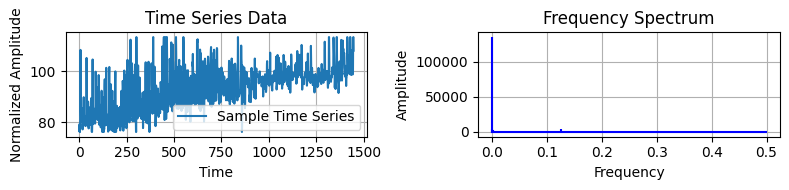

In [19]:
import numpy as np
import matplotlib.pyplot as plt
import os


sample_x = data_K3_3B1

# Perform FFT
fft_result = np.fft.fft(sample_x)
frequencies = np.fft.fftfreq(len(sample_x), 1)

# Set up directory for saving results
save_dir = 'FFT_analysis_results'
os.makedirs(save_dir, exist_ok=True)

# Plot time series and its frequency spectrum
plt.figure(figsize=(8, 2))
plt.subplot(1, 2, 1)
plt.plot(sample_x, label='Sample Time Series')
plt.title("Time Series Data")
plt.xlabel("Time")
plt.ylabel("Normalized Amplitude")
plt.grid(True)
plt.legend()

plt.subplot(1, 2, 2)
plt.stem(frequencies[:len(frequencies) // 2], np.abs(fft_result)[:len(frequencies) // 2], 'b', markerfmt=" ", basefmt="-b")
plt.title("Frequency Spectrum")
plt.xlabel("Frequency")
plt.ylabel("Amplitude")
plt.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'FFT_Time_Series_Analysis_for_data_K3_3B1_24.pdf'))
plt.show()


The frequency spectrum plot reveals a distinct peak at a frequency around 0.15, indicating a pronounced periodic or cyclic component at that frequency. This suggests the underlying time series data contains a periodic fluctuation or oscillation with a period corresponding to the inverse of this frequency, which would be approximately 6-7 time units.

In [20]:
# plot utils.
def plot_scatter(*args, **kwargs):
    plt.plot(*args, **kwargs)
    plt.scatter(*args, **kwargs)


# simple batcher.
def data_generator(x, y, size):
    assert len(x) == len(y)
    batches = []
    for ii in range(0, len(x), size):
        batches.append((x[ii:ii + size], y[ii:ii + size]))
    for batch in batches:
        yield batch

In [24]:

random_seed = 42
torch.manual_seed(random_seed)
np.random.seed(random_seed)
random.seed(random_seed)


torch.cuda.manual_seed(random_seed)
torch.cuda.manual_seed_all(random_seed)  # for multi-GPU setups
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138464618534208
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=False) at @138464618530944
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138464618544768
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=24, forecast_length=6, share_thetas=True) at @138464618534928
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138464618543808
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=24, forecast_length=6, share_thetas=True) at @138464618540064


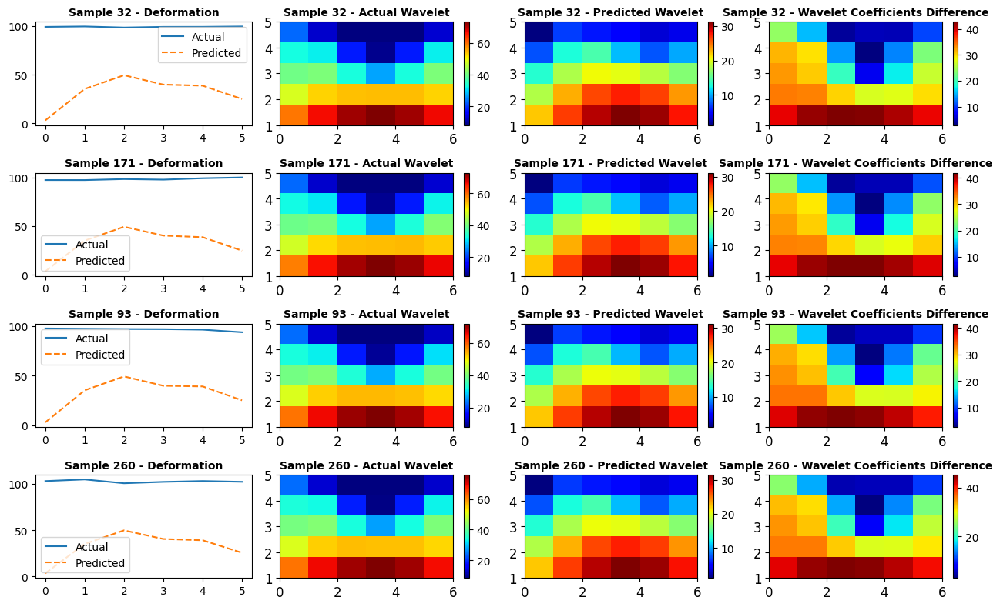

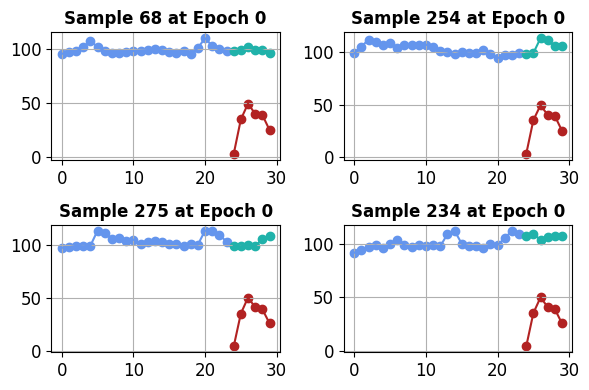

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.25994495, -0.27714753,  0.40031224, -0.03226478,  0.49386773,
        0.44261903, -0.38851187, -0.30233097, -0.08506538,  0.11430703,
       -0.08625022,  0.23408954,  0.02227138, -0.23947689, -0.48219606,
       -0.23875843,  0.08964419, -0.16733599,  0.19728242,  0.47241178,
       -0.38625968,  0.27902535, -0.2727512 ,  0.2509898 ], dtype=float32), 'forecast': array([-0.3845955 , -0.13566339, -0.2602022 ,  0.23609304, -0.10155185,
       -0.13931084], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.01906962,  0.10538797,  0.30518657, -0.16272871, -0.36749637,
        0.34966183, -0.30914074,  0.4440387 , -0.05778819, -0.01617702,
        0.26777396,  0.00706253, -0.3033179 ,  0.21936569, -0.2567824 ,
       -0.17544281,  0.41473565, -0.2285113 , -0.4138465 ,  0.2754358 ,
       -0.3820727 ,  0.09426179, -0.29358086, -0.37244055], dtype=float32), 'forecast': array([-0.02755022,  0.25855687,  0.2

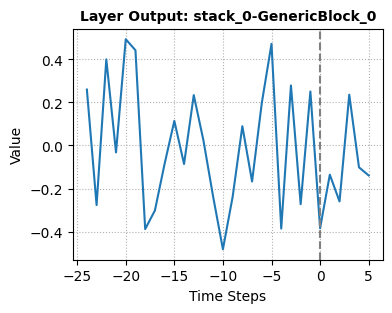

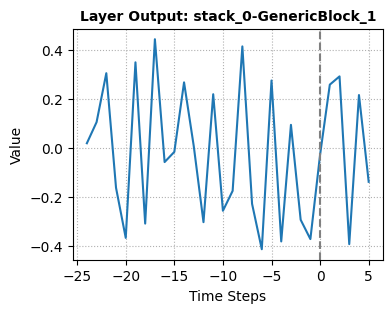

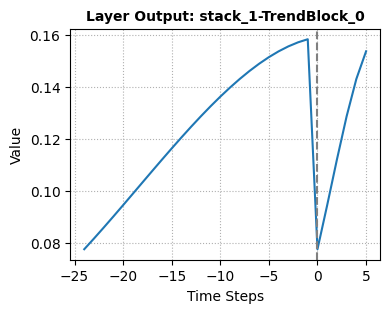

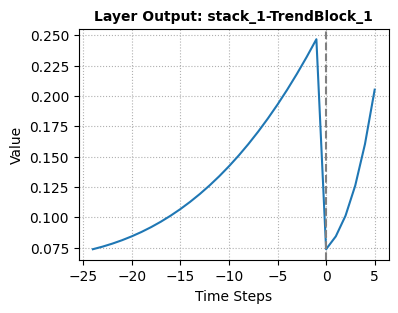

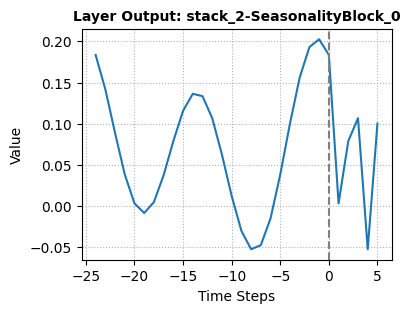

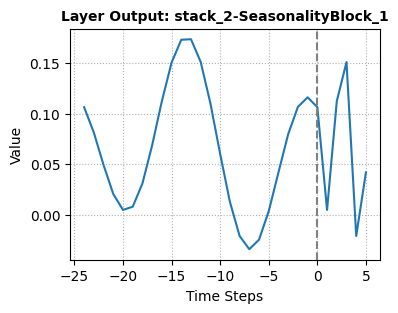

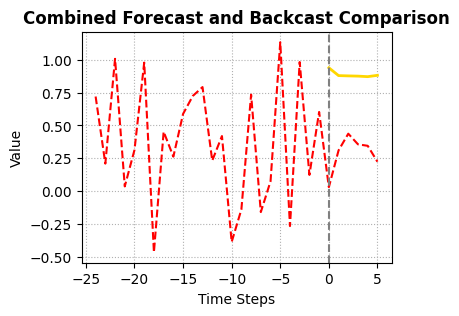

Epoch = 1, Train Loss = 0.4012, Test Loss = 0.3760
Epoch = 2, Train Loss = 0.2356, Test Loss = 0.2175
Epoch = 3, Train Loss = 0.1175, Test Loss = 0.1003
Epoch = 4, Train Loss = 0.0438, Test Loss = 0.0349
Epoch = 5, Train Loss = 0.0130, Test Loss = 0.0099
Epoch = 6, Train Loss = 0.0060, Test Loss = 0.0043
Epoch = 7, Train Loss = 0.0045, Test Loss = 0.0032
Epoch = 8, Train Loss = 0.0041, Test Loss = 0.0029
Epoch = 9, Train Loss = 0.0040, Test Loss = 0.0027
Epoch = 10, Train Loss = 0.0039, Test Loss = 0.0026
Epoch = 11, Train Loss = 0.0038, Test Loss = 0.0025
Epoch = 12, Train Loss = 0.0038, Test Loss = 0.0024
Epoch = 13, Train Loss = 0.0038, Test Loss = 0.0024
Epoch = 14, Train Loss = 0.0037, Test Loss = 0.0023
Epoch = 15, Train Loss = 0.0037, Test Loss = 0.0023
Epoch = 16, Train Loss = 0.0037, Test Loss = 0.0022
Epoch = 17, Train Loss = 0.0036, Test Loss = 0.0022
Epoch = 18, Train Loss = 0.0036, Test Loss = 0.0021
Epoch = 19, Train Loss = 0.0035, Test Loss = 0.0021
Epoch = 20, Train Los

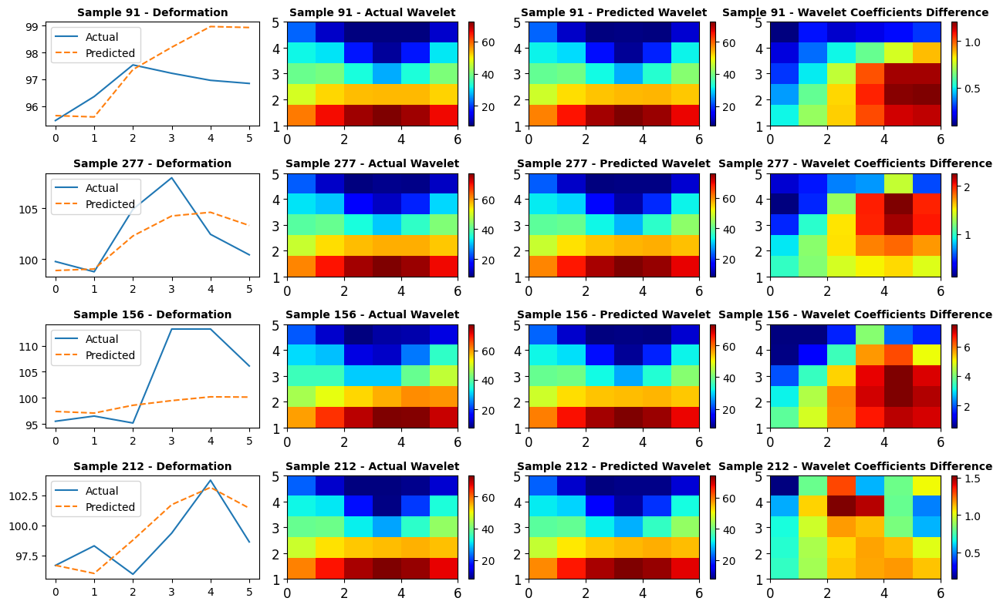

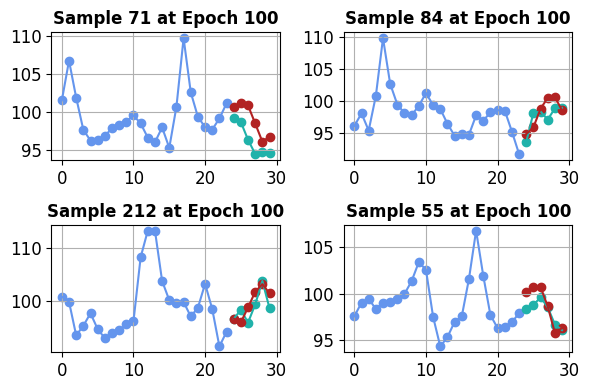

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.19747737, -0.23264852,  0.40149108,  0.02029895,  0.5009129 ,
        0.4399611 , -0.44510695, -0.3412711 , -0.14958142,  0.0646086 ,
       -0.14875883,  0.16923507, -0.05945252, -0.15978678, -0.5313998 ,
       -0.2601666 ,  0.03814333, -0.12038775,  0.18635888,  0.45145148,
       -0.45368898,  0.26213506, -0.3388944 ,  0.1566342 ], dtype=float32), 'forecast': array([-0.29321572, -0.09054497, -0.22166204,  0.27069503, -0.02754152,
       -0.18645707], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.04291608,  0.17628665,  0.3058606 , -0.13832287, -0.30334496,
        0.33253503, -0.3955702 ,  0.4011787 , -0.08106519,  0.01771898,
        0.2933751 ,  0.02078663, -0.29932615,  0.25813833, -0.255699  ,
       -0.2598678 ,  0.41138953, -0.17443427, -0.40738827,  0.14491348,
       -0.34730953,  0.07980395, -0.36498845, -0.41382727], dtype=float32), 'forecast': array([ 0.02145044,  0.27907288,  0.3

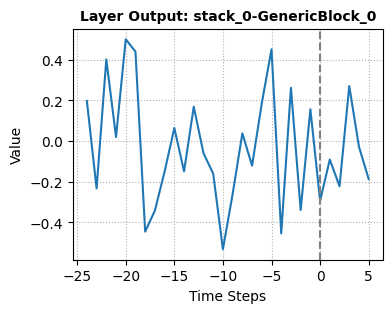

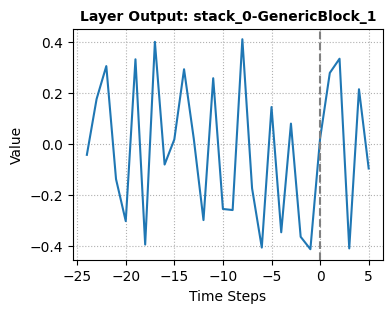

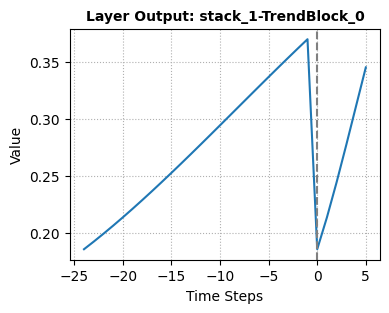

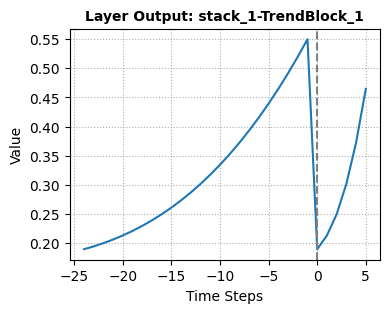

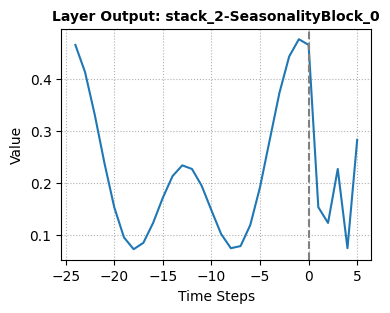

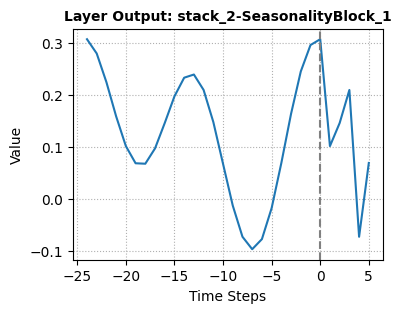

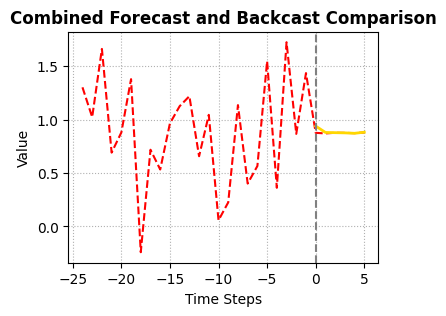

Epoch = 101, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 102, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 103, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 104, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 105, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 106, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 107, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 108, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 109, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 110, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 111, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 112, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 113, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 114, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 115, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 116, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 117, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 118, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 119, Train Loss = 0.0017, Test Loss = 

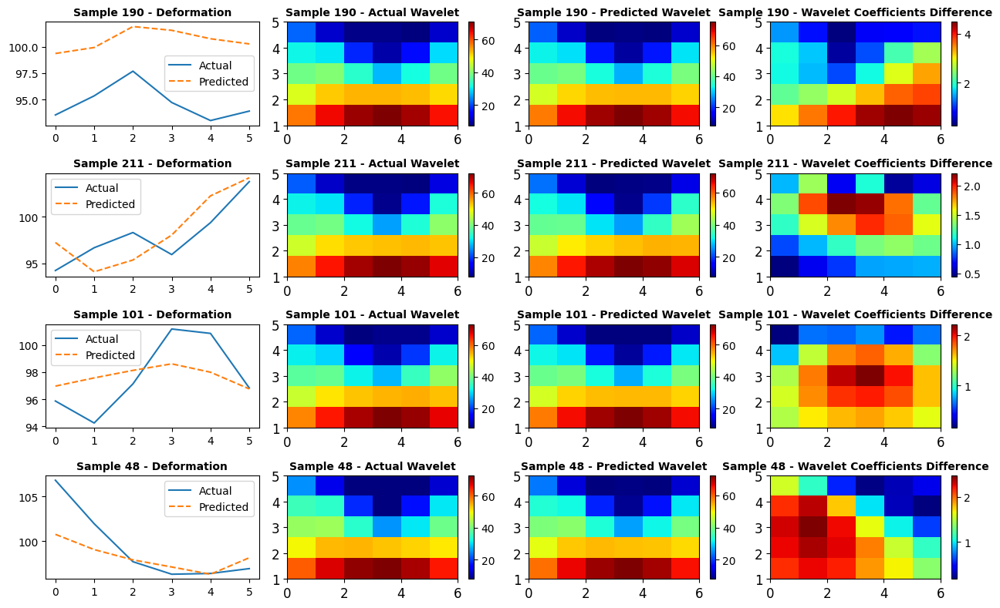

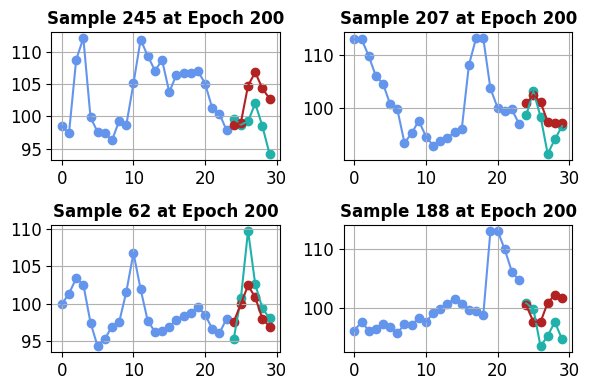

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.20085263, -0.22031385,  0.39108807,  0.02646771,  0.5008765 ,
        0.4351709 , -0.4568766 , -0.32766506, -0.15595585,  0.07418995,
       -0.1510159 ,  0.18245722, -0.0677928 , -0.15721151, -0.5226292 ,
       -0.2441676 ,  0.02162791, -0.10643021,  0.1902918 ,  0.4405726 ,
       -0.44599333,  0.25277978, -0.3205607 ,  0.14733292], dtype=float32), 'forecast': array([-0.28931168, -0.08840424, -0.22218929,  0.26880044, -0.02628366,
       -0.18785569], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.04461917,  0.16378342,  0.30866233, -0.14098242, -0.29854232,
        0.32360125, -0.38604066,  0.39273125, -0.08220394,  0.0269875 ,
        0.27724847,  0.01323864, -0.27975193,  0.25539497, -0.25116044,
       -0.26353127,  0.4180471 , -0.17268479, -0.4141046 ,  0.14887741,
       -0.34428456,  0.07278757, -0.35228887, -0.43369937], dtype=float32), 'forecast': array([ 0.02747626,  0.27654526,  0.3

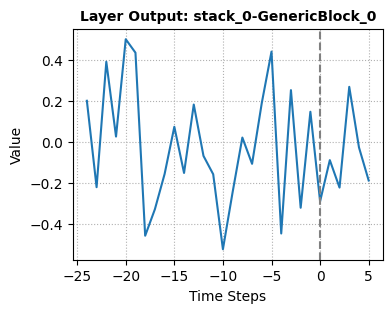

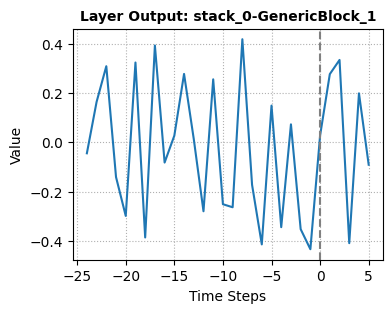

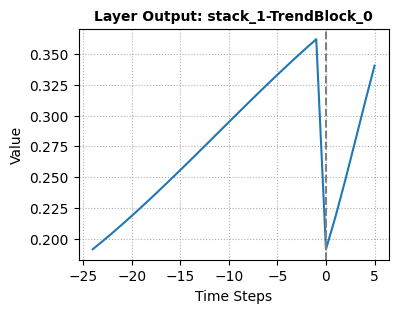

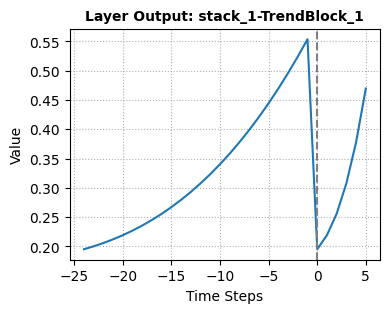

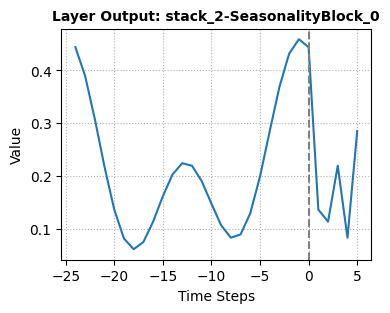

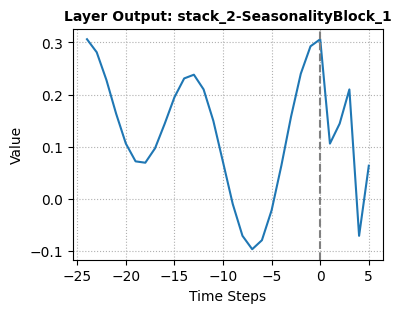

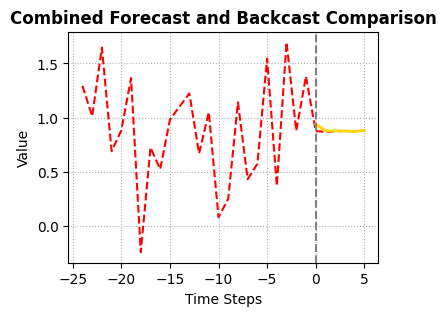

Epoch = 201, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 202, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 203, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 204, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 205, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 206, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 207, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 208, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 209, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 210, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 211, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 212, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 213, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 214, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 215, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 216, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 217, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 218, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 219, Train Loss = 0.0016, Test Loss = 

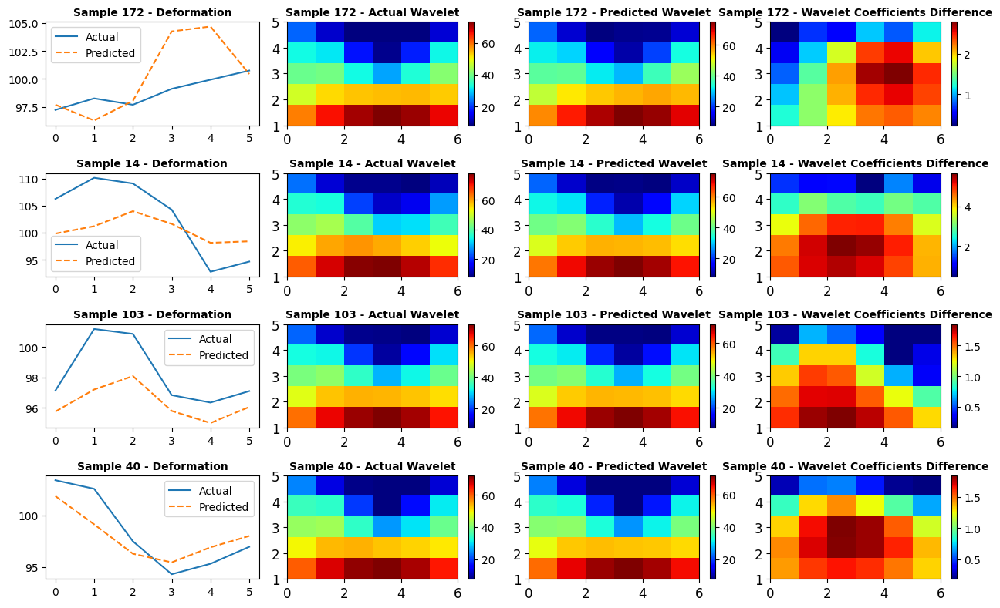

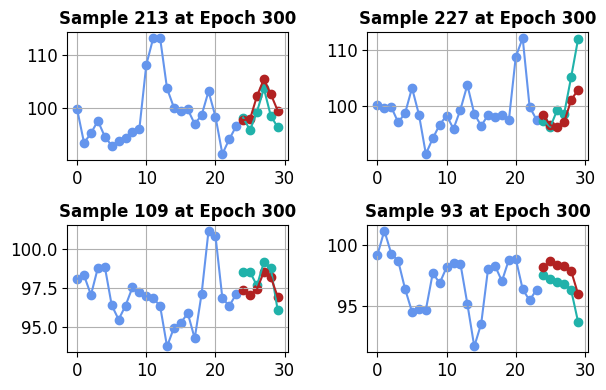

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.197798  , -0.21445344,  0.3845268 ,  0.03127402,  0.49976343,
        0.42919084, -0.46179292, -0.32042697, -0.1644215 ,  0.0766993 ,
       -0.15395798,  0.18740888, -0.07386487, -0.15798803, -0.51858914,
       -0.23444015,  0.00760414, -0.0985778 ,  0.19256784,  0.4332978 ,
       -0.44317427,  0.24806397, -0.308387  ,  0.13788688], dtype=float32), 'forecast': array([-0.2850007 , -0.08836935, -0.22002736,  0.2695372 , -0.0261979 ,
       -0.1861083 ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.04445449,  0.15266296,  0.3080462 , -0.14747272, -0.30053657,
        0.3173126 , -0.37538975,  0.3919099 , -0.08776392,  0.02943899,
        0.2680148 ,  0.01110962, -0.27104416,  0.24948378, -0.25195888,
       -0.26291826,  0.4186163 , -0.17580292, -0.41616672,  0.15440573,
       -0.34168285,  0.06894585, -0.3416678 , -0.44530293], dtype=float32), 'forecast': array([ 0.029179  ,  0.27812198,  0.3

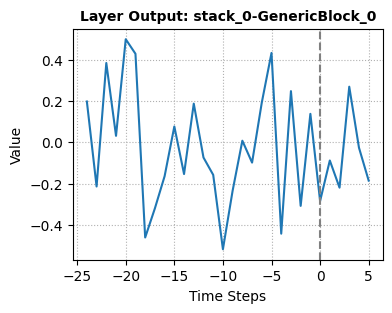

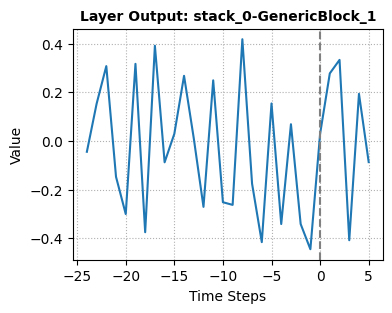

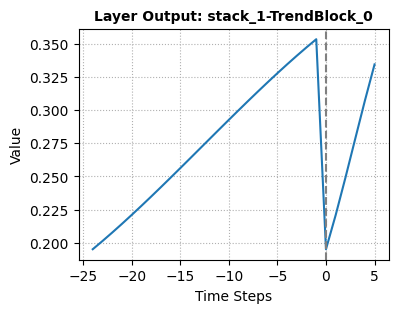

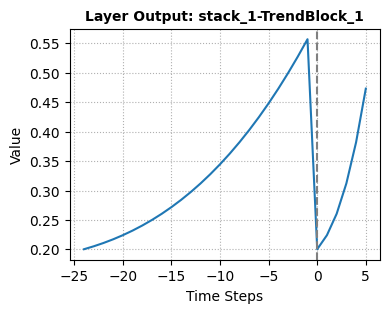

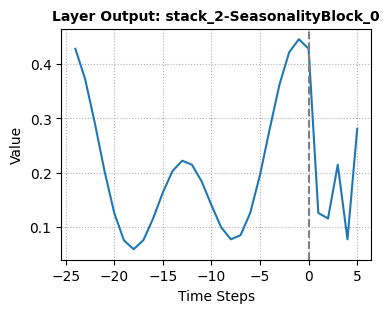

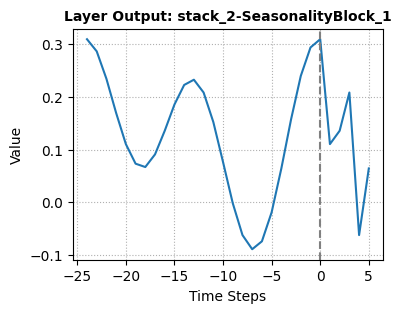

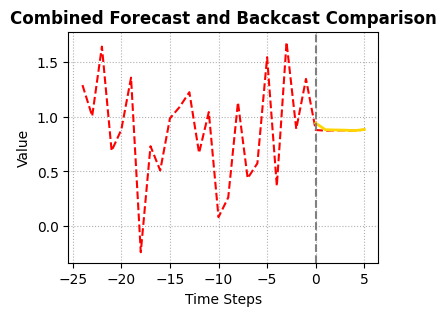

Epoch = 301, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 302, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 303, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 304, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 305, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 306, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 307, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 308, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 309, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 310, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 311, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 312, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 313, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 314, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 315, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 316, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 317, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 318, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 319, Train Loss = 0.0015, Test Loss = 

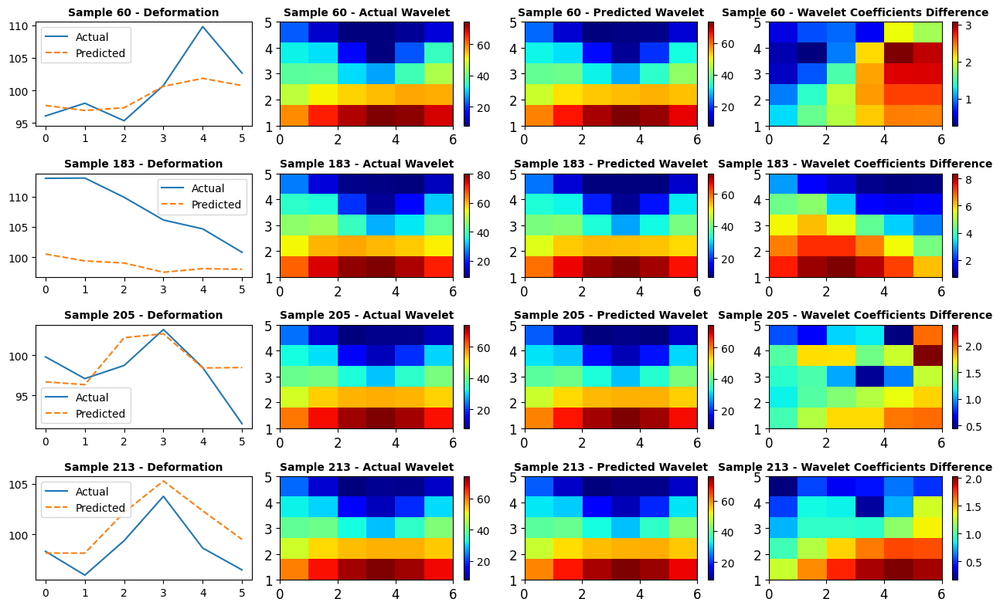

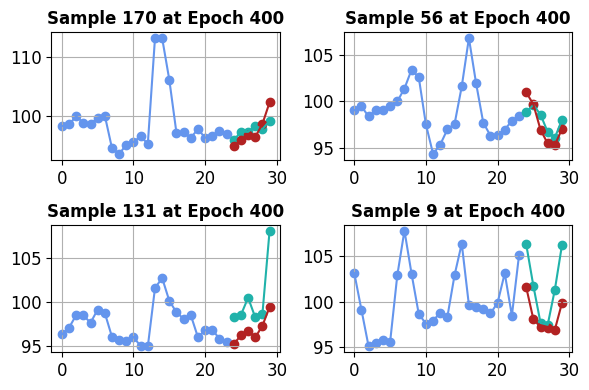

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.19544657, -0.21133415,  0.3785827 ,  0.03522729,  0.49901086,
        0.42448485, -0.46510577, -0.3123088 , -0.16937494,  0.07880275,
       -0.15576427,  0.19130242, -0.07771765, -0.15928036, -0.5136673 ,
       -0.22700249, -0.00194682, -0.09244902,  0.19353613,  0.42801544,
       -0.44075093,  0.2447199 , -0.29629904,  0.13144705], dtype=float32), 'forecast': array([-0.28143096, -0.08879161, -0.21837188,  0.2721872 , -0.02685096,
       -0.18473454], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.04642292,  0.1418052 ,  0.30859923, -0.14936452, -0.30119884,
        0.31434256, -0.36459962,  0.39245248, -0.0895942 ,  0.03202358,
        0.25969142,  0.00680377, -0.26207188,  0.24553981, -0.2494973 ,
       -0.2606592 ,  0.4172748 , -0.1789646 , -0.41818568,  0.16033825,
       -0.34164646,  0.06592658, -0.33035824, -0.456827  ], dtype=float32), 'forecast': array([ 0.03373073,  0.2781504 ,  0.3

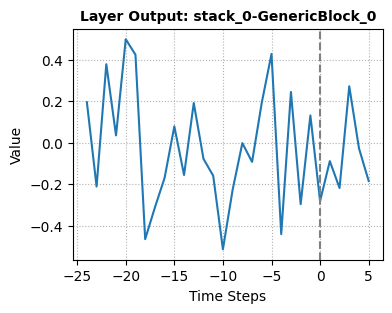

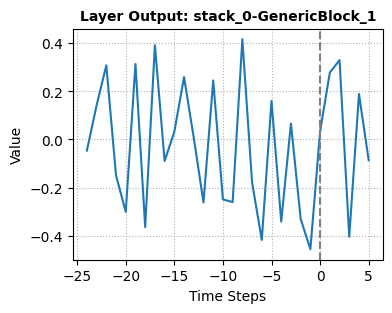

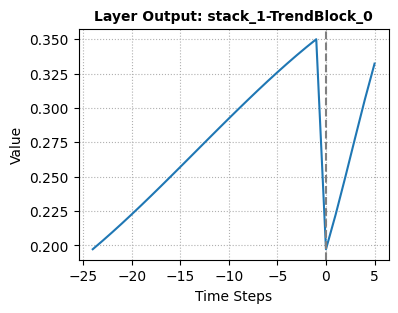

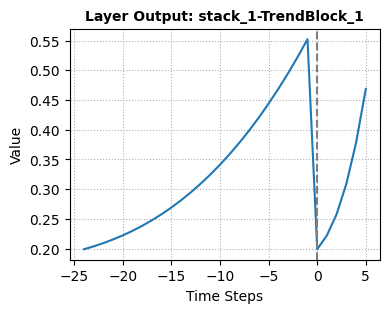

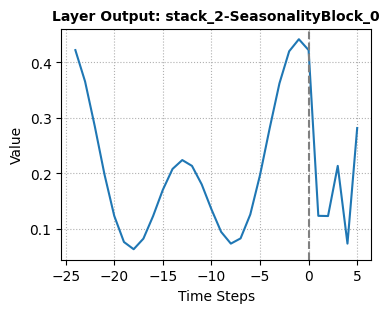

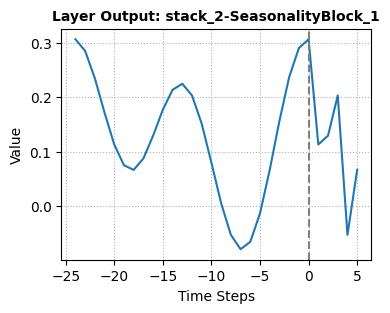

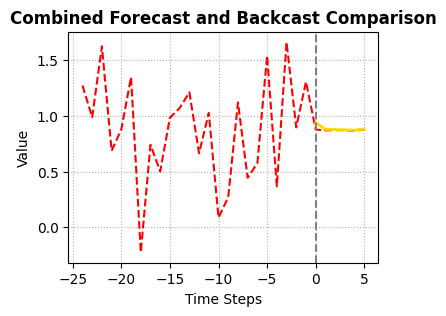

Epoch = 401, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 402, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 403, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 404, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 405, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 406, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 407, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 408, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 409, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 410, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 411, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 412, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 413, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 414, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 415, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 416, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 417, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 418, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 419, Train Loss = 0.0014, Test Loss = 

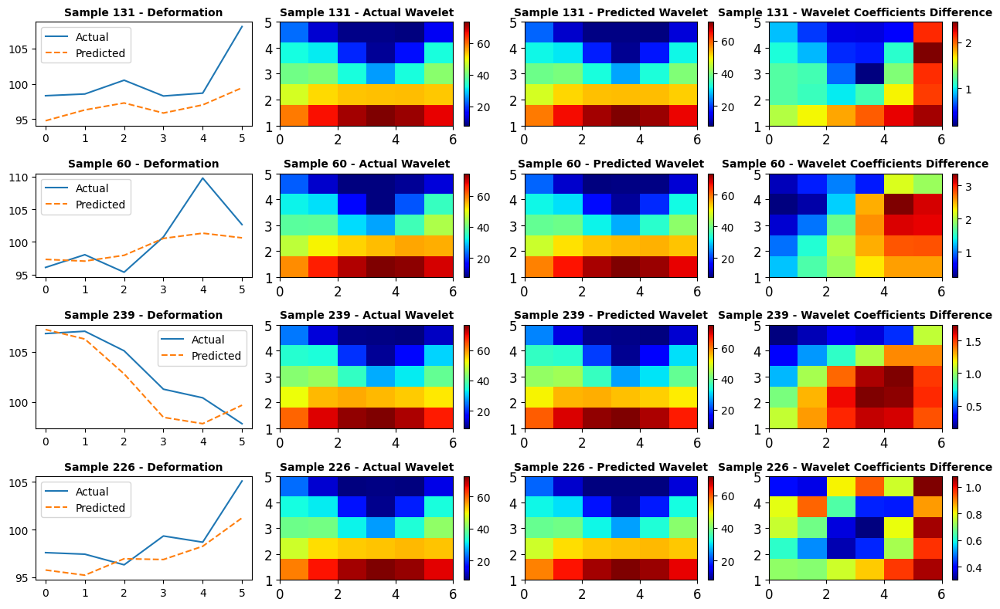

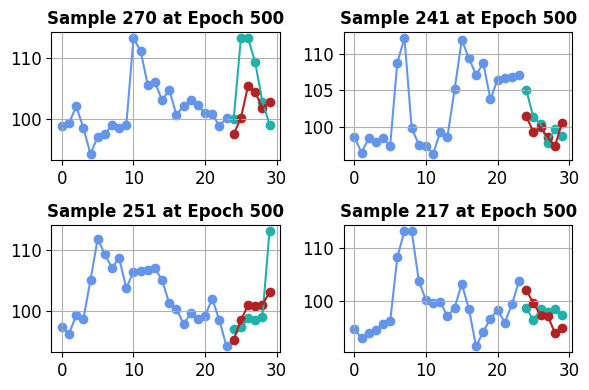

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.19354004, -0.20793787,  0.37141737,  0.04006584,  0.49783546,
        0.41709068, -0.46797577, -0.3019222 , -0.1678899 ,  0.08484947,
       -0.1554356 ,  0.19861294, -0.07996803, -0.164038  , -0.50808084,
       -0.2179913 , -0.00912325, -0.08747626,  0.19575562,  0.4226048 ,
       -0.43478552,  0.24097617, -0.2795155 ,  0.13019632], dtype=float32), 'forecast': array([-0.27965474, -0.09087141, -0.2172367 ,  0.2725165 , -0.02887607,
       -0.18180157], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.05273228,  0.1354082 ,  0.3094098 , -0.14639921, -0.29984766,
        0.31027198, -0.35756835,  0.3917147 , -0.08725499,  0.03451649,
        0.25303993,  0.00174577, -0.25423604,  0.24277319, -0.24602297,
       -0.25883812,  0.41679147, -0.17989789, -0.42114928,  0.16174208,
       -0.34105352,  0.06333824, -0.31970438, -0.4664403 ], dtype=float32), 'forecast': array([ 0.03739011,  0.27792153,  0.3

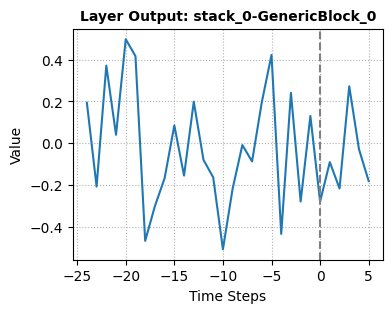

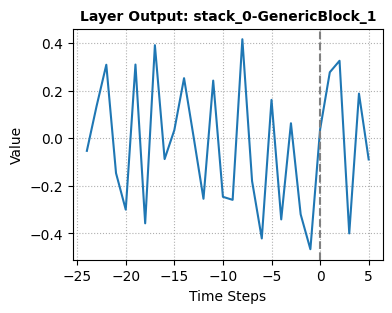

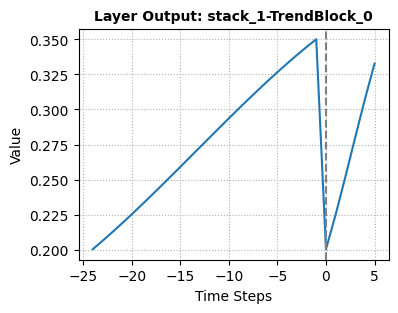

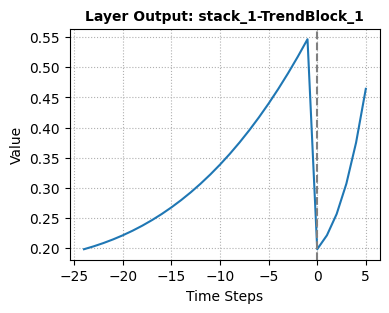

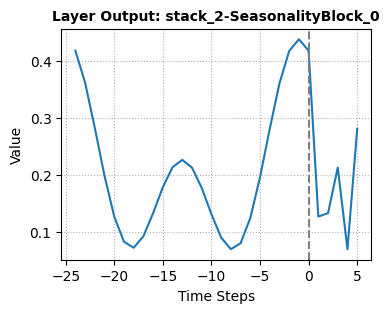

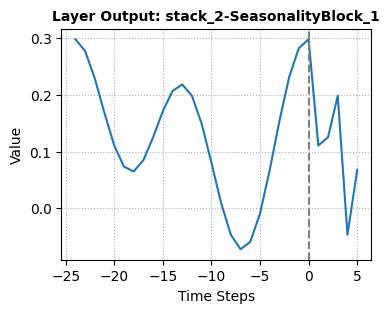

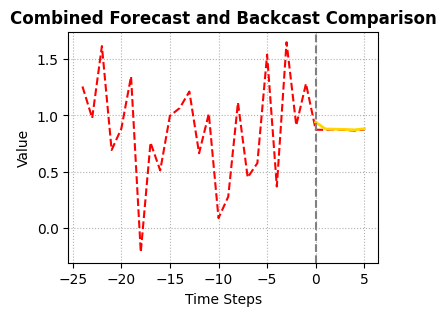

Epoch = 501, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 502, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 503, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 504, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 505, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 506, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 507, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 508, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 509, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 510, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 511, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 512, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 513, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 514, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 515, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 516, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 517, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 518, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 519, Train Loss = 0.0014, Test Loss = 

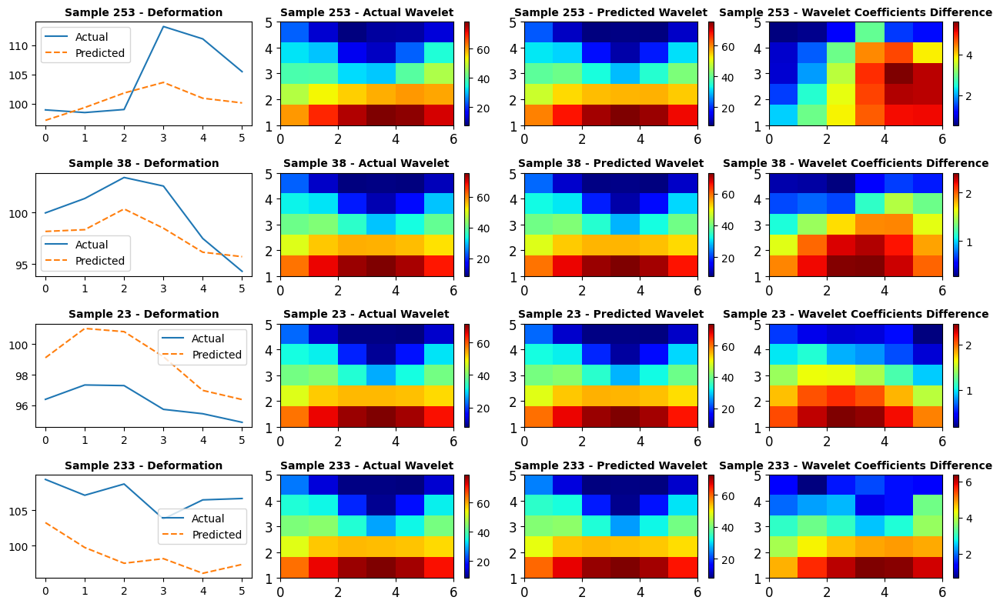

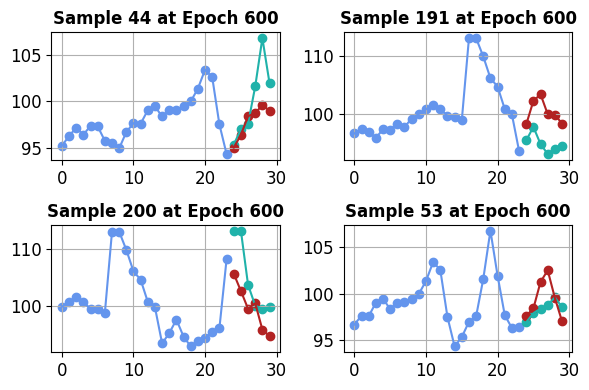

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.19450971, -0.20789143,  0.36621332,  0.04042075,  0.49851403,
        0.41108805, -0.46629736, -0.29326808, -0.16284181,  0.08969487,
       -0.15391606,  0.2043001 , -0.07677327, -0.17133242, -0.50242895,
       -0.20989409, -0.01133135, -0.08720442,  0.19542032,  0.41771027,
       -0.42882174,  0.24003789, -0.26282722,  0.13410081], dtype=float32), 'forecast': array([-0.27879754, -0.09352778, -0.21722895,  0.27024353, -0.03193099,
       -0.17942992], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.05795407,  0.13045107,  0.31149888, -0.14163372, -0.2987724 ,
        0.3084423 , -0.34957626,  0.3901865 , -0.08196773,  0.03472753,
        0.24613665, -0.00566043, -0.248427  ,  0.24053738, -0.24023293,
       -0.25378254,  0.4161741 , -0.18225309, -0.42578012,  0.16560973,
       -0.34287965,  0.06213485, -0.30805105, -0.47183287], dtype=float32), 'forecast': array([ 0.03915817,  0.27823305,  0.3

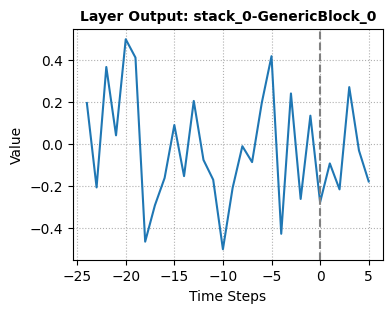

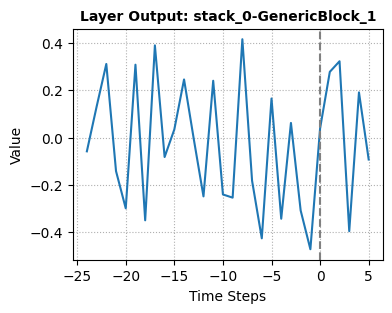

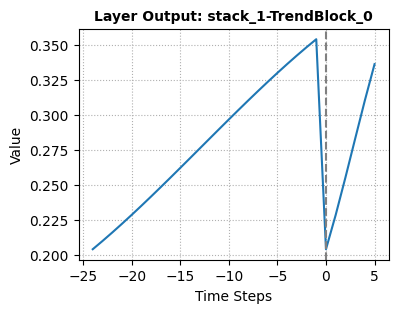

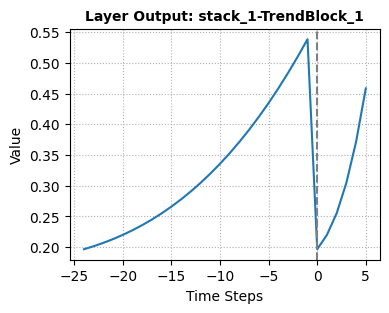

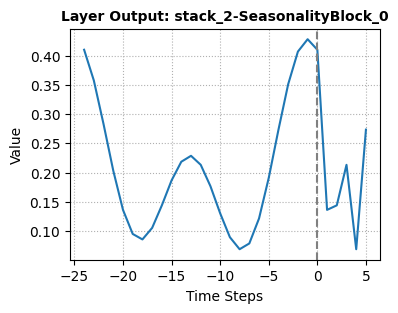

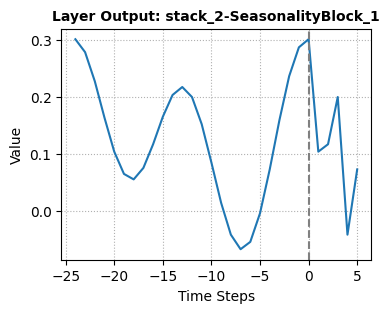

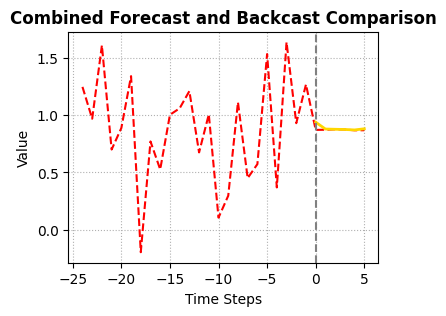

Epoch = 601, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 602, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 603, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 604, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 605, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 606, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 607, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 608, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 609, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 610, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 611, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 612, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 613, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 614, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 615, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 616, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 617, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 618, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 619, Train Loss = 0.0014, Test Loss = 

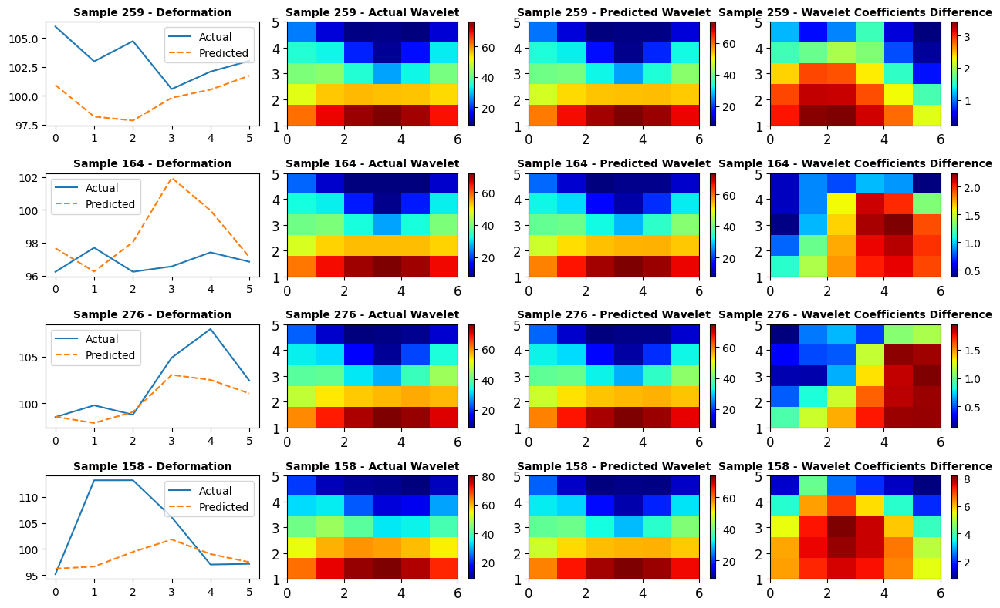

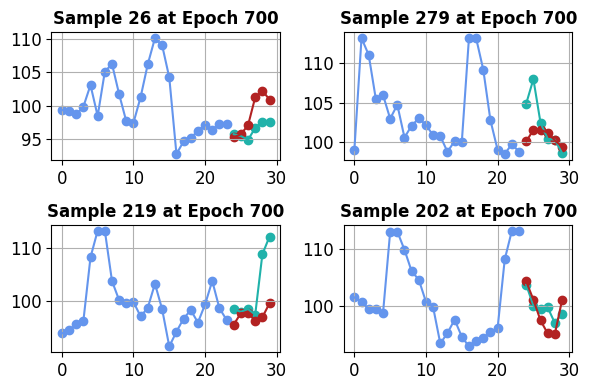

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.20036764, -0.20833531,  0.36152723,  0.0387366 ,  0.49931598,
        0.40720102, -0.46344483, -0.28752032, -0.155966  ,  0.09424738,
       -0.15233485,  0.20857708, -0.0727274 , -0.17703193, -0.49705425,
       -0.20483795, -0.01143203, -0.08799402,  0.19527674,  0.41427782,
       -0.4232235 ,  0.24027988, -0.24950758,  0.1392686 ], dtype=float32), 'forecast': array([-0.28080043, -0.09529446, -0.21803324,  0.2670173 , -0.03520973,
       -0.17747878], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.06166706,  0.12792408,  0.31265873, -0.13541733, -0.29540268,
        0.30912894, -0.34293684,  0.38631722, -0.07552773,  0.03624155,
        0.24215256, -0.01316892, -0.24249837,  0.24098185, -0.2343834 ,
       -0.2510675 ,  0.4134684 , -0.18284903, -0.42755494,  0.16688202,
       -0.34564027,  0.06076229, -0.29980922, -0.47703692], dtype=float32), 'forecast': array([ 0.04188662,  0.2775016 ,  0.3

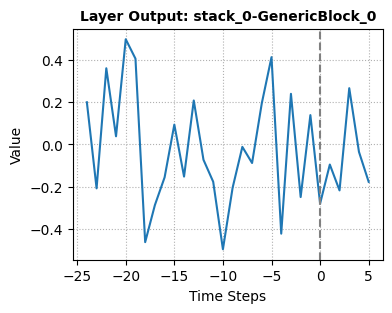

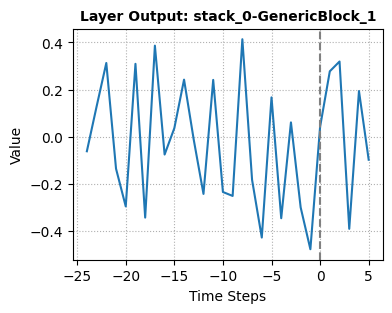

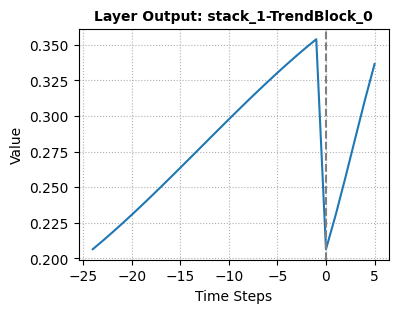

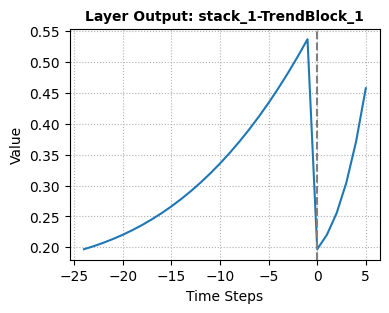

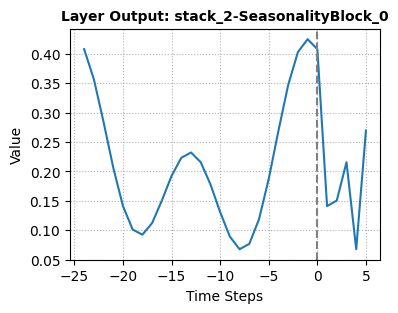

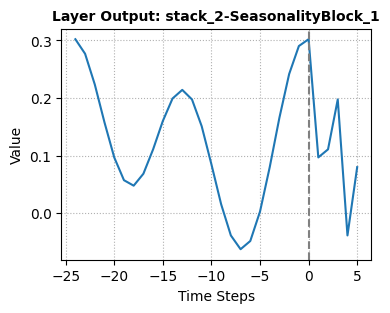

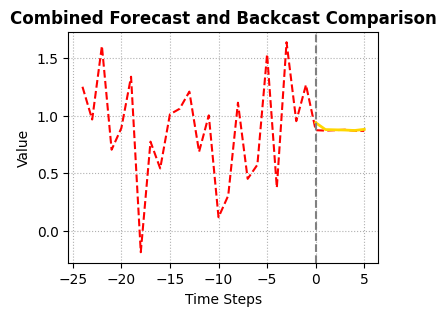

Epoch = 701, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 702, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 703, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 704, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 705, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 706, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 707, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 708, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 709, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 710, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 711, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 712, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 713, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 714, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 715, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 716, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 717, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 718, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 719, Train Loss = 0.0014, Test Loss = 

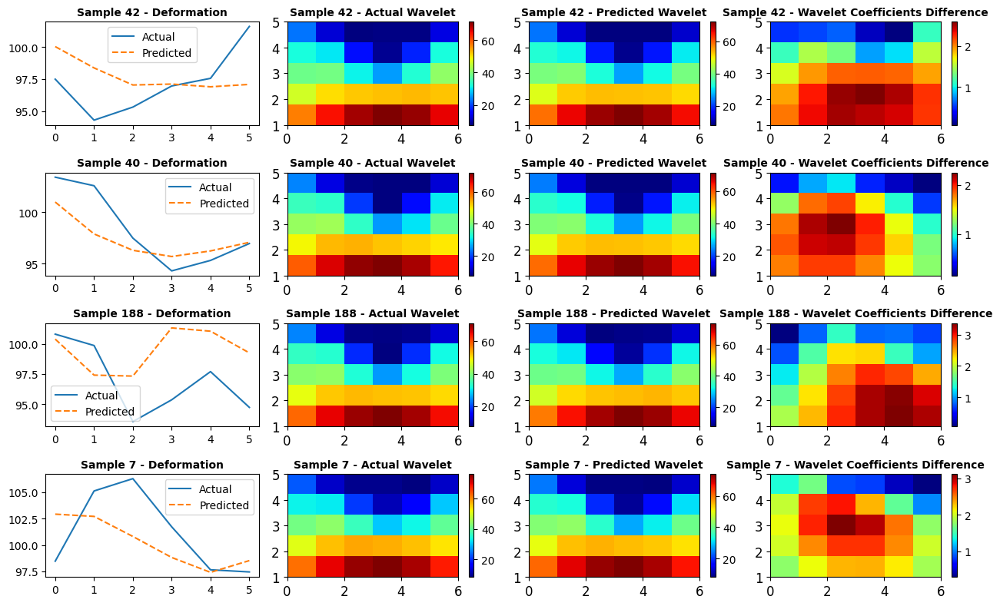

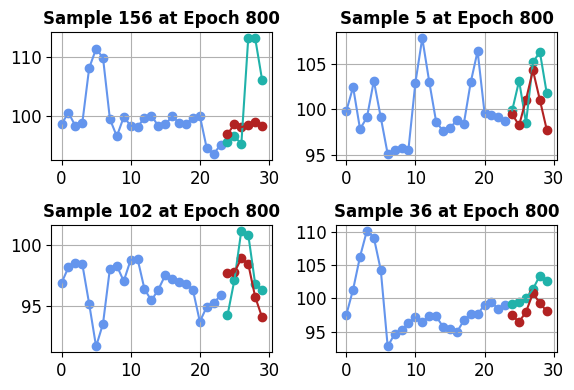

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.20847562, -0.20655881,  0.3578565 ,  0.03814927,  0.49948326,
        0.40538642, -0.46106106, -0.28210124, -0.14542705,  0.10148605,
       -0.14893386,  0.21519227, -0.06966991, -0.18167816, -0.48959008,
       -0.19971758, -0.0122472 , -0.08972147,  0.19879797,  0.41322598,
       -0.41474462,  0.23981646, -0.23903766,  0.14662853], dtype=float32), 'forecast': array([-0.27908796, -0.09815487, -0.21837327,  0.2685559 , -0.03819361,
       -0.17775916], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.06315019,  0.1262722 ,  0.31331354, -0.13158295, -0.29306915,
        0.30789083, -0.3378313 ,  0.38380226, -0.0705758 ,  0.03735576,
        0.23888013, -0.01834816, -0.23805006,  0.24098323, -0.2299985 ,
       -0.2486777 ,  0.4115395 , -0.18293682, -0.4286358 ,  0.16769783,
       -0.3468325 ,  0.05924946, -0.29379988, -0.48105767], dtype=float32), 'forecast': array([ 0.04371791,  0.27738133,  0.3

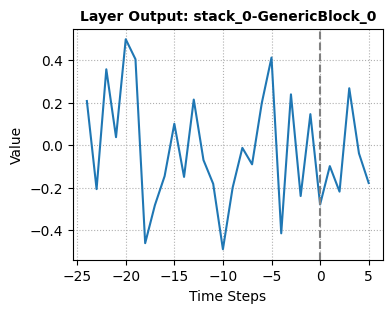

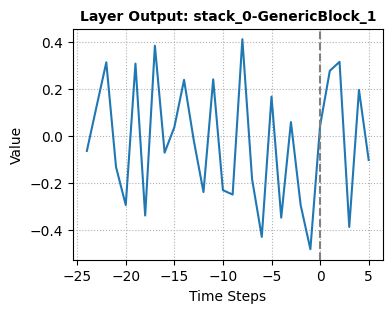

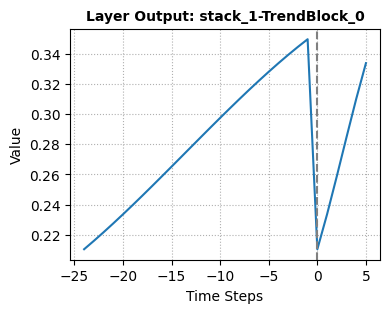

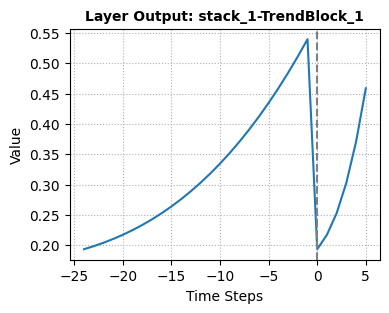

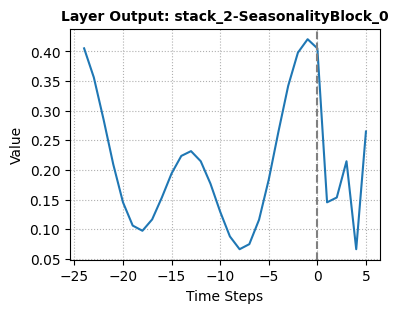

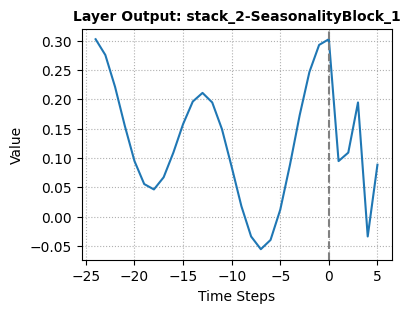

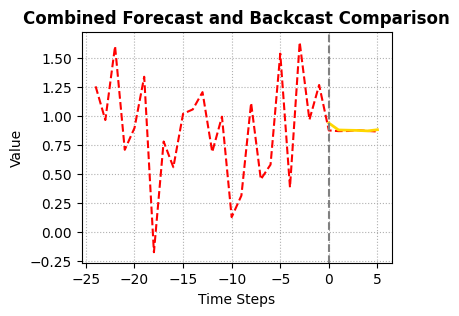

Epoch = 801, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 802, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 803, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 804, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 805, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 806, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 807, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 808, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 809, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 810, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 811, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 812, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 813, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 814, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 815, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 816, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 817, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 818, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 819, Train Loss = 0.0014, Test Loss = 

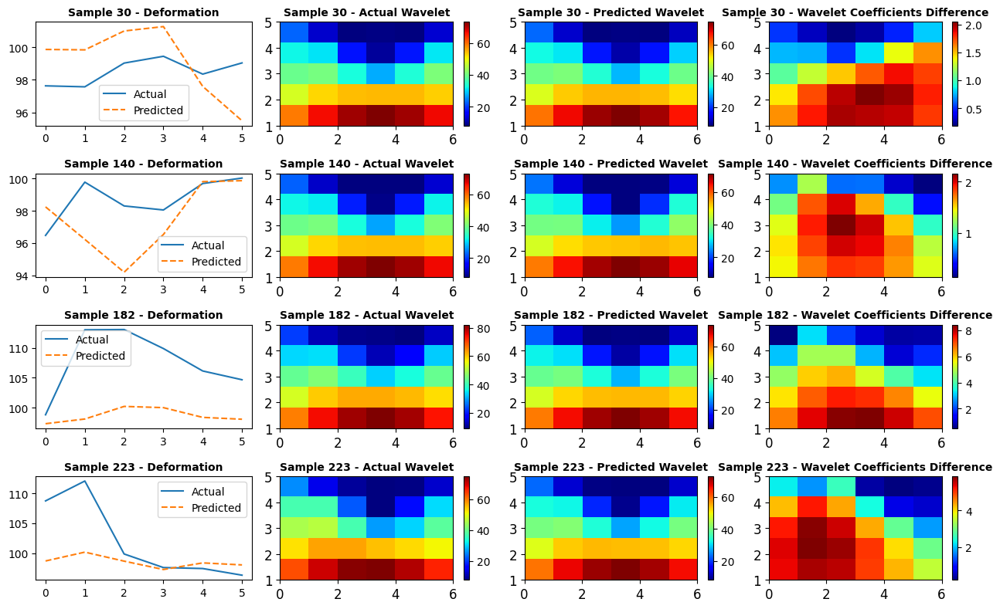

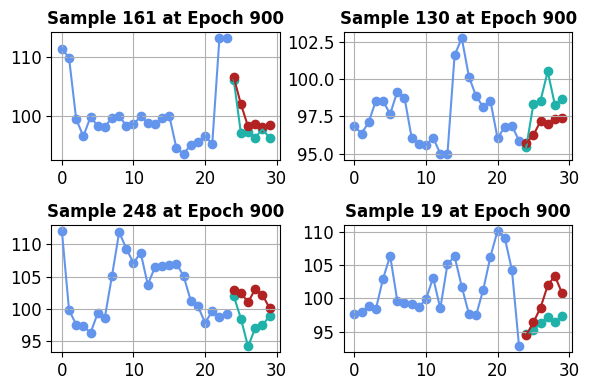

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.21521503, -0.20433415,  0.35384443,  0.0386392 ,  0.49981496,
        0.40322345, -0.4598594 , -0.2772725 , -0.13636024,  0.10802016,
       -0.14672129,  0.2211572 , -0.06789953, -0.18457766, -0.48455772,
       -0.19483401, -0.01461034, -0.08992112,  0.20228343,  0.41200134,
       -0.40717253,  0.23954284, -0.23000881,  0.15221924], dtype=float32), 'forecast': array([-0.27801073, -0.09926644, -0.21844515,  0.27000794, -0.03980244,
       -0.17830068], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([-0.06473488,  0.12401517,  0.31417018, -0.12739858, -0.28964084,
        0.30425367, -0.33381426,  0.38049164, -0.06630432,  0.03957733,
        0.23496507, -0.02264802, -0.23200817,  0.24123509, -0.22703367,
       -0.24752724,  0.41031837, -0.18243797, -0.43034887,  0.16805013,
       -0.34615692,  0.05757304, -0.28803366, -0.48645413], dtype=float32), 'forecast': array([ 0.04514976,  0.27766812,  0.3

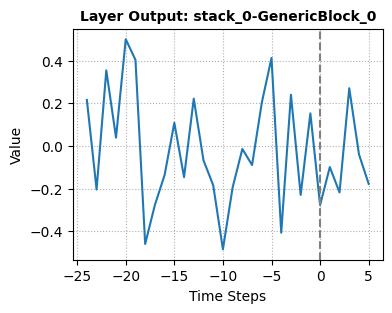

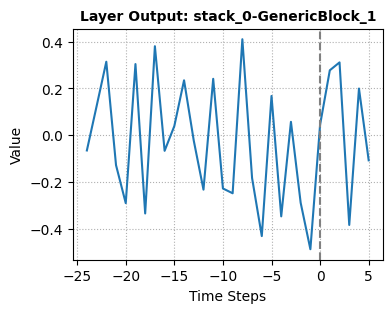

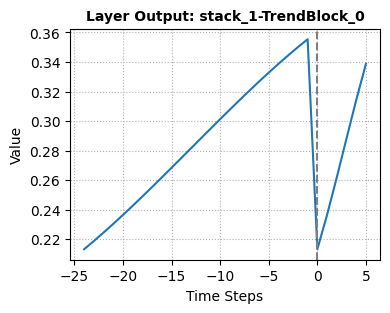

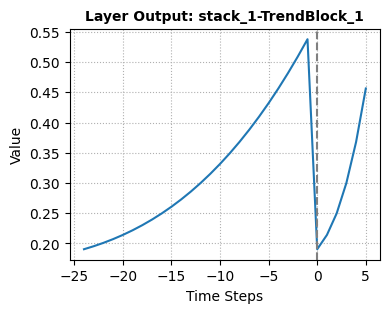

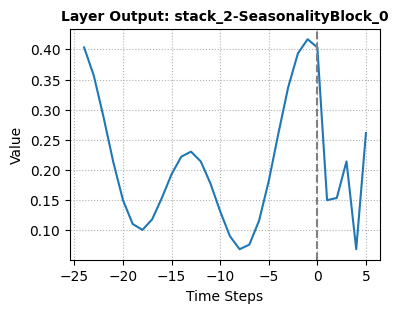

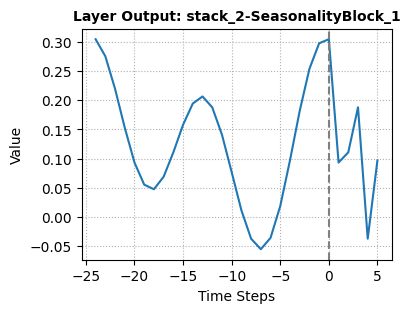

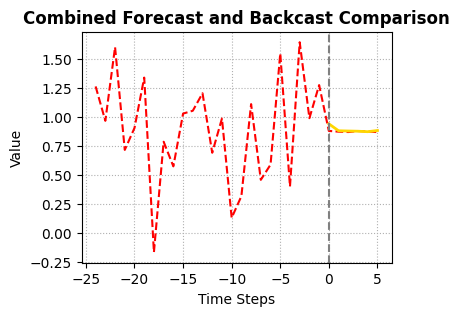

Epoch = 901, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 902, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 903, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 904, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 905, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 906, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 907, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 908, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 909, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 910, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 911, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 912, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 913, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 914, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 915, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 916, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 917, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 918, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 919, Train Loss = 0.0013, Test Loss = 

In [42]:
save_dir = 'plots_K3_3B1_24'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

In [43]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from math import sqrt


net.eval()
with torch.no_grad():

    _,predicted_test = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    predicted_test = predicted_test.detach().cpu().numpy() * norm_constant
    y_test_actual = y_test * norm_constant
    # RMSE和MAE
    rmse = sqrt(mean_squared_error(y_test_actual, predicted_test))
    mae = mean_absolute_error(y_test_actual, predicted_test)

print(f"Test RMSE: {rmse}")
print(f"Test MAE: {mae}")

Test RMSE: 4.270563774271409
Test MAE: 3.0360472384482056


From the results, it is evident that in this 3-hour interval deformation observations dataset with pronounced periodicity, our STEN has effectively captured the cyclical structures according to the wavelet analysis features. Furthermore, there is a high degree of consistency between the predictions and the observed values. Additionally, the neural network extracts a set of features that successfully identifies five cycles. These align with the outcomes captured by both the original network and another interpretable model, the Temporal Fusion Transformer (TFT).


# Neural Network-Based Feature Extraction for Deformation Observations in the K3_3B1 (Input length: 36)

In [29]:
import pandas as pd
import numpy as np


# Load the data
file_path = '/content/df_3h_spatialandprec_features.csv'
data = pd.read_csv(file_path,index_col=[0],parse_dates=True)

In [34]:
data_K3_3B1 = data[data.Station_id=='K3_3B1'][['Vertical displacement(mm)']]
data_K3_3B1

,Vertical displacement(mm)
date,
2022-02-02 00:00:00,78.735333
2022-02-02 03:00:00,76.416000
2022-02-02 06:00:00,79.454222
2022-02-02 09:00:00,76.285593
2022-02-02 12:00:00,79.687600
...,...
2022-08-01 09:00:00,99.295571
2022-08-01 12:00:00,99.256889
2022-08-01 15:00:00,112.854000


In [35]:
forecast_length = 6
backcast_length = 6 * forecast_length
batch_size = 32  # greater than 4 for viz

data_K3_3B1 = data_K3_3B1.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_K3_3B1) - forecast_length):
    x.append(data_K3_3B1[epoch - backcast_length:epoch])
    y.append(data_K3_3B1[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

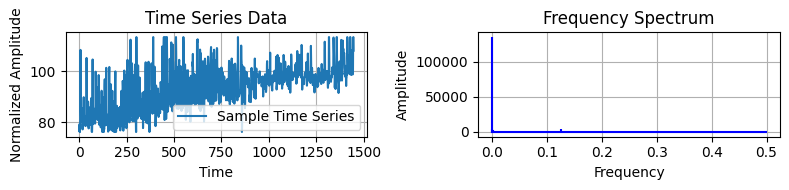

In [36]:
sample_x = data_K3_3B1

# Perform FFT
fft_result = np.fft.fft(sample_x)
frequencies = np.fft.fftfreq(len(sample_x), 1)

# Set up directory for saving results
save_dir = 'FFT_analysis_results'
os.makedirs(save_dir, exist_ok=True)

# Plot time series and its frequency spectrum
plt.figure(figsize=(8, 2))
plt.subplot(1, 2, 1)
plt.plot(sample_x, label='Sample Time Series')
plt.title("Time Series Data")
plt.xlabel("Time")
plt.ylabel("Normalized Amplitude")
plt.grid(True)
plt.legend()

plt.subplot(1, 2, 2)
plt.stem(frequencies[:len(frequencies) // 2], np.abs(fft_result)[:len(frequencies) // 2], 'b', markerfmt=" ", basefmt="-b")
plt.title("Frequency Spectrum")
plt.xlabel("Frequency")
plt.ylabel("Amplitude")
plt.grid(True)

plt.tight_layout()
plt.savefig(os.path.join(save_dir, 'FFT_Time_Series_Analysis_for_data_K3_3B1_36.pdf'))
plt.show()


| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=36, forecast_length=6, share_thetas=False) at @138464624715104
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=36, forecast_length=6, share_thetas=False) at @138464624719328
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=36, forecast_length=6, share_thetas=True) at @138464624720432
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=36, forecast_length=6, share_thetas=True) at @138464624720240
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=36, forecast_length=6, share_thetas=True) at @138464624721008
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=36, forecast_length=6, share_thetas=True) at @138464624720768


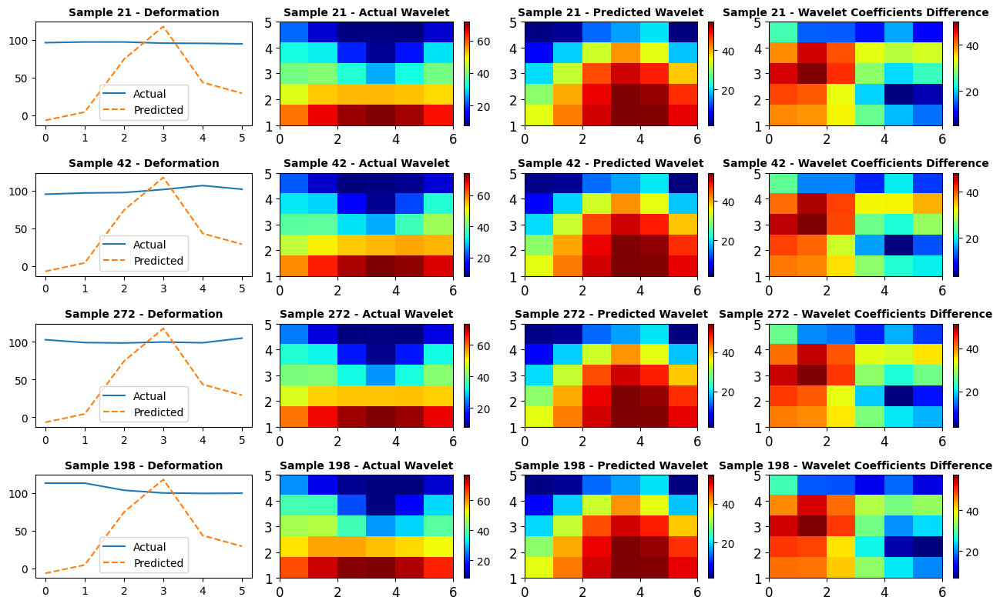

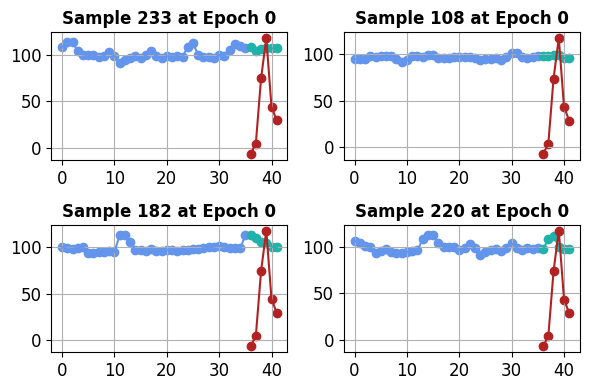

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.30956548, -0.07770722,  0.18192565,  0.20493616, -0.47321805,
        0.23731034,  0.16145448, -0.12987444, -0.102787  , -0.2417059 ,
        0.53009844, -0.29897243,  0.33464083, -0.58651644, -0.05221067,
       -0.25575903,  0.48101828, -0.115039  ,  0.44369972,  0.34465054,
       -0.403045  , -0.229305  , -0.13230297, -0.2596672 ,  0.00805148,
       -0.31985867, -0.0953531 , -0.34333816, -0.02897798, -0.26880345,
       -0.13837753,  0.5248882 ,  0.11890818,  0.33146843, -0.00101511,
       -0.29404196], dtype=float32), 'forecast': array([-0.20811343,  0.16706169,  0.31272906,  0.36568254, -0.12064796,
        0.36215255], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.29879248,  0.07393166,  0.29074967,  0.18172547, -0.27479333,
        0.51290774,  0.41493034,  0.22521423, -0.26155007, -0.16763751,
       -0.11836773, -0.08945273, -0.04288686,  0.20043692, -0.03713198,
       -0.34913853, 

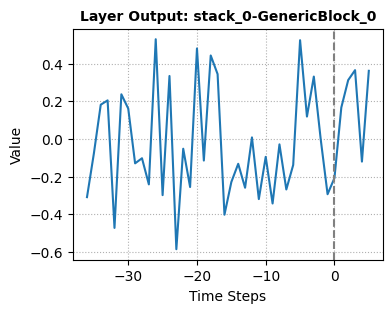

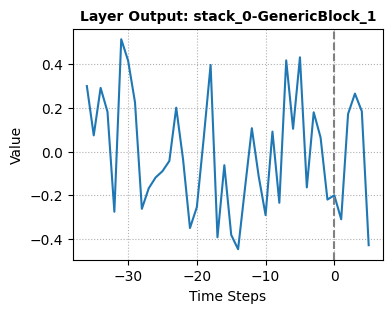

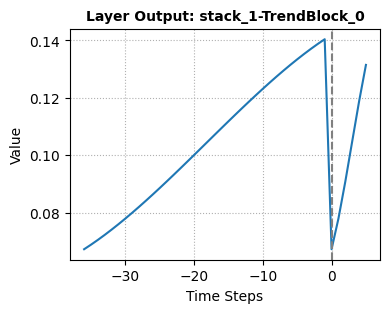

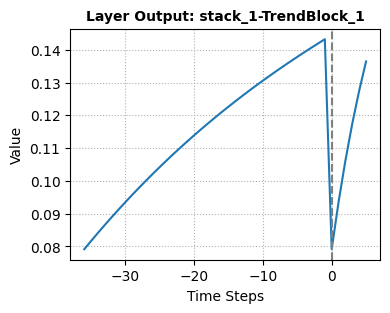

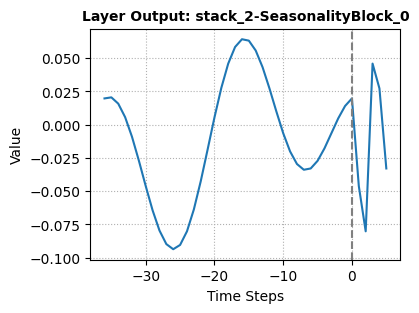

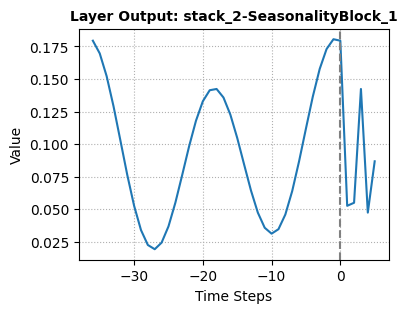

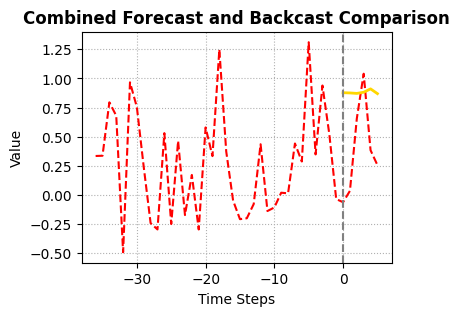

Epoch = 1, Train Loss = 0.4597, Test Loss = 0.3881
Epoch = 2, Train Loss = 0.2506, Test Loss = 0.2044
Epoch = 3, Train Loss = 0.1333, Test Loss = 0.1055
Epoch = 4, Train Loss = 0.0709, Test Loss = 0.0495
Epoch = 5, Train Loss = 0.0338, Test Loss = 0.0196
Epoch = 6, Train Loss = 0.0153, Test Loss = 0.0094
Epoch = 7, Train Loss = 0.0093, Test Loss = 0.0061
Epoch = 8, Train Loss = 0.0070, Test Loss = 0.0043
Epoch = 9, Train Loss = 0.0057, Test Loss = 0.0032
Epoch = 10, Train Loss = 0.0049, Test Loss = 0.0026
Epoch = 11, Train Loss = 0.0045, Test Loss = 0.0022
Epoch = 12, Train Loss = 0.0043, Test Loss = 0.0021
Epoch = 13, Train Loss = 0.0042, Test Loss = 0.0020
Epoch = 14, Train Loss = 0.0042, Test Loss = 0.0019
Epoch = 15, Train Loss = 0.0042, Test Loss = 0.0019
Epoch = 16, Train Loss = 0.0042, Test Loss = 0.0019
Epoch = 17, Train Loss = 0.0041, Test Loss = 0.0019
Epoch = 18, Train Loss = 0.0041, Test Loss = 0.0018
Epoch = 19, Train Loss = 0.0041, Test Loss = 0.0018
Epoch = 20, Train Los

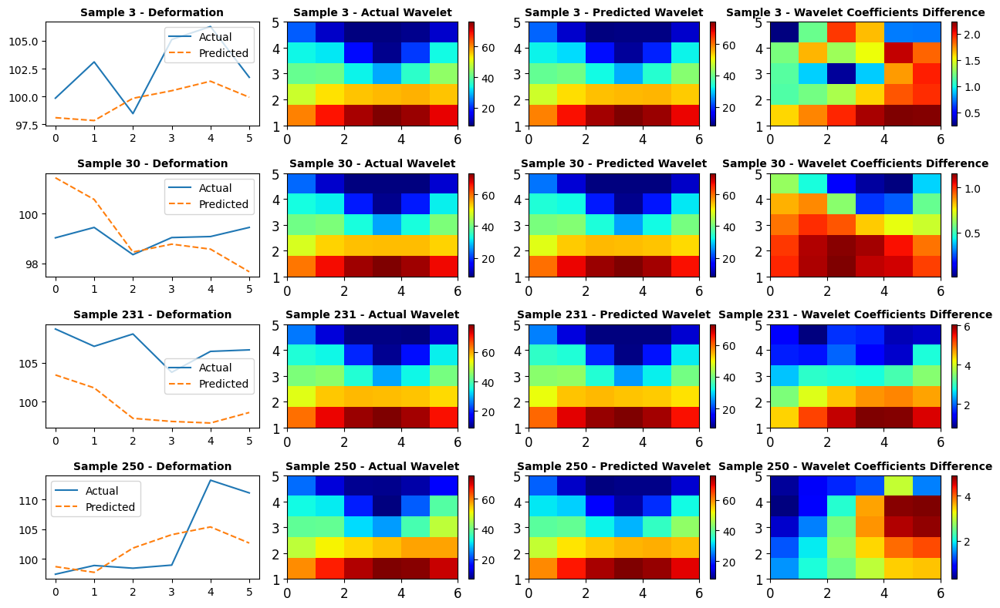

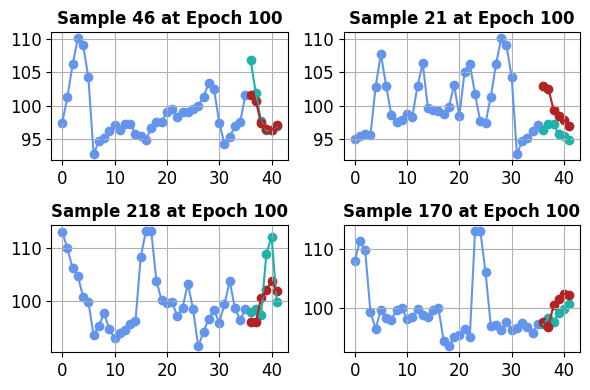

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.24578914, -0.09221405,  0.10150997,  0.42956594, -0.4706647 ,
        0.41309053,  0.10509536, -0.28261876, -0.23622204, -0.2856382 ,
        0.5997609 , -0.39390162,  0.40818608, -0.76440156, -0.17087603,
       -0.3887946 ,  0.43981197, -0.1888581 ,  0.5054503 ,  0.4781729 ,
       -0.48615536, -0.19558012, -0.13766137, -0.2960354 , -0.0939388 ,
       -0.42097062, -0.21495739, -0.45882443, -0.14792393, -0.20006262,
       -0.2747699 ,  0.72721887,  0.02538042,  0.39166793,  0.03461846,
       -0.36082256], dtype=float32), 'forecast': array([-0.01215413,  0.34212506,  0.32568967,  0.4306764 ,  0.10686201,
        0.30241328], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.23135836,  0.11691936,  0.3161601 ,  0.22761054, -0.23899563,
        0.51685405,  0.3385799 ,  0.2699117 , -0.28521767, -0.17632967,
       -0.20730686, -0.089847  , -0.08837228,  0.21395317, -0.11739616,
       -0.3146421 , 

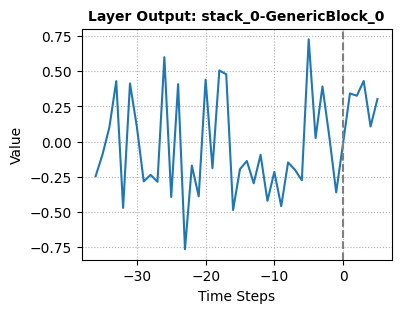

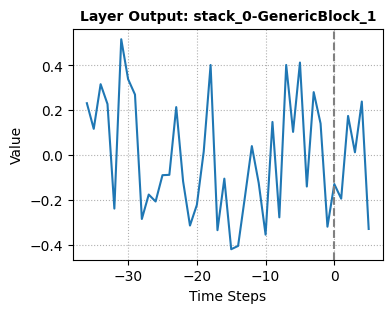

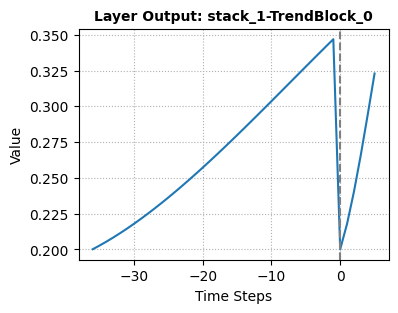

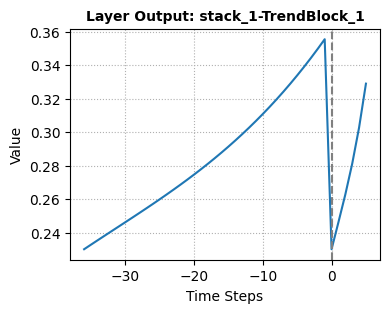

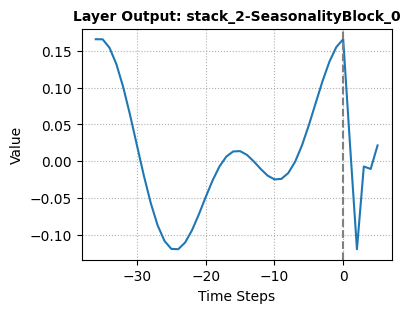

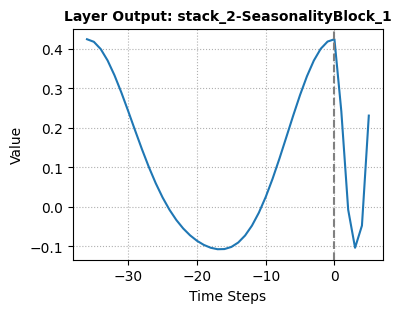

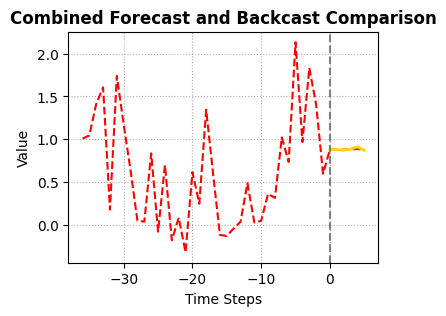

Epoch = 101, Train Loss = 0.0023, Test Loss = 0.0014
Epoch = 102, Train Loss = 0.0023, Test Loss = 0.0014
Epoch = 103, Train Loss = 0.0023, Test Loss = 0.0014
Epoch = 104, Train Loss = 0.0022, Test Loss = 0.0014
Epoch = 105, Train Loss = 0.0022, Test Loss = 0.0014
Epoch = 106, Train Loss = 0.0022, Test Loss = 0.0014
Epoch = 107, Train Loss = 0.0022, Test Loss = 0.0014
Epoch = 108, Train Loss = 0.0022, Test Loss = 0.0014
Epoch = 109, Train Loss = 0.0022, Test Loss = 0.0014
Epoch = 110, Train Loss = 0.0022, Test Loss = 0.0014
Epoch = 111, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 112, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 113, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 114, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 115, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 116, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 117, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 118, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 119, Train Loss = 0.0020, Test Loss = 

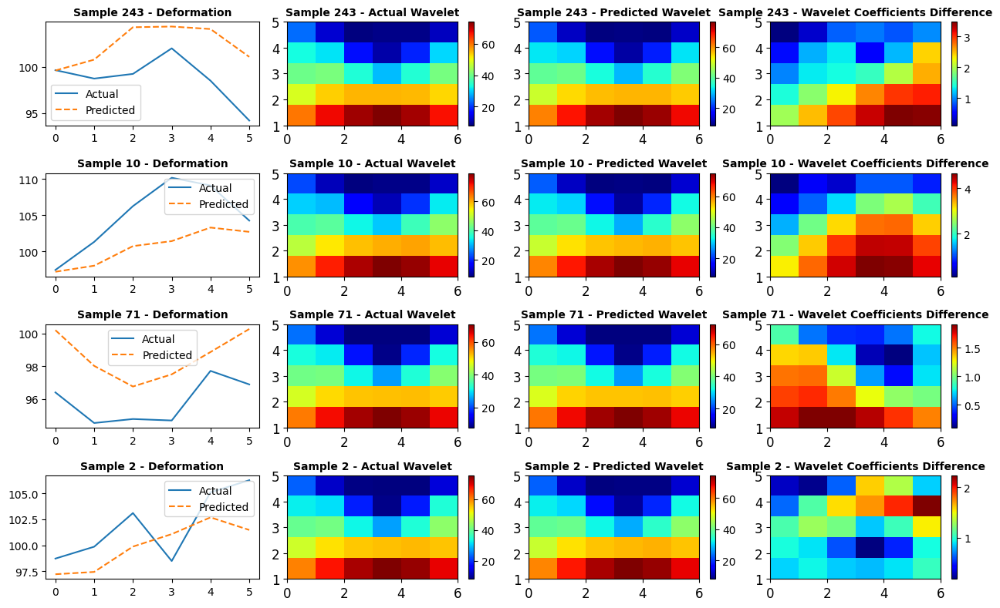

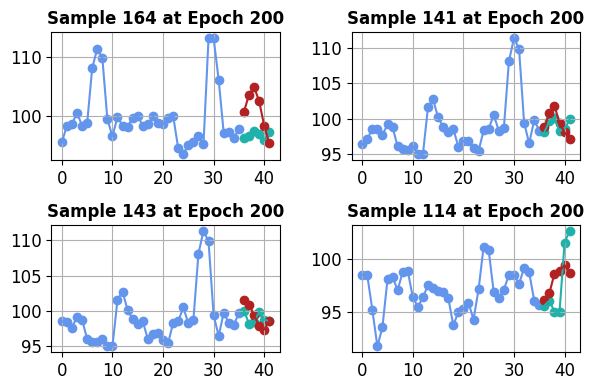

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.25806364, -0.09004795,  0.11673302,  0.39631817, -0.45649353,
        0.38914433,  0.10091579, -0.27441657, -0.19959994, -0.2750305 ,
        0.5982509 , -0.39449838,  0.3921827 , -0.75276166, -0.12975346,
       -0.35805348,  0.4497641 , -0.16847584,  0.49259683,  0.4526612 ,
       -0.46622574, -0.19345582, -0.13160022, -0.26427394, -0.07297465,
       -0.41483188, -0.17153381, -0.44075325, -0.14979511, -0.19679858,
       -0.27157804,  0.699777  ,  0.04002573,  0.3698653 ,  0.01859281,
       -0.35694644], dtype=float32), 'forecast': array([-0.00472532,  0.3442135 ,  0.33303797,  0.4445864 ,  0.1031331 ,
        0.27783674], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.23306938,  0.12338554,  0.31141135,  0.23110418, -0.23561119,
        0.51319206,  0.3428    ,  0.26781547, -0.27903485, -0.17105262,
       -0.20367898, -0.08379474, -0.08054091,  0.21951671, -0.10945015,
       -0.3151622 , 

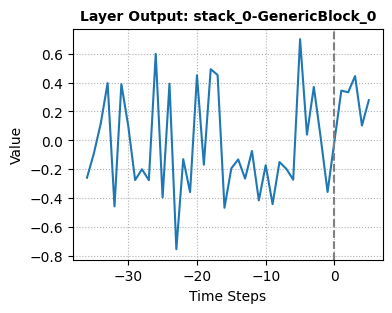

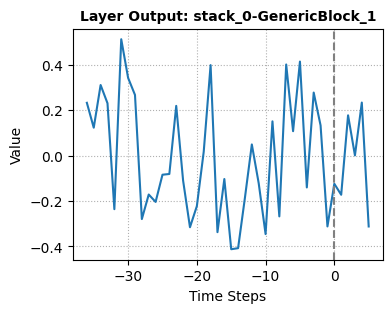

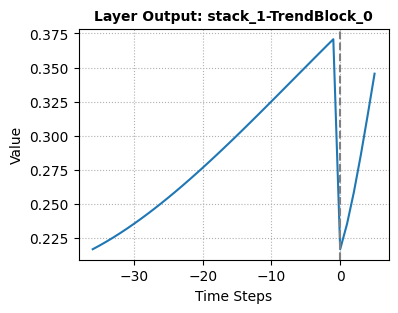

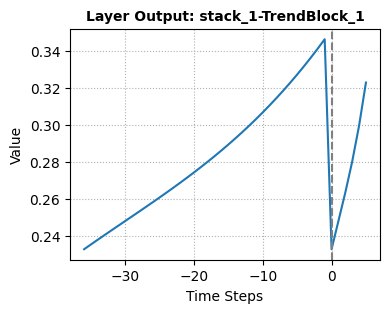

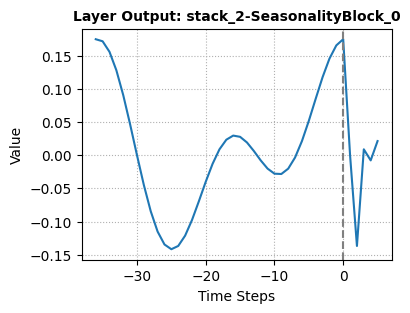

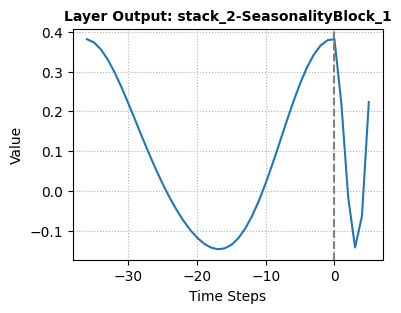

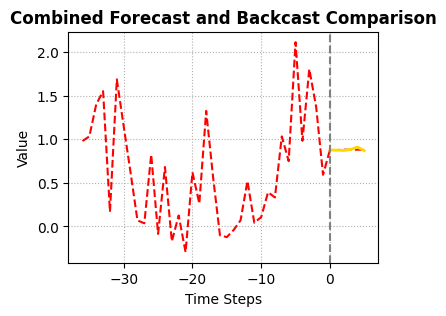

Epoch = 201, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 202, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 203, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 204, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 205, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 206, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 207, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 208, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 209, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 210, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 211, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 212, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 213, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 214, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 215, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 216, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 217, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 218, Train Loss = 0.0016, Test Loss = 0.0014
Epoch = 219, Train Loss = 0.0016, Test Loss = 

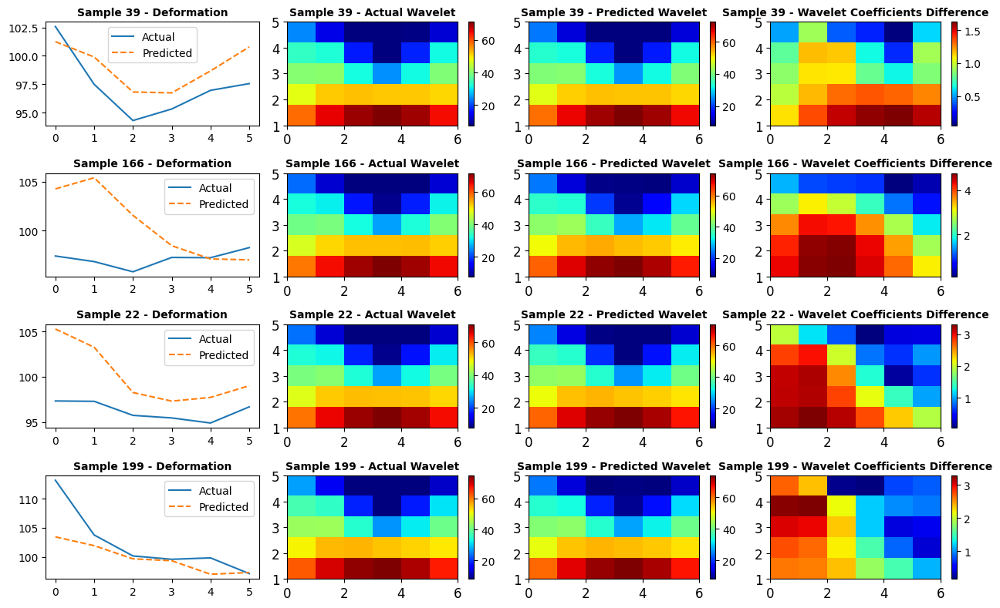

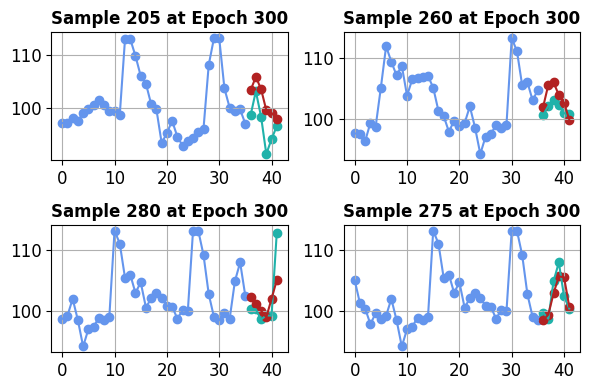

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.2624967 , -0.088704  ,  0.12399617,  0.38156015, -0.44796324,
        0.37646788,  0.09665214, -0.27258506, -0.18158549, -0.268382  ,
        0.60152775, -0.394357  ,  0.38451684, -0.7478224 , -0.10908522,
       -0.34661967,  0.45458978, -0.16081364,  0.4852841 ,  0.43891168,
       -0.4565151 , -0.1928028 , -0.12871578, -0.2477295 , -0.06463678,
       -0.40993157, -0.14763498, -0.43067387, -0.14896297, -0.19719945,
       -0.2709517 ,  0.6881225 ,  0.04706684,  0.3598734 ,  0.01321811,
       -0.35863543], dtype=float32), 'forecast': array([0.00750584, 0.34576425, 0.32034326, 0.4467521 , 0.10442512,
       0.27764308], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.23693068,  0.1236705 ,  0.3149163 ,  0.23406373, -0.23794954,
        0.51251036,  0.33449924,  0.27228788, -0.2685376 , -0.17099711,
       -0.20055518, -0.08347923, -0.08383126,  0.22513793, -0.10374621,
       -0.32268733, -0.216

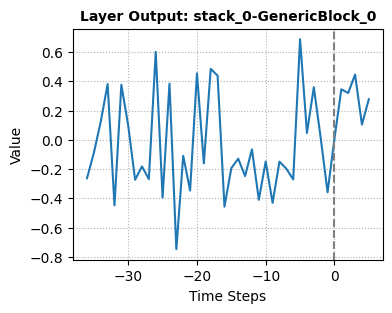

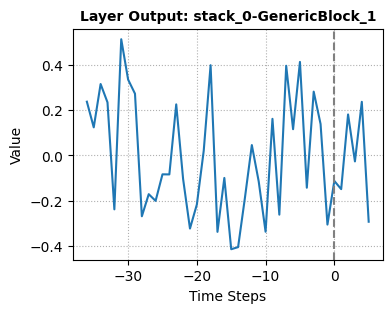

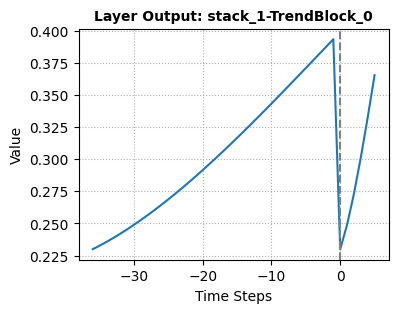

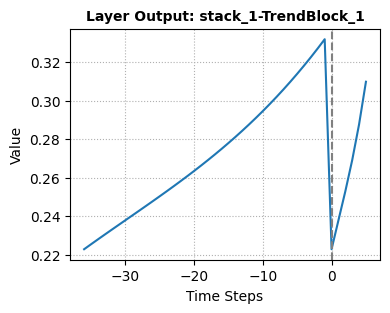

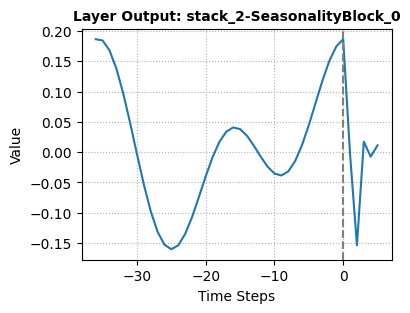

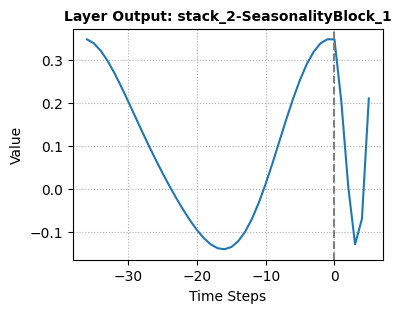

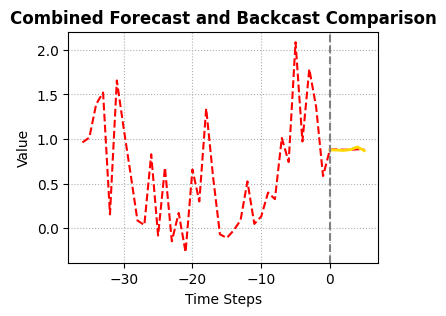

Epoch = 301, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 302, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 303, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 304, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 305, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 306, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 307, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 308, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 309, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 310, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 311, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 312, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 313, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 314, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 315, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 316, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 317, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 318, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 319, Train Loss = 0.0015, Test Loss = 

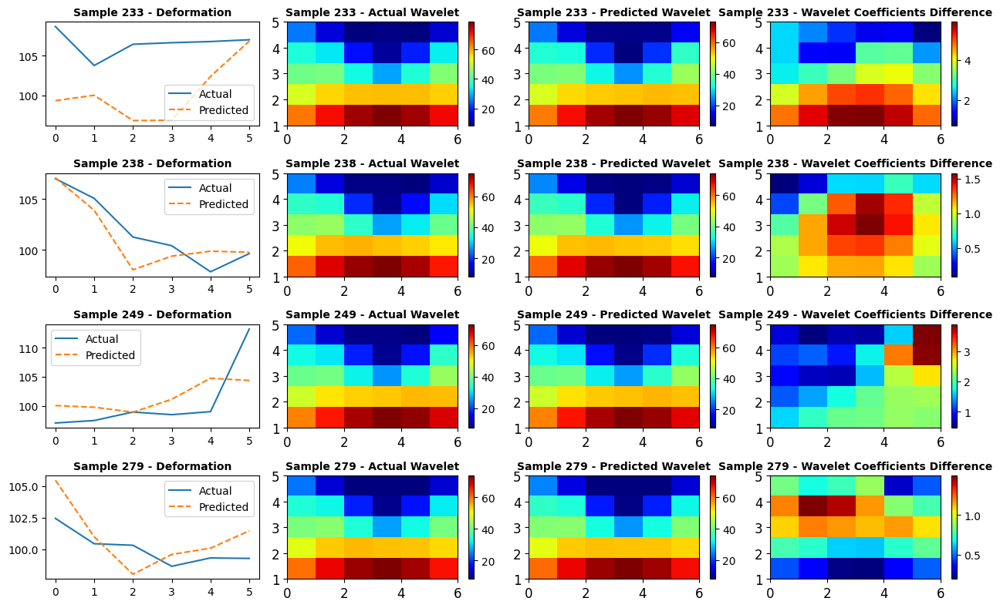

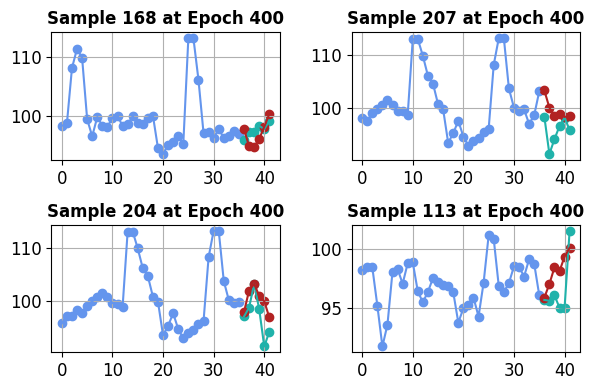

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.26430932, -0.08281177,  0.1297526 ,  0.36332682, -0.44844475,
        0.3636899 ,  0.10155638, -0.25875697, -0.17061369, -0.2635997 ,
        0.5966623 , -0.38454452,  0.37878397, -0.7308587 , -0.10036672,
       -0.33604583,  0.45849815, -0.15273117,  0.48108852,  0.43133792,
       -0.44917125, -0.19563366, -0.12709151, -0.24507536, -0.05646062,
       -0.3996823 , -0.13839008, -0.42057332, -0.13668512, -0.20413393,
       -0.25782526,  0.6729319 ,  0.05502043,  0.35698965,  0.01048581,
       -0.35434565], dtype=float32), 'forecast': array([0.00918094, 0.340058  , 0.31176078, 0.44245937, 0.09803002,
       0.28214714], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.24284379,  0.12223204,  0.31801113,  0.22964913, -0.24335775,
        0.5163726 ,  0.33997393,  0.2747622 , -0.2613133 , -0.16859634,
       -0.19185579, -0.08321874, -0.07967182,  0.22941609, -0.09938643,
       -0.32681617, -0.218

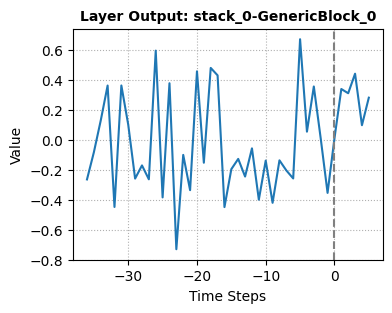

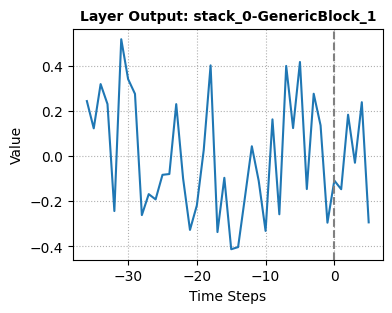

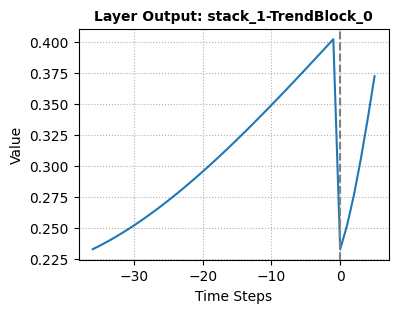

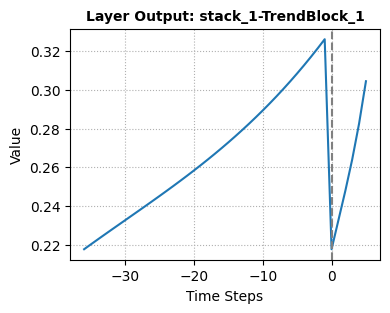

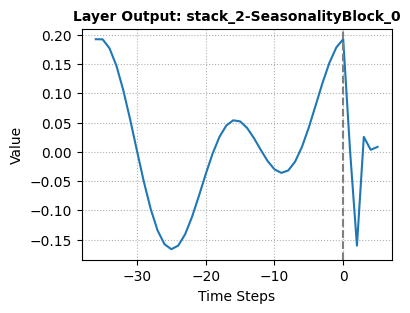

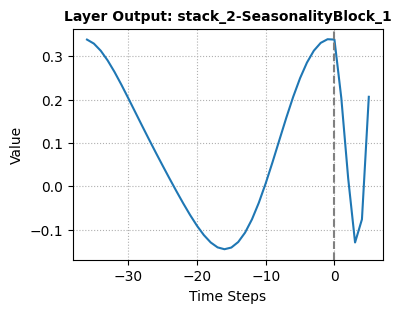

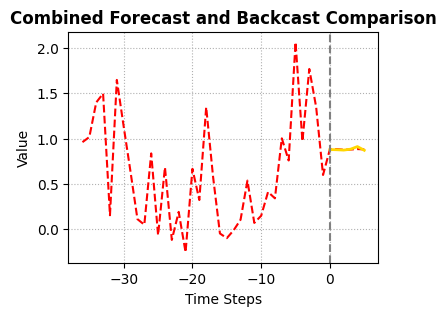

Epoch = 401, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 402, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 403, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 404, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 405, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 406, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 407, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 408, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 409, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 410, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 411, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 412, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 413, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 414, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 415, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 416, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 417, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 418, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 419, Train Loss = 0.0014, Test Loss = 

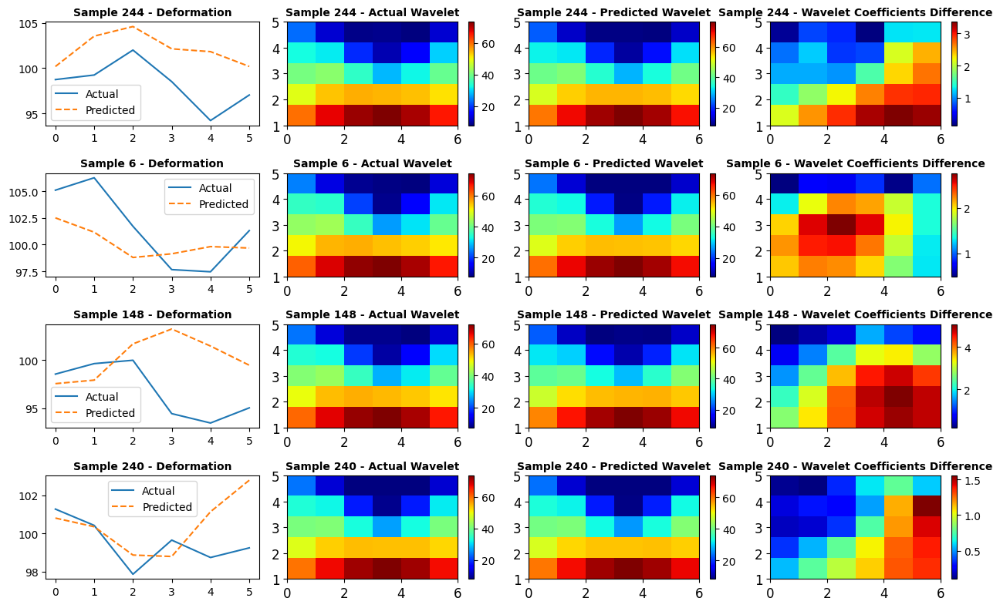

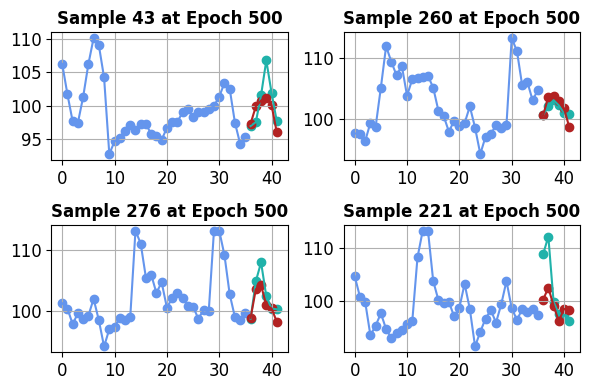

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.2670322 , -0.08041924,  0.13181394,  0.34525308, -0.44895366,
        0.35000035,  0.10660814, -0.24345179, -0.16006717, -0.25936183,
        0.58958054, -0.37424213,  0.37240374, -0.7136576 , -0.09169052,
       -0.32471386,  0.46229506, -0.14343353,  0.47820905,  0.42356163,
       -0.4417085 , -0.19919832, -0.12535618, -0.24234566, -0.04794684,
       -0.38906908, -0.13122763, -0.41007242, -0.1252288 , -0.21167499,
       -0.24366283,  0.6575142 ,  0.06285951,  0.3537109 ,  0.00360811,
       -0.3494217 ], dtype=float32), 'forecast': array([0.0074201 , 0.33361387, 0.30599815, 0.43725666, 0.09084006,
       0.28673476], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.2467316 ,  0.12129744,  0.31418407,  0.2270145 , -0.24815491,
        0.51763356,  0.3479178 ,  0.27458316, -0.25584662, -0.16485558,
       -0.1837487 , -0.08124617, -0.07294419,  0.23370941, -0.09548764,
       -0.33008474, -0.222

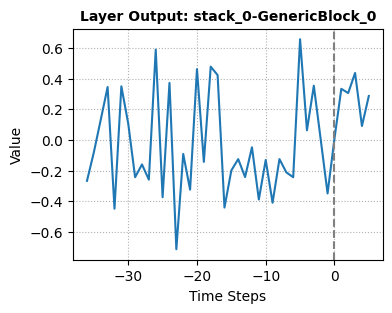

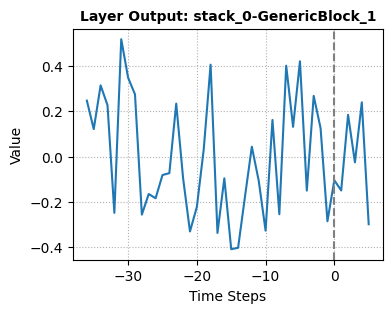

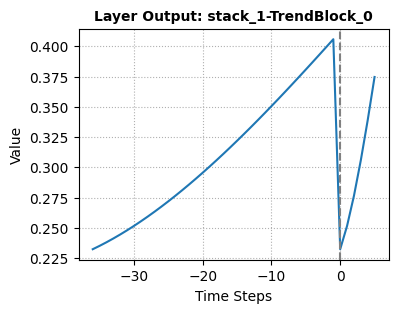

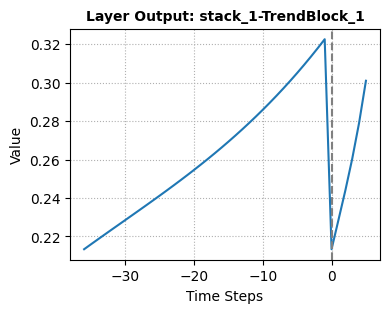

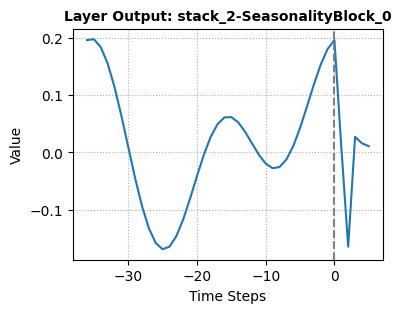

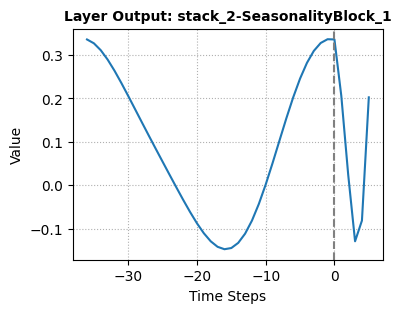

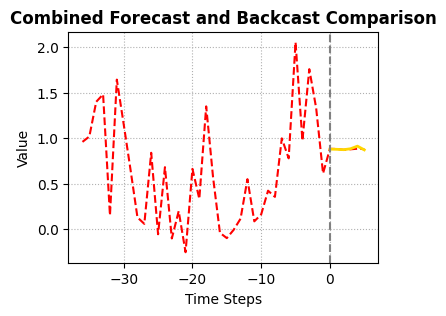

Epoch = 501, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 502, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 503, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 504, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 505, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 506, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 507, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 508, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 509, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 510, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 511, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 512, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 513, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 514, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 515, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 516, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 517, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 518, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 519, Train Loss = 0.0014, Test Loss = 

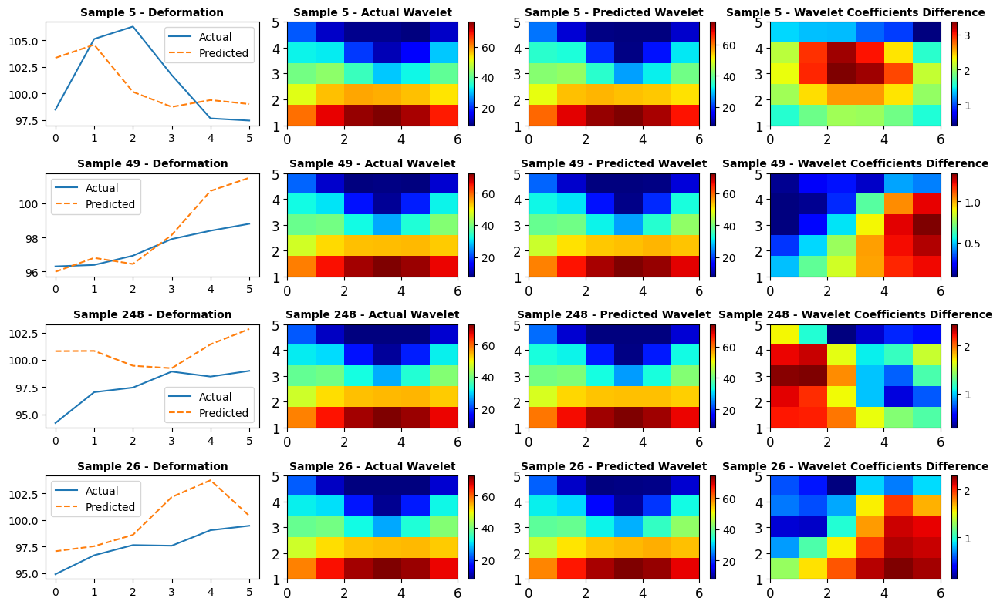

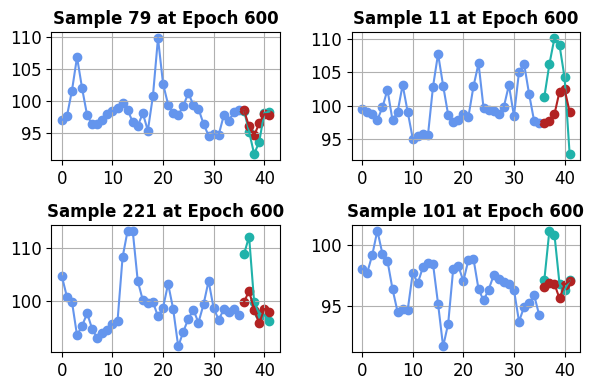

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-2.70228595e-01, -7.49235153e-02,  1.39838398e-01,  3.22844863e-01,
       -4.49552327e-01,  3.34601194e-01,  1.12282865e-01, -2.27201313e-01,
       -1.46842688e-01, -2.54702240e-01,  5.83176494e-01, -3.63155931e-01,
        3.65057319e-01, -6.92465305e-01, -7.92991593e-02, -3.09193820e-01,
        4.67559338e-01, -1.32611722e-01,  4.69538808e-01,  4.13228244e-01,
       -4.34328467e-01, -2.01141104e-01, -1.24477223e-01, -2.38026768e-01,
       -3.71455625e-02, -3.78169566e-01, -1.20552294e-01, -3.97147149e-01,
       -1.13263369e-01, -2.19524786e-01, -2.28393495e-01,  6.39161289e-01,
        7.15988725e-02,  3.49025667e-01,  6.43599953e-04, -3.43447000e-01],
      dtype=float32), 'forecast': array([0.0026898 , 0.32363725, 0.2998597 , 0.43029746, 0.07933745,
       0.2925866 ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.24911873,  0.12425608,  0.31331873,  0.22776744, -0.25446644,
        0.517

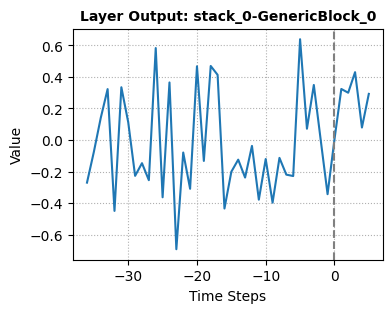

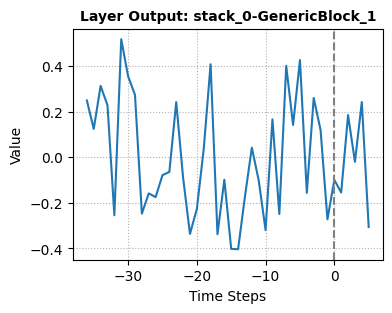

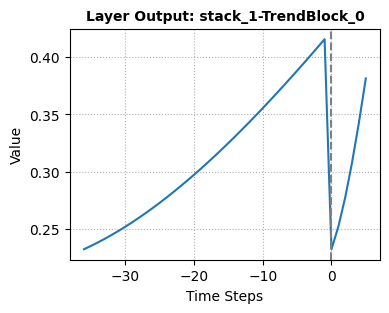

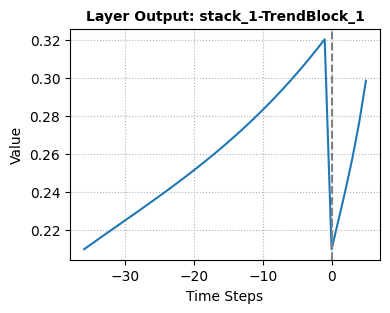

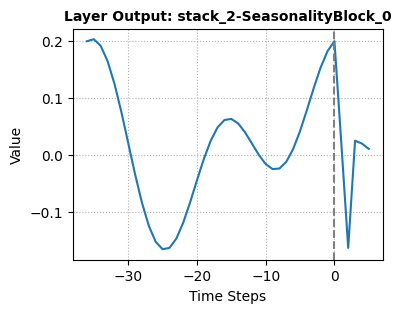

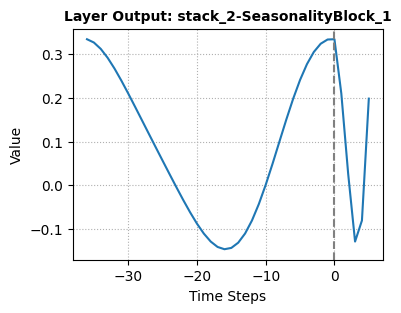

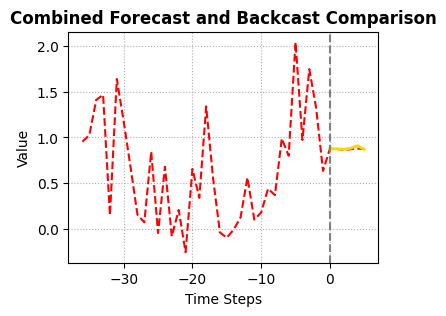

Epoch = 601, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 602, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 603, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 604, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 605, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 606, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 607, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 608, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 609, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 610, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 611, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 612, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 613, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 614, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 615, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 616, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 617, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 618, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 619, Train Loss = 0.0013, Test Loss = 

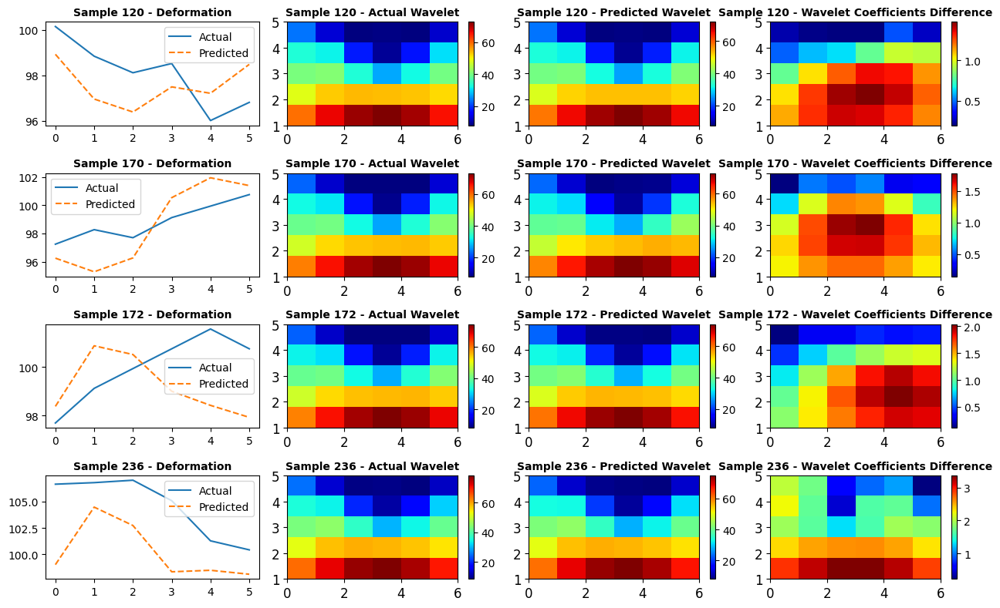

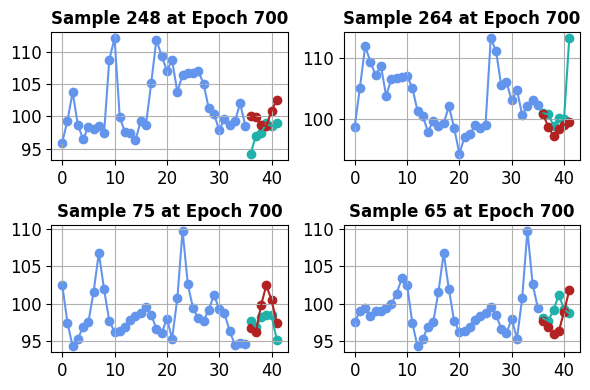

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.273037  , -0.06838173,  0.14738601,  0.29470634, -0.45150807,
        0.31514156,  0.12071444, -0.20806003, -0.1308753 , -0.25127164,
        0.5751808 , -0.34890115,  0.35686788, -0.6689259 , -0.06671755,
       -0.28862354,  0.47507688, -0.11710888,  0.46241415,  0.40151966,
       -0.4257042 , -0.20297052, -0.12164868, -0.23283055, -0.02295701,
       -0.36624402, -0.10643075, -0.38205528, -0.09971205, -0.22744814,
       -0.20978779,  0.61626637,  0.08173382,  0.34286046, -0.00587714,
       -0.33540937], dtype=float32), 'forecast': array([-0.00601986,  0.30864242,  0.29772875,  0.42178008,  0.06242298,
        0.29700163], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.25198656,  0.12760818,  0.30939427,  0.22614579, -0.2583273 ,
        0.5152902 ,  0.36582646,  0.2707978 , -0.24152118, -0.15181781,
       -0.16706778, -0.0738816 , -0.05354116,  0.24735114, -0.08519948,
       -0.3379119 , 

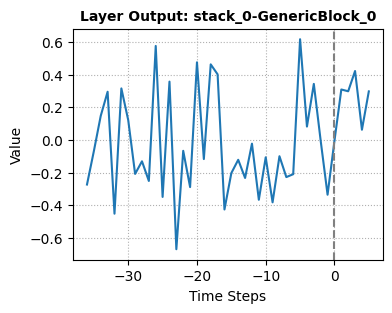

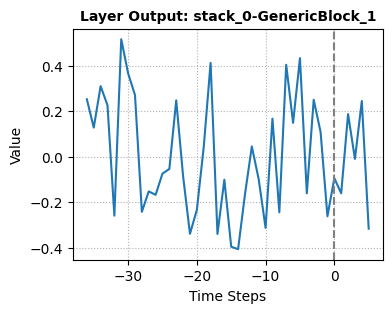

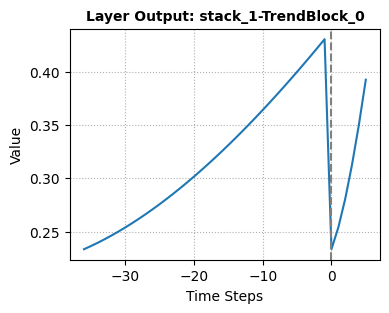

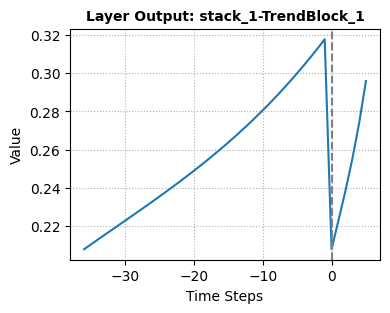

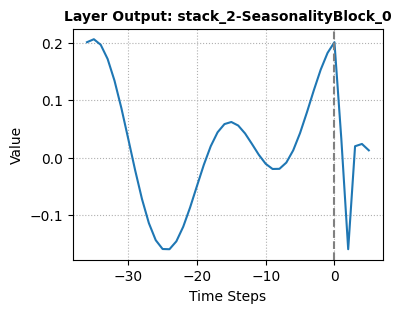

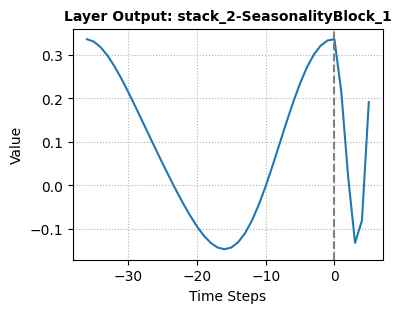

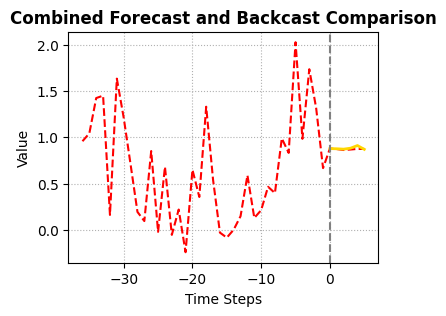

Epoch = 701, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 702, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 703, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 704, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 705, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 706, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 707, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 708, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 709, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 710, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 711, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 712, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 713, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 714, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 715, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 716, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 717, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 718, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 719, Train Loss = 0.0014, Test Loss = 

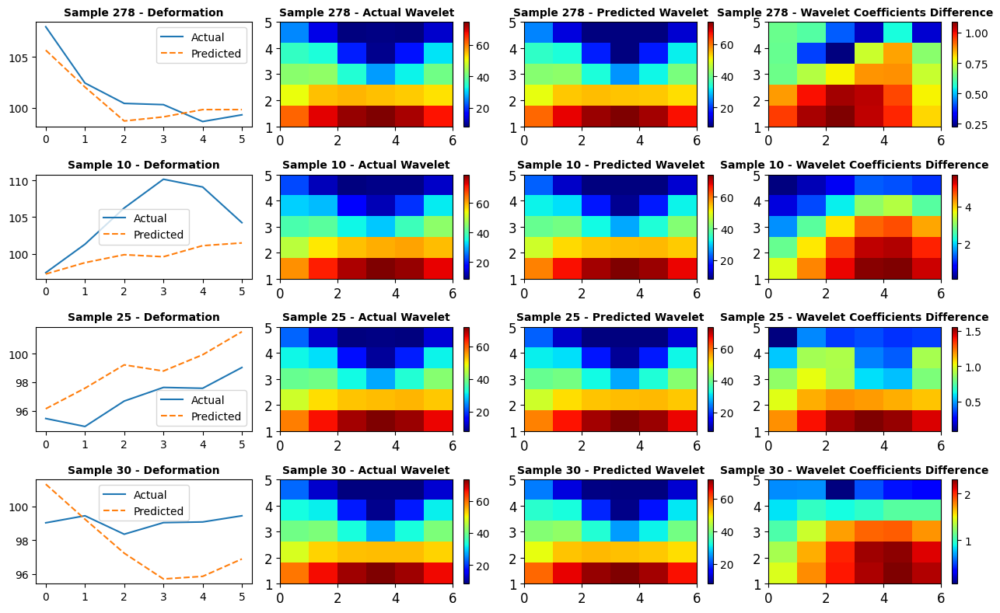

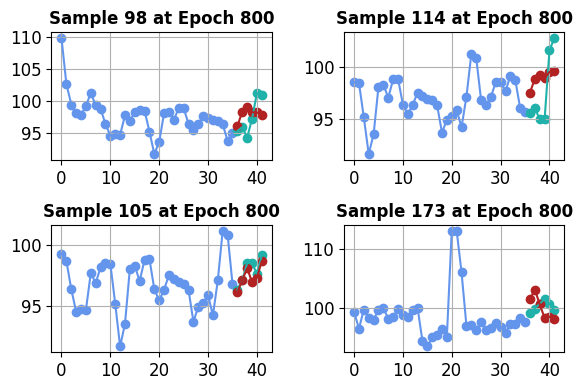

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.27670944, -0.06026999,  0.15692498,  0.25959107, -0.45074075,
        0.29015145,  0.12704188, -0.18781237, -0.1056249 , -0.24365199,
        0.5660423 , -0.3334889 ,  0.34573823, -0.6432827 , -0.04445887,
       -0.26314896,  0.4847173 , -0.10058487,  0.45353508,  0.38332462,
       -0.41217378, -0.20565142, -0.11694828, -0.22292161, -0.00644614,
       -0.35294417, -0.08365987, -0.3645781 , -0.0839426 , -0.23577973,
       -0.19099492,  0.58907974,  0.09611339,  0.33236477, -0.00775355,
       -0.3260608 ], dtype=float32), 'forecast': array([-0.02171782,  0.28819963,  0.3046072 ,  0.41141883,  0.03957361,
        0.29660603], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.26449856,  0.12965491,  0.3036999 ,  0.22757094, -0.26739642,
        0.5125089 ,  0.36834854,  0.26708582, -0.22751744, -0.14531298,
       -0.15775998, -0.06950703, -0.04732674,  0.25652745, -0.06964099,
       -0.3496942 , 

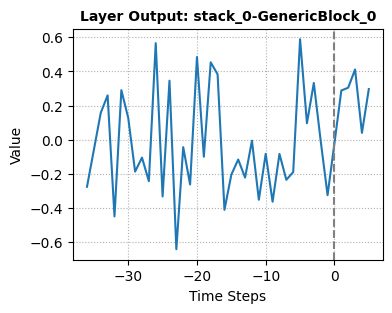

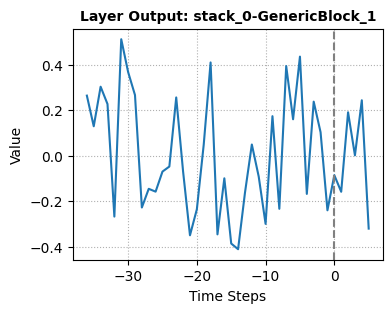

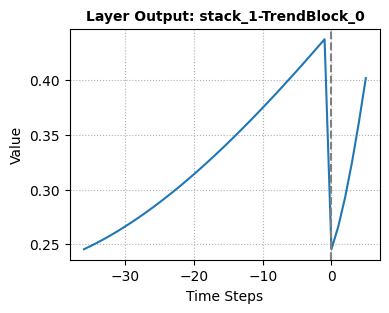

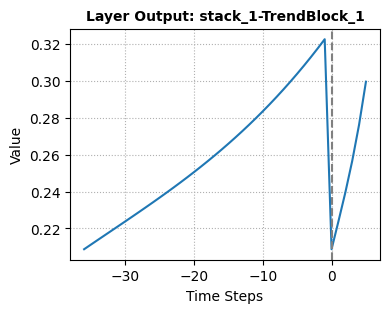

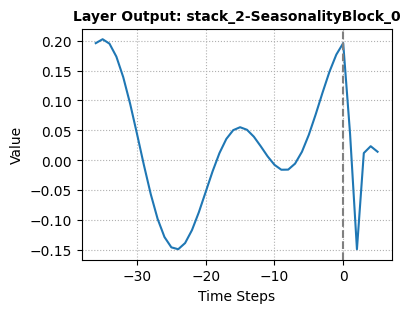

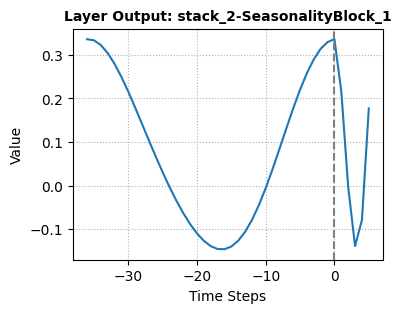

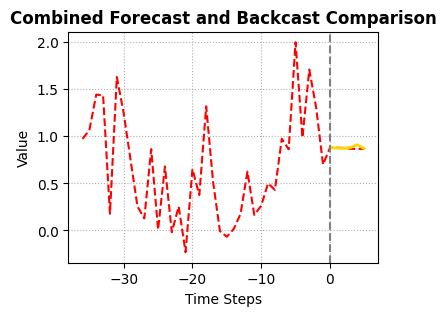

Epoch = 801, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 802, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 803, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 804, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 805, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 806, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 807, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 808, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 809, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 810, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 811, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 812, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 813, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 814, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 815, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 816, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 817, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 818, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 819, Train Loss = 0.0013, Test Loss = 

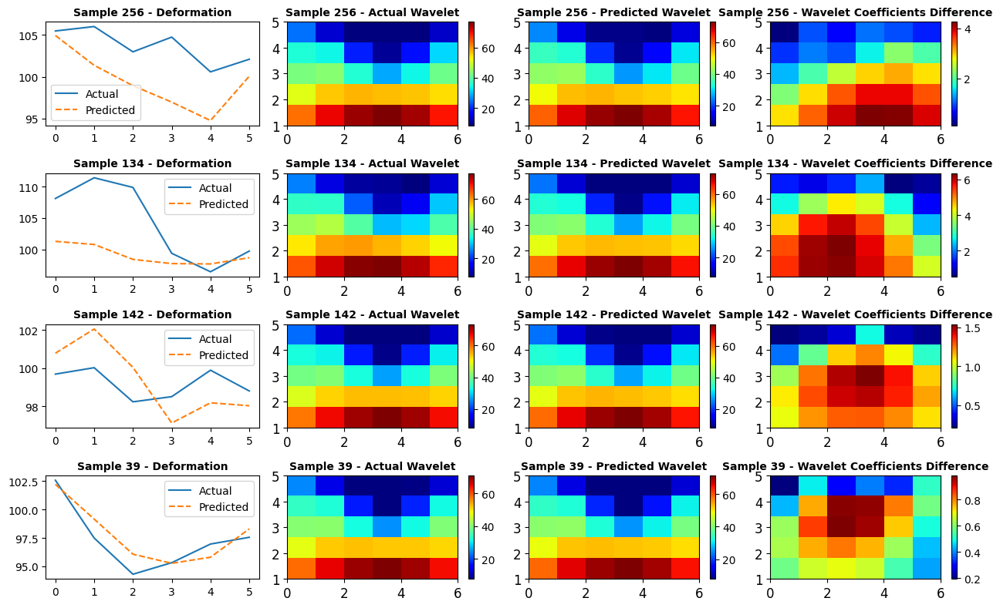

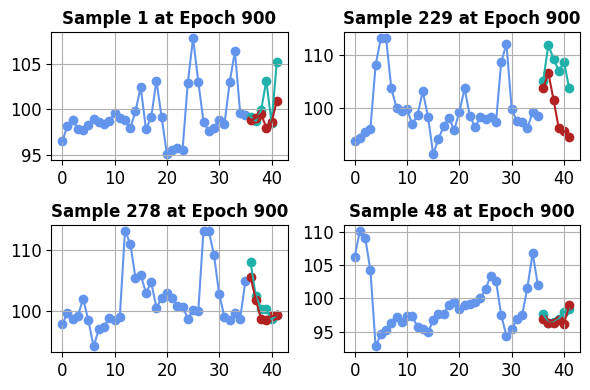

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.2790978 , -0.05328535,  0.16405223,  0.233493  , -0.45092955,
        0.27307203,  0.13229239, -0.17304361, -0.08741439, -0.23970832,
        0.5621695 , -0.32205132,  0.33906657, -0.6269141 , -0.02895176,
       -0.24317415,  0.49318296, -0.08625448,  0.4483769 ,  0.37017766,
       -0.4023172 , -0.20651628, -0.11371372, -0.21606986,  0.00691136,
       -0.34424546, -0.06506175, -0.35188267, -0.07229753, -0.23959212,
       -0.17751642,  0.56924284,  0.10585553,  0.3255977 , -0.01088876,
       -0.31869796], dtype=float32), 'forecast': array([-0.03555075,  0.27232787,  0.30818808,  0.40212837,  0.02147712,
        0.29886702], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.27362737,  0.13131401,  0.2997646 ,  0.22775471, -0.27171037,
        0.5107205 ,  0.3697802 ,  0.26494563, -0.21933937, -0.14103016,
       -0.15145326, -0.06600852, -0.04366542,  0.26031038, -0.05866737,
       -0.35409692, 

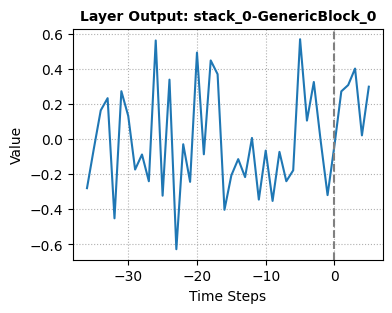

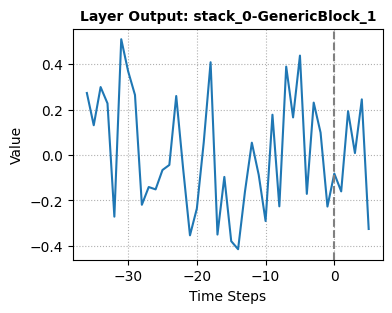

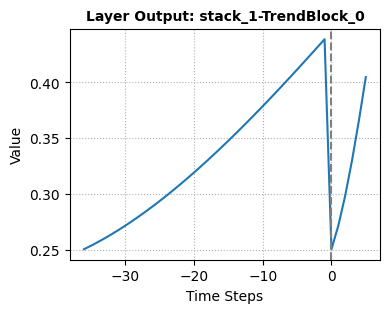

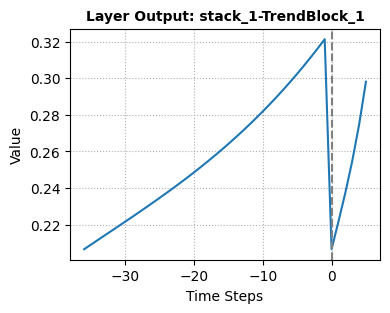

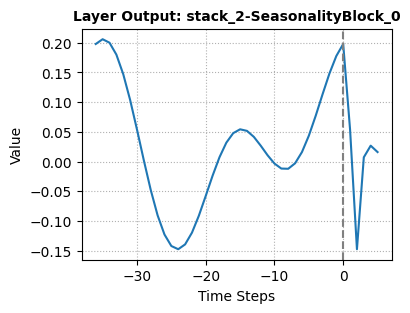

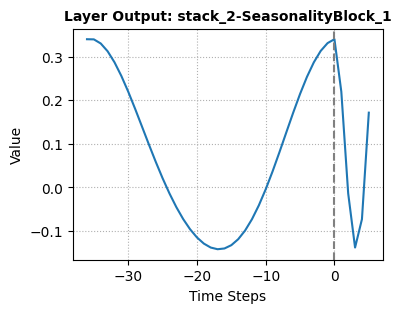

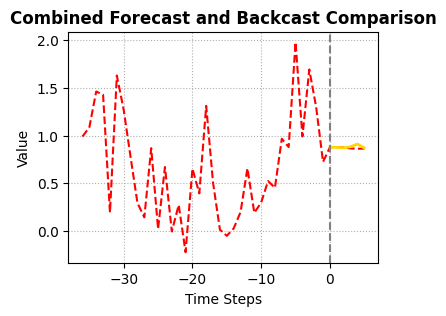

Epoch = 901, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 902, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 903, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 904, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 905, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 906, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 907, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 908, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 909, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 910, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 911, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 912, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 913, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 914, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 915, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 916, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 917, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 918, Train Loss = 0.0013, Test Loss = 0.0016
Epoch = 919, Train Loss = 0.0013, Test Loss = 

In [37]:
save_dir = 'plots_K3_3B1_36'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

In [38]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from math import sqrt


net.eval()
with torch.no_grad():

    _,predicted_test = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    predicted_test = predicted_test.detach().cpu().numpy() * norm_constant
    y_test_actual = y_test * norm_constant

    rmse = sqrt(mean_squared_error(y_test_actual, predicted_test))
    mae = mean_absolute_error(y_test_actual, predicted_test)

print(f"Test RMSE: {rmse}")
print(f"Test MAE: {mae}")


Test RMSE: 4.6330562571190095
Test MAE: 3.2118892830029893


# Neural Network-Based Feature Extraction for Deformation Observations in the K3_3B1 (Input length: 48)

In [44]:
import pandas as pd
import numpy as np


# Load the data
file_path = '/content/df_3h_spatialandprec_features.csv'
data = pd.read_csv(file_path,index_col=[0],parse_dates=True)

In [52]:
data_K3_3B1 = data[data.Station_id=='K3_3B1'][['Vertical displacement(mm)']]
data_K3_3B1

,Vertical displacement(mm)
date,
2022-02-02 00:00:00,78.735333
2022-02-02 03:00:00,76.416000
2022-02-02 06:00:00,79.454222
2022-02-02 09:00:00,76.285593
2022-02-02 12:00:00,79.687600
...,...
2022-08-01 09:00:00,99.295571
2022-08-01 12:00:00,99.256889
2022-08-01 15:00:00,112.854000


In [53]:
forecast_length = 6
backcast_length = 8 * forecast_length
batch_size = 32  # greater than 4 for viz

data_K3_3B1 = data_K3_3B1.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_K3_3B1) - forecast_length):
    x.append(data_K3_3B1[epoch - backcast_length:epoch])
    y.append(data_K3_3B1[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=48, forecast_length=6, share_thetas=False) at @138464852119024
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=48, forecast_length=6, share_thetas=False) at @138464852131360
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=48, forecast_length=6, share_thetas=True) at @138464849720464
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=48, forecast_length=6, share_thetas=True) at @138464581526304
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=48, forecast_length=6, share_thetas=True) at @138464581531344
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=48, forecast_length=6, share_thetas=True) at @138464581520976


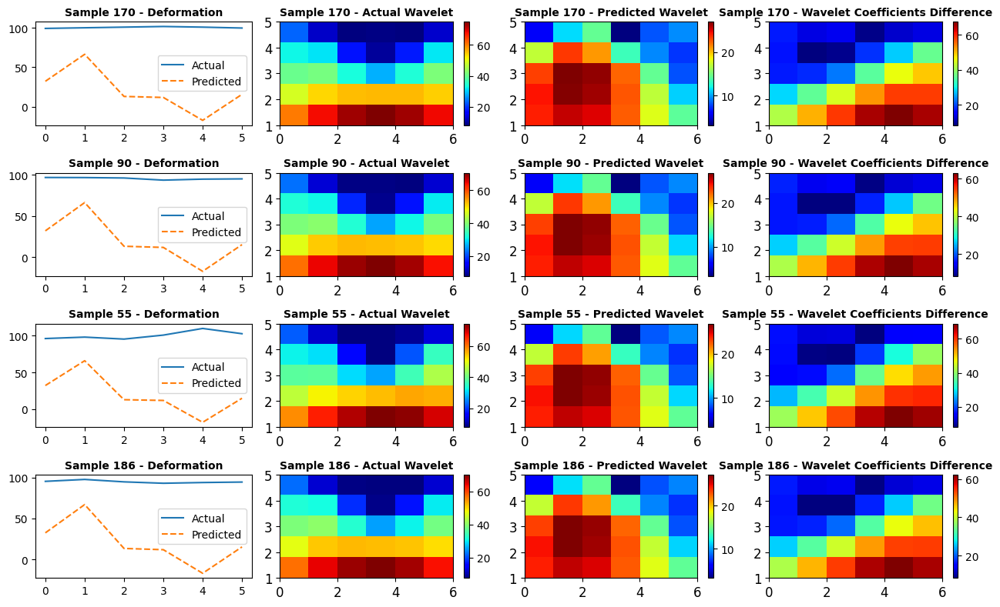

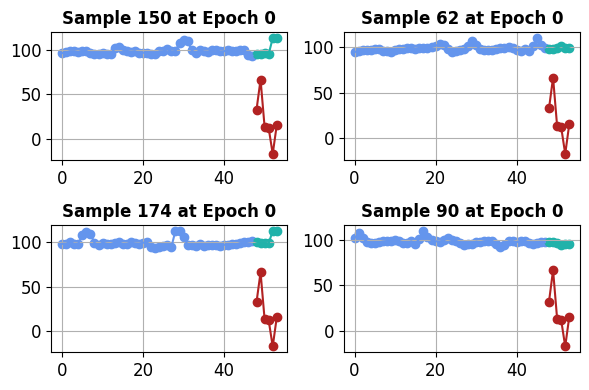

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.00853217,  0.30677965,  0.36930144,  0.09765454, -0.08030506,
       -0.5312352 , -0.27783987,  0.17225224, -0.1381397 , -0.04426167,
       -0.00175418,  0.33980274, -0.35978782, -0.20762807,  0.15439537,
        0.28995287,  0.11618854,  0.43482414, -0.13133262, -0.5514225 ,
        0.1399302 ,  0.48530224, -0.08754894, -0.04679162,  0.05462527,
        0.37084177, -0.38754207,  0.23734653, -0.20355217, -0.26389167,
       -0.33367693, -0.46605438,  0.18971418,  0.0614428 , -0.04522556,
       -0.32397446,  0.02312451,  0.47023252,  0.07360644,  0.04207234,
       -0.2981685 ,  0.35049757,  0.20311451,  0.147542  , -0.4535225 ,
        0.4647873 ,  0.03522854, -0.01101316], dtype=float32), 'forecast': array([ 0.46890336, -0.18310651, -0.45946488,  0.352752  , -0.25712046,
       -0.4292374 ], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.11549819, -0.2608004 , -0.09338909,  0.41220698, -0.2560

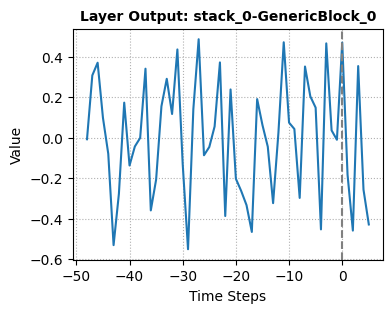

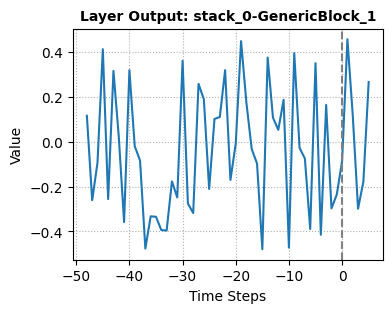

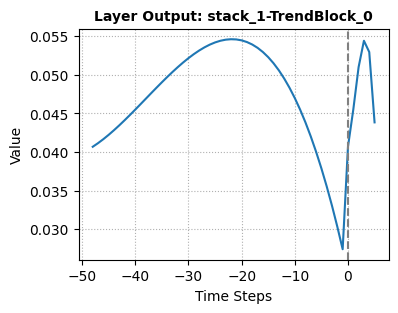

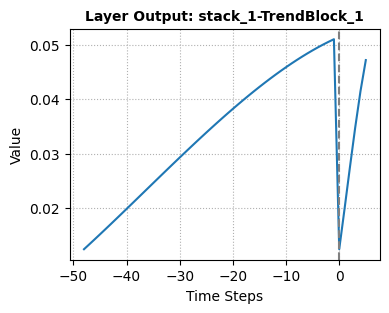

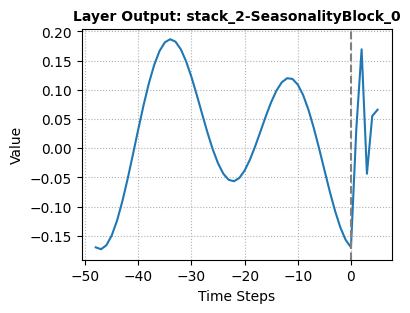

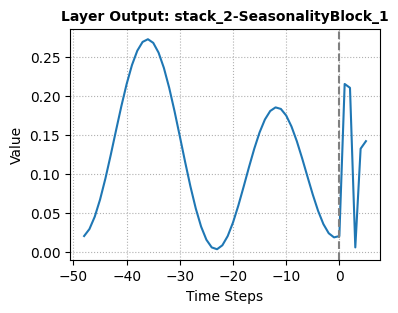

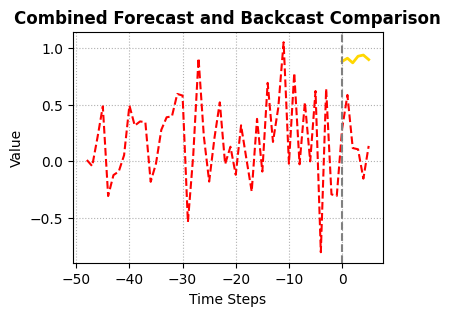

Epoch = 1, Train Loss = 0.6410, Test Loss = 0.5436
Epoch = 2, Train Loss = 0.3423, Test Loss = 0.2732
Epoch = 3, Train Loss = 0.1457, Test Loss = 0.0946
Epoch = 4, Train Loss = 0.0418, Test Loss = 0.0224
Epoch = 5, Train Loss = 0.0139, Test Loss = 0.0084
Epoch = 6, Train Loss = 0.0072, Test Loss = 0.0040
Epoch = 7, Train Loss = 0.0045, Test Loss = 0.0025
Epoch = 8, Train Loss = 0.0037, Test Loss = 0.0021
Epoch = 9, Train Loss = 0.0035, Test Loss = 0.0020
Epoch = 10, Train Loss = 0.0035, Test Loss = 0.0019
Epoch = 11, Train Loss = 0.0034, Test Loss = 0.0019
Epoch = 12, Train Loss = 0.0034, Test Loss = 0.0019
Epoch = 13, Train Loss = 0.0034, Test Loss = 0.0019
Epoch = 14, Train Loss = 0.0034, Test Loss = 0.0019
Epoch = 15, Train Loss = 0.0034, Test Loss = 0.0019
Epoch = 16, Train Loss = 0.0034, Test Loss = 0.0019
Epoch = 17, Train Loss = 0.0034, Test Loss = 0.0018
Epoch = 18, Train Loss = 0.0033, Test Loss = 0.0018
Epoch = 19, Train Loss = 0.0033, Test Loss = 0.0018
Epoch = 20, Train Los

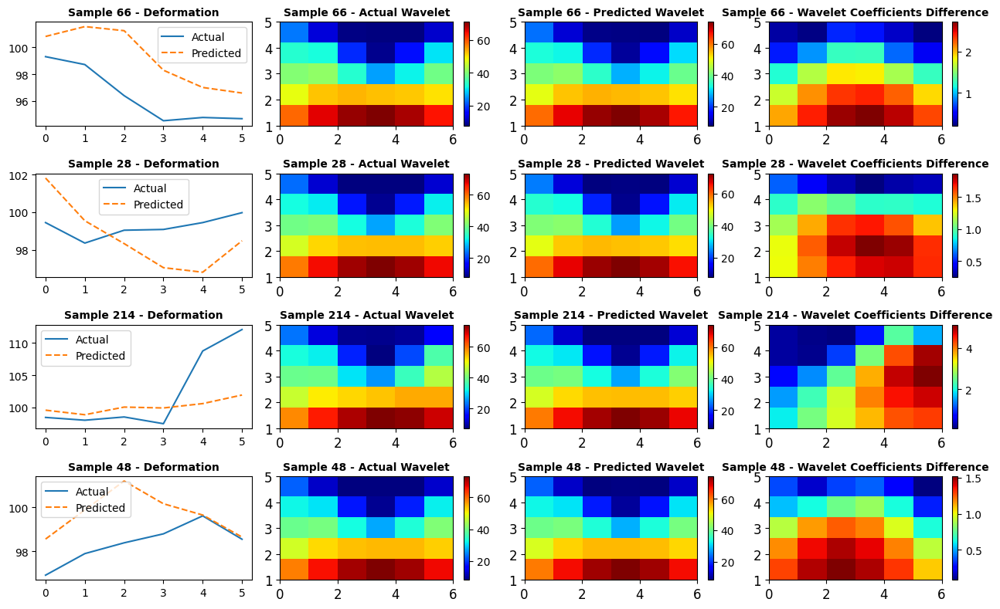

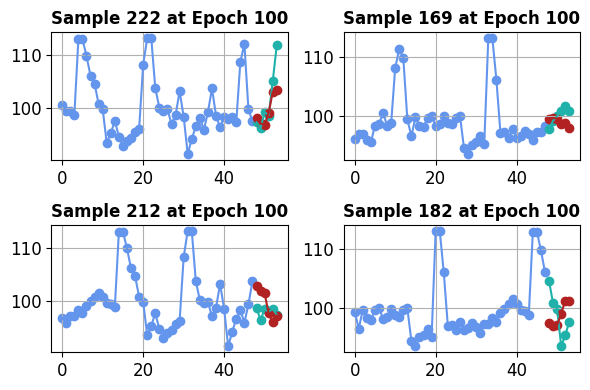

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.04347602,  0.35596007,  0.41978306,  0.15703379,  0.03028407,
       -0.6561248 , -0.2224351 ,  0.08189612, -0.17411588, -0.0565449 ,
        0.05928654,  0.23633549, -0.25479352, -0.23712987,  0.09061878,
        0.329064  , -0.04846168,  0.34392697, -0.05538799, -0.7790009 ,
       -0.01162496,  0.46412346, -0.12896654, -0.15387632, -0.1407817 ,
        0.24717991, -0.43778625,  0.319396  , -0.281633  , -0.23272322,
       -0.3043901 , -0.5605936 ,  0.21439163, -0.03751739,  0.16883233,
       -0.24570623,  0.08237105,  0.4434882 ,  0.09680942,  0.04253794,
       -0.42408937,  0.40445724,  0.29832384,  0.12111513, -0.5859687 ,
        0.48378593, -0.06612711, -0.07346638], dtype=float32), 'forecast': array([ 0.6475953 , -0.39678103, -0.39698532,  0.3575142 , -0.0692073 ,
       -0.35850254], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.11865472, -0.2643149 , -0.11179179,  0.2847567 , -0.1712

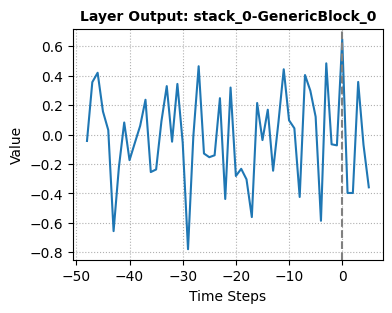

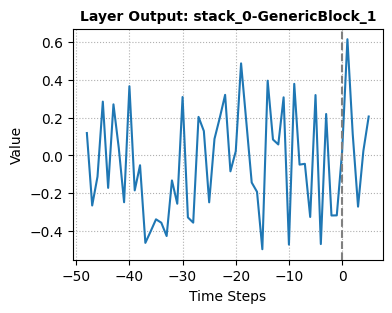

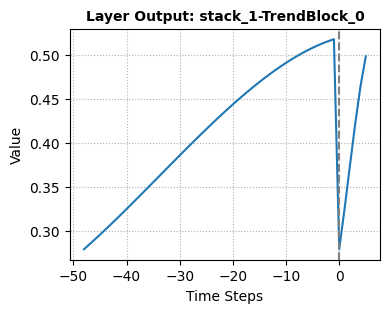

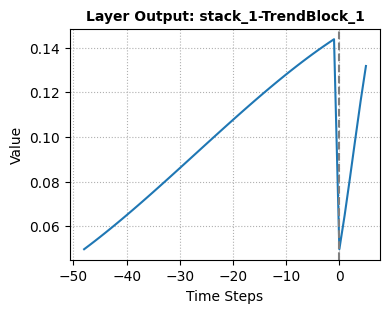

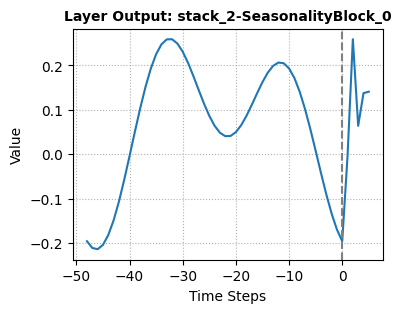

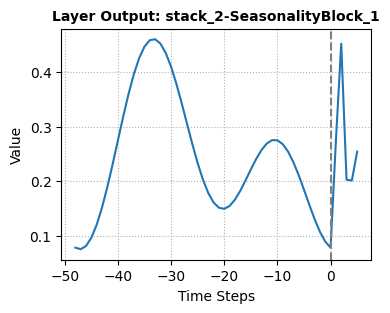

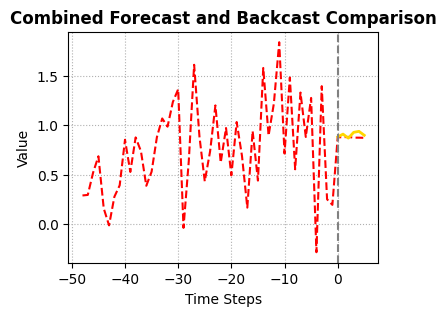

Epoch = 101, Train Loss = 0.0019, Test Loss = 0.0014
Epoch = 102, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 103, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 104, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 105, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 106, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 107, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 108, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 109, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 110, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 111, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 112, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 113, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 114, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 115, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 116, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 117, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 118, Train Loss = 0.0017, Test Loss = 0.0014
Epoch = 119, Train Loss = 0.0017, Test Loss = 

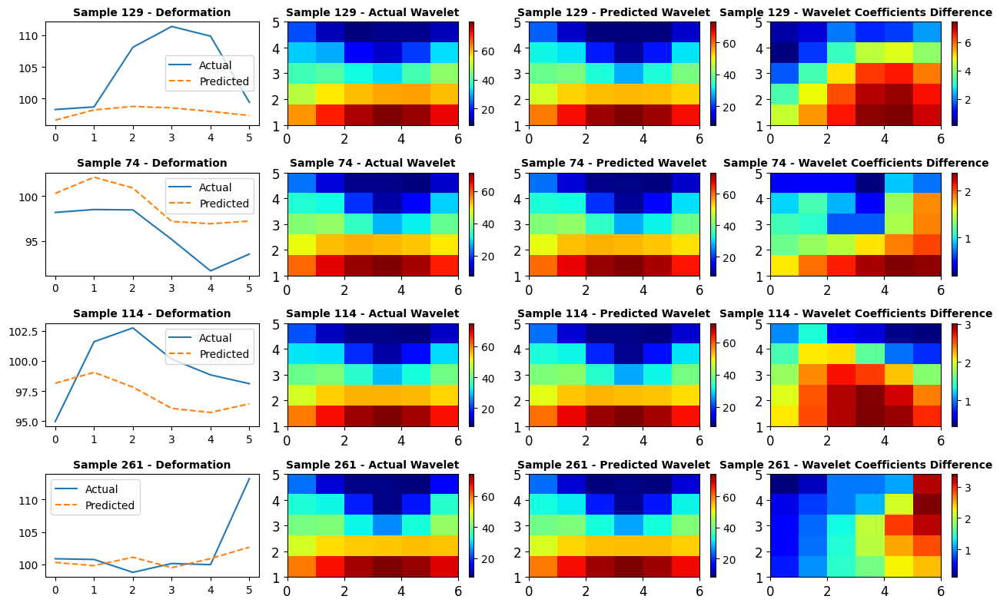

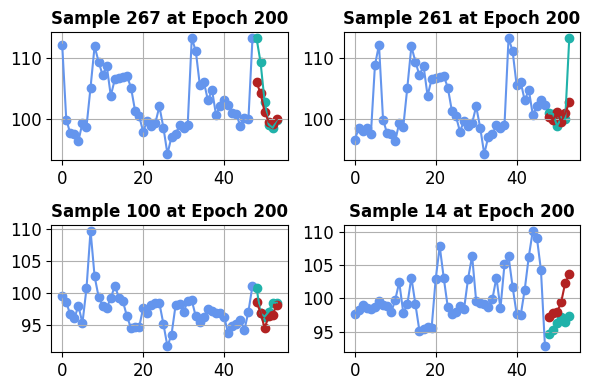

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.04274994,  0.35150155,  0.41813806,  0.15184645,  0.01255151,
       -0.6427934 , -0.2267147 ,  0.09365112, -0.16463251, -0.05457604,
        0.05182285,  0.2498531 , -0.26506373, -0.23721841,  0.10211261,
        0.32346666, -0.027349  ,  0.35230902, -0.06399385, -0.75245917,
        0.00917646,  0.45999002, -0.12444703, -0.1427769 , -0.11673935,
        0.26639768, -0.43725774,  0.3069077 , -0.27313873, -0.24338728,
       -0.30811888, -0.5460963 ,  0.21042071, -0.02290242,  0.13884945,
       -0.24674323,  0.07398394,  0.44322202,  0.08820298,  0.03413279,
       -0.40704724,  0.39971972,  0.2868599 ,  0.12539838, -0.5682329 ,
        0.4808186 , -0.04711141, -0.0619768 ], dtype=float32), 'forecast': array([ 0.6457052 , -0.39115453, -0.39715633,  0.35434586, -0.07656717,
       -0.35999116], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.12095031, -0.26381746, -0.10942001,  0.2914258 , -0.1733

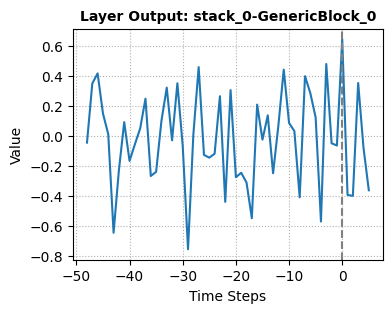

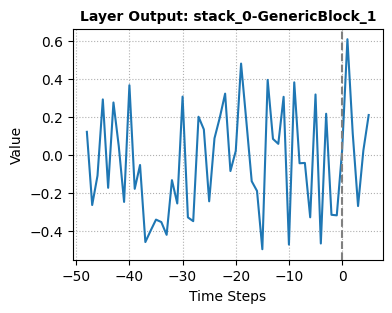

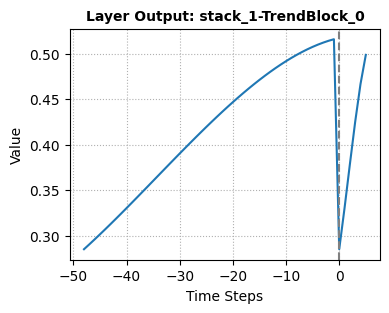

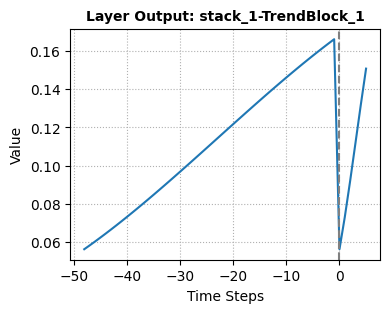

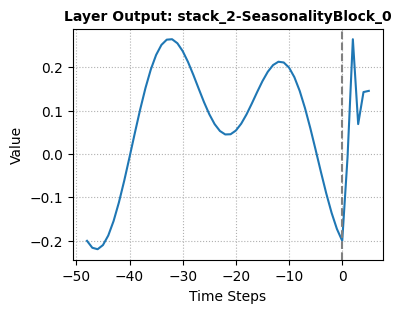

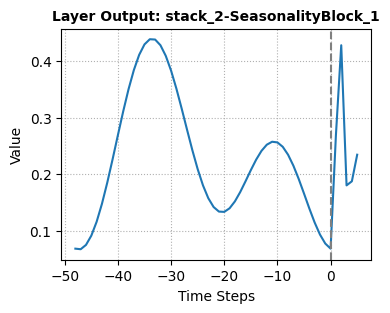

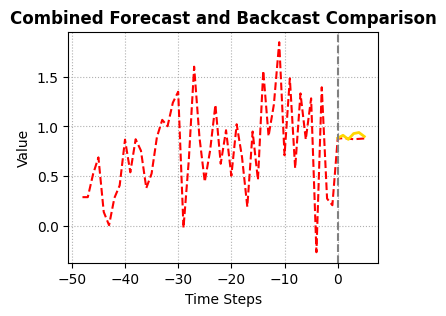

Epoch = 201, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 202, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 203, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 204, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 205, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 206, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 207, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 208, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 209, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 210, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 211, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 212, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 213, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 214, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 215, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 216, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 217, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 218, Train Loss = 0.0015, Test Loss = 0.0014
Epoch = 219, Train Loss = 0.0015, Test Loss = 

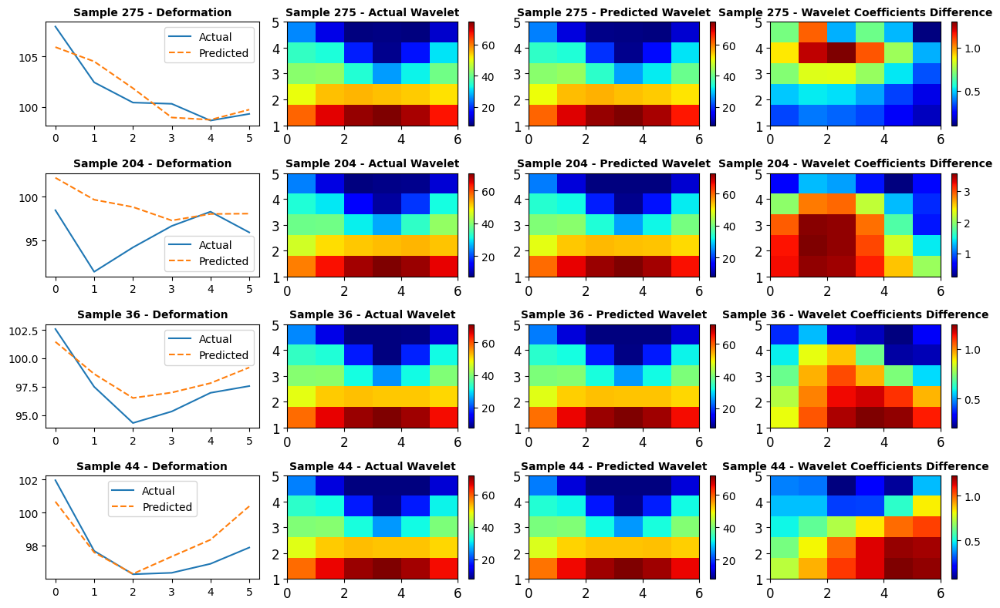

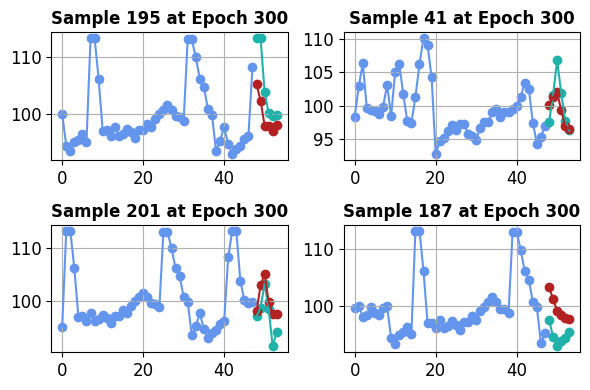

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-3.71051878e-02,  3.40424538e-01,  4.11220819e-01,  1.41014040e-01,
       -6.43104035e-03, -6.24476075e-01, -2.37698838e-01,  1.08504273e-01,
       -1.56624168e-01, -5.20268679e-02,  4.23768274e-02,  2.71647096e-01,
       -2.81197160e-01, -2.33949453e-01,  1.12301059e-01,  3.16044509e-01,
       -2.68065371e-04,  3.61827314e-01, -7.61112496e-02, -7.16385365e-01,
        3.77336182e-02,  4.62057024e-01, -1.18311003e-01, -1.16761729e-01,
       -8.58673006e-02,  2.92332321e-01, -4.29060698e-01,  2.95478821e-01,
       -2.58624345e-01, -2.57202089e-01, -3.17217141e-01, -5.28483033e-01,
        2.04302803e-01, -7.32811447e-03,  1.02938004e-01, -2.56072968e-01,
        5.91859370e-02,  4.45936352e-01,  8.14886838e-02,  2.82897875e-02,
       -3.86281699e-01,  3.88150603e-01,  2.73228258e-01,  1.32788926e-01,
       -5.45285523e-01,  4.74190712e-01, -2.31359005e-02, -5.23380414e-02],
      dtype=float32), 'forecast': arr

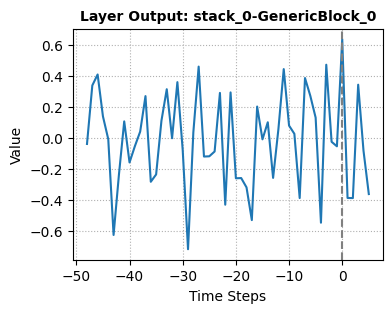

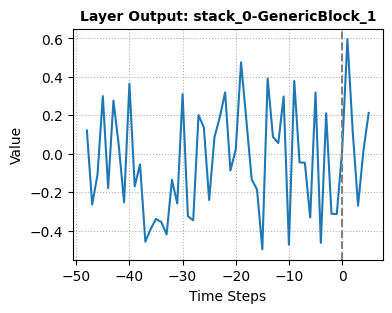

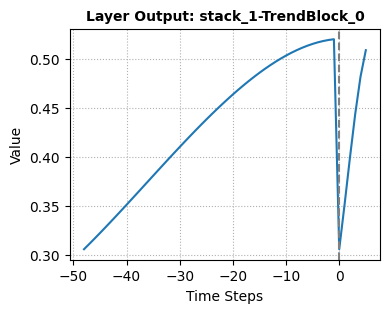

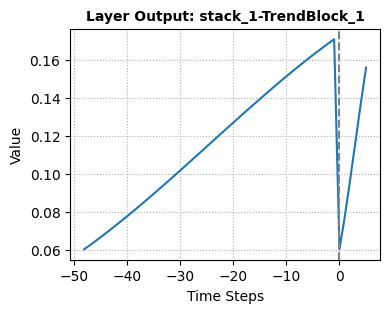

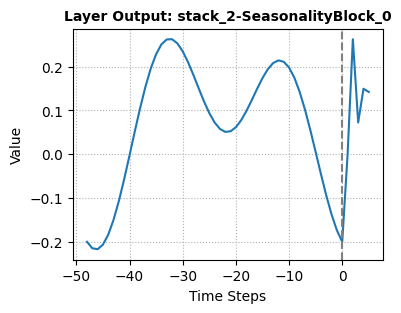

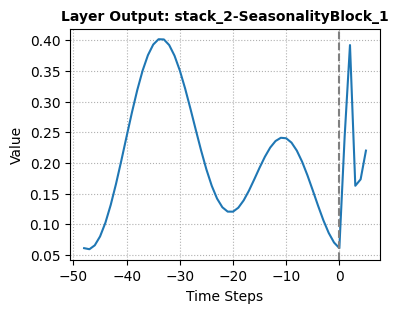

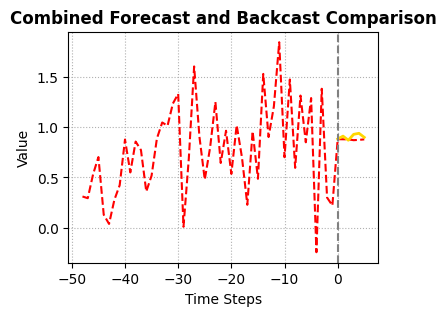

Epoch = 301, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 302, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 303, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 304, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 305, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 306, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 307, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 308, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 309, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 310, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 311, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 312, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 313, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 314, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 315, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 316, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 317, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 318, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 319, Train Loss = 0.0014, Test Loss = 

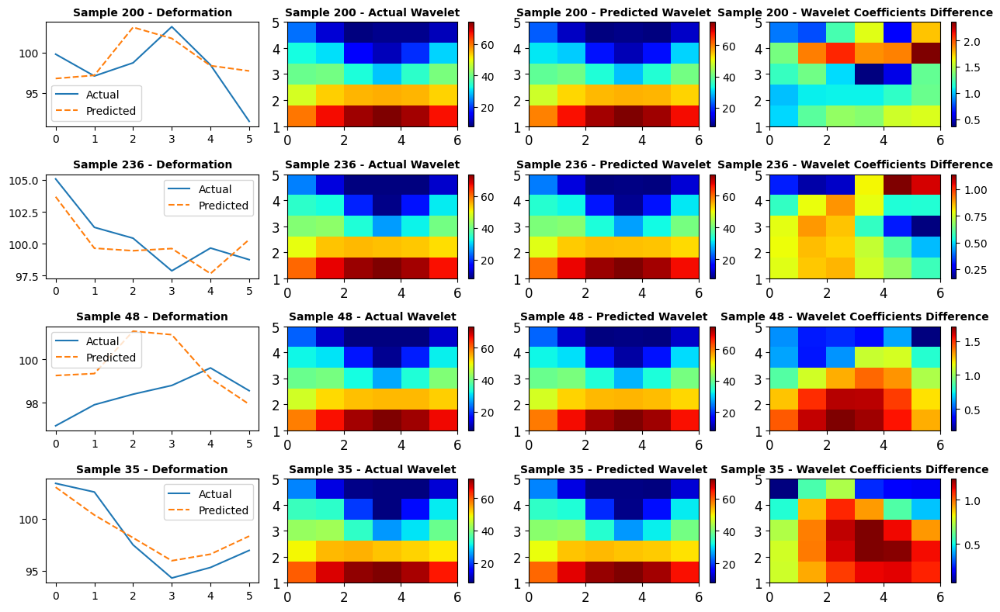

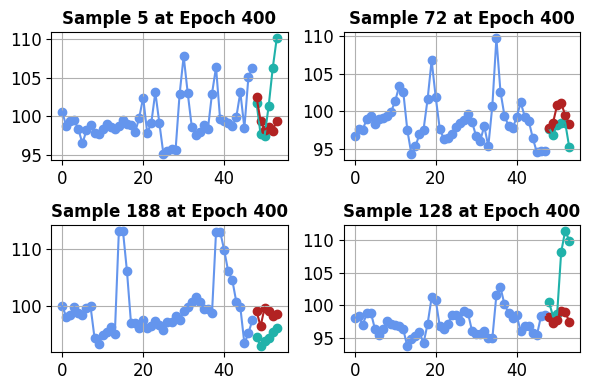

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.02817407,  0.32732475,  0.40490583,  0.12719701, -0.02718191,
       -0.6027749 , -0.25352576,  0.12516728, -0.14605585, -0.04942525,
        0.03316228,  0.29388732, -0.29763672, -0.23068888,  0.12222832,
        0.30676398,  0.03009163,  0.37446058, -0.09067549, -0.6762169 ,
        0.07065531,  0.46638155, -0.11124387, -0.09026517, -0.04968457,
        0.32195055, -0.41833198,  0.2829119 , -0.24162968, -0.27091393,
       -0.32633325, -0.5085947 ,  0.19663033,  0.00828023,  0.06322413,
       -0.26827052,  0.04338278,  0.4499216 ,  0.07321984,  0.02470086,
       -0.3625231 ,  0.37377486,  0.25708508,  0.14059123, -0.5209649 ,
        0.46632215,  0.00300685, -0.04036348], dtype=float32), 'forecast': array([ 0.63398117, -0.381446  , -0.37217048,  0.3324394 , -0.08215248,
       -0.35746494], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.12387531, -0.2638125 , -0.10709734,  0.31106302, -0.1862

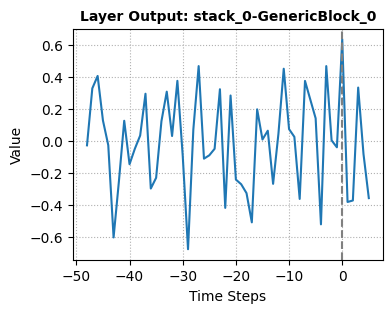

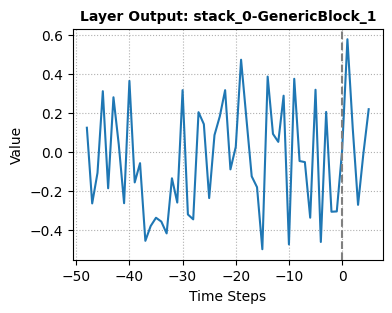

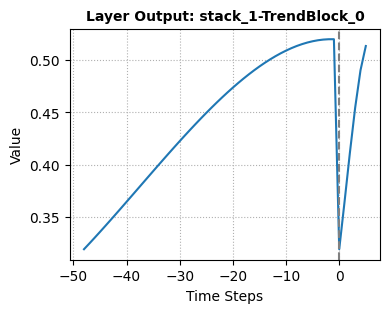

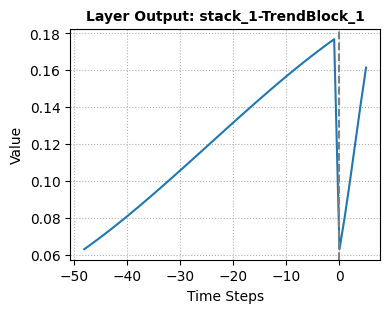

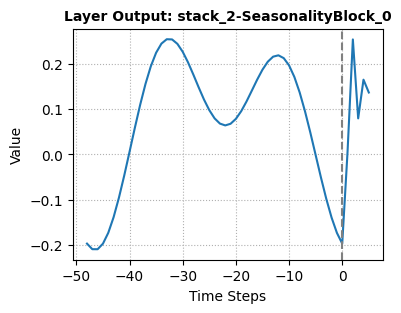

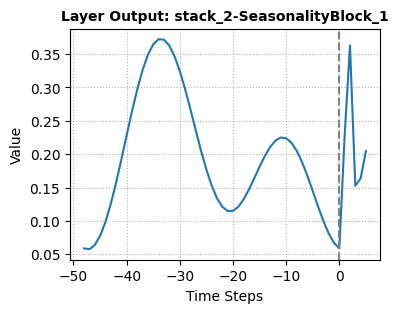

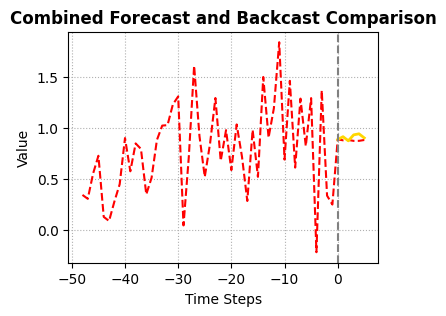

Epoch = 401, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 402, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 403, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 404, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 405, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 406, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 407, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 408, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 409, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 410, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 411, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 412, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 413, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 414, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 415, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 416, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 417, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 418, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 419, Train Loss = 0.0014, Test Loss = 

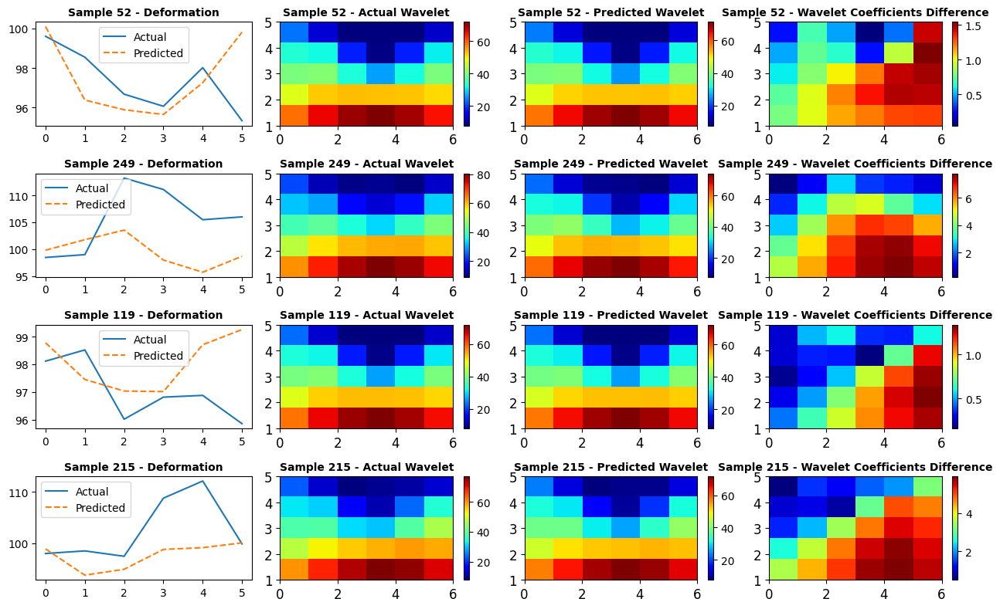

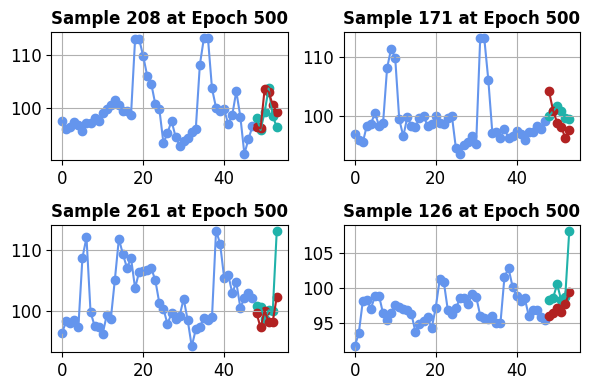

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.02056325,  0.3170466 ,  0.40112886,  0.11616375, -0.04277521,
       -0.58527195, -0.26672426,  0.14082707, -0.13785511, -0.04657575,
        0.02613314,  0.31256855, -0.30884352, -0.22689632,  0.12932879,
        0.29931328,  0.05451902,  0.38491625, -0.10247137, -0.64436173,
        0.09851206,  0.47025356, -0.10551884, -0.0699951 , -0.02071443,
        0.34503222, -0.4082986 ,  0.27315313, -0.22759552, -0.28036502,
       -0.33124986, -0.49218664,  0.191241  ,  0.02006039,  0.03234541,
       -0.27883664,  0.03073819,  0.45441347,  0.06732725,  0.02333395,
       -0.34344602,  0.36184773,  0.24508445,  0.14701022, -0.5017129 ,
        0.45963272,  0.02662896, -0.03058516], dtype=float32), 'forecast': array([ 0.6325997 , -0.3790662 , -0.36218625,  0.32481825, -0.08109827,
       -0.35631302], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.12468527, -0.26205105, -0.10446589,  0.3243161 , -0.1958

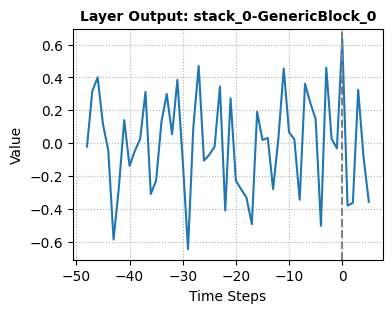

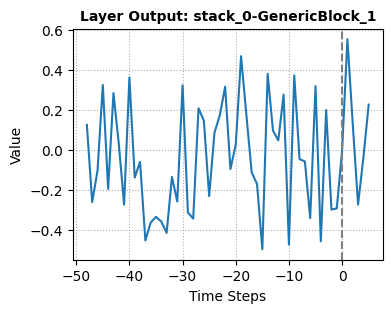

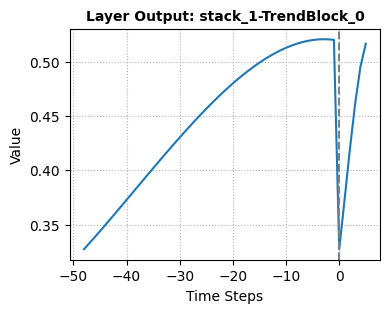

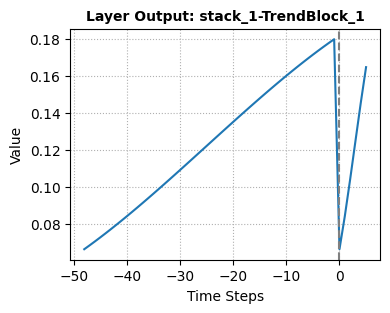

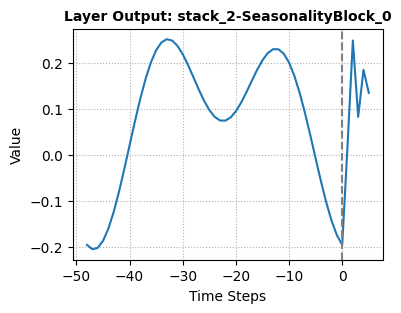

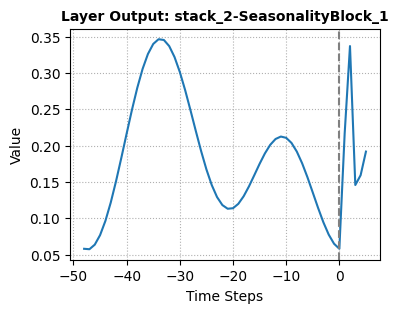

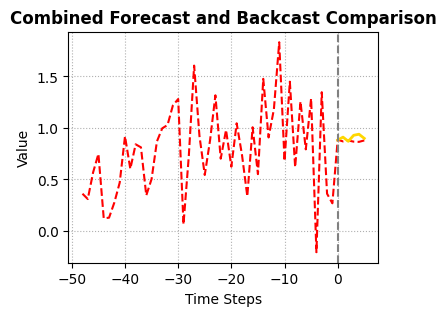

Epoch = 501, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 502, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 503, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 504, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 505, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 506, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 507, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 508, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 509, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 510, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 511, Train Loss = 0.0014, Test Loss = 0.0014
Epoch = 512, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 513, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 514, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 515, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 516, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 517, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 518, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 519, Train Loss = 0.0013, Test Loss = 

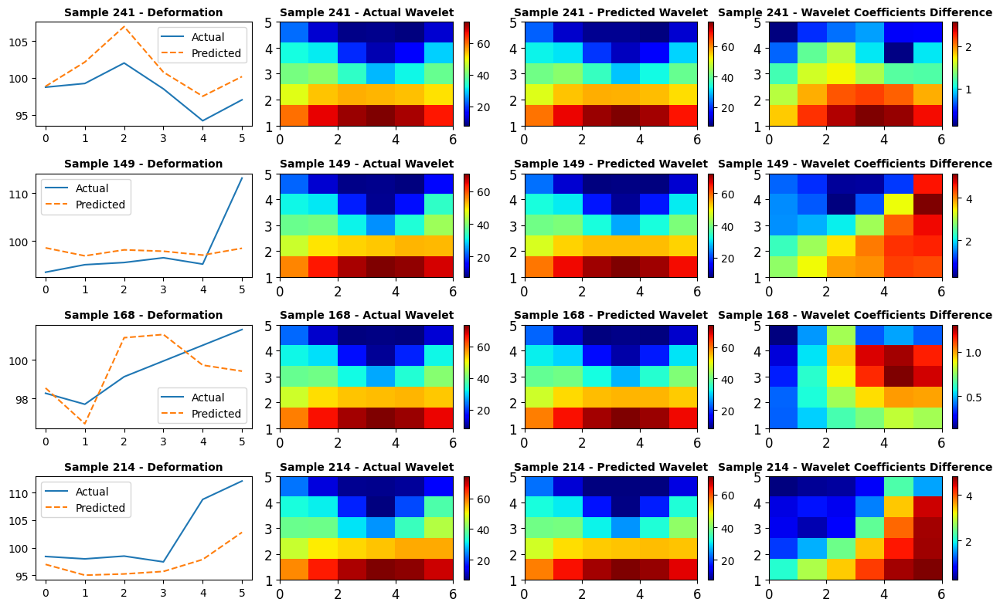

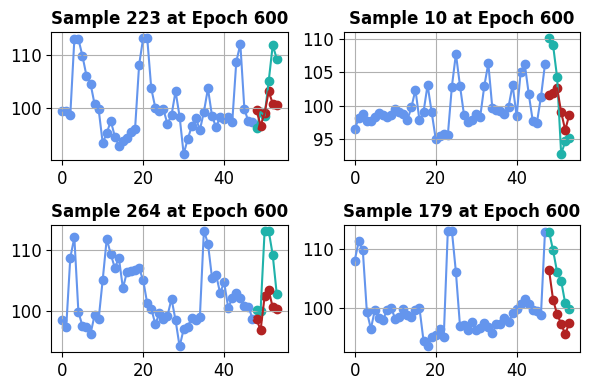

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.01435207,  0.3108813 ,  0.39634314,  0.11247513, -0.0540506 ,
       -0.57006884, -0.27600545,  0.15750015, -0.13504022, -0.04509336,
        0.01744916,  0.32905295, -0.31827837, -0.22343867,  0.13572608,
        0.2948808 ,  0.0765959 ,  0.39399415, -0.11153557, -0.61719245,
        0.11749899,  0.46895307, -0.10236082, -0.05501676,  0.0027874 ,
        0.3600298 , -0.40518272,  0.26507398, -0.21661533, -0.283655  ,
       -0.33052024, -0.47984248,  0.19004105,  0.0316577 ,  0.005205  ,
       -0.28605554,  0.02008832,  0.45682073,  0.06657925,  0.02483986,
       -0.3302673 ,  0.3552001 ,  0.23649734,  0.14958245, -0.48417914,
        0.45682842,  0.0477034 , -0.0259198 ], dtype=float32), 'forecast': array([ 0.6297411 , -0.37464127, -0.35559383,  0.3215422 , -0.07928505,
       -0.35922498], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.1236411 , -0.26019454, -0.09932407,  0.3402376 , -0.2046

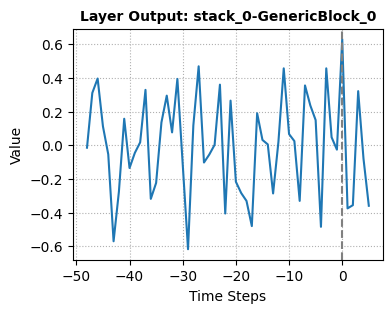

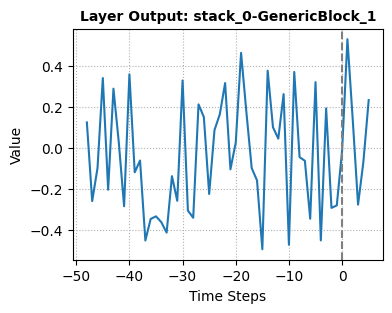

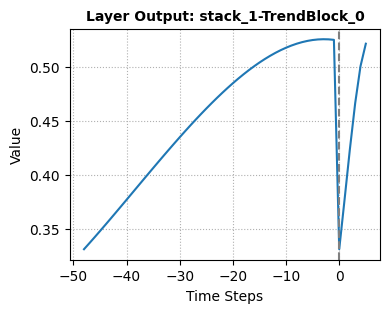

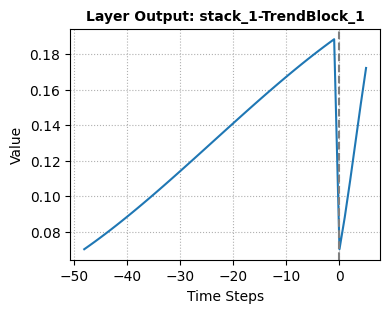

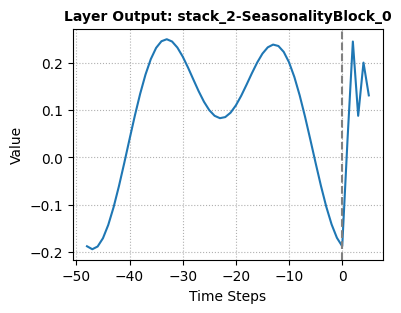

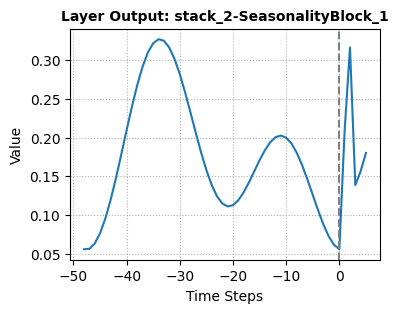

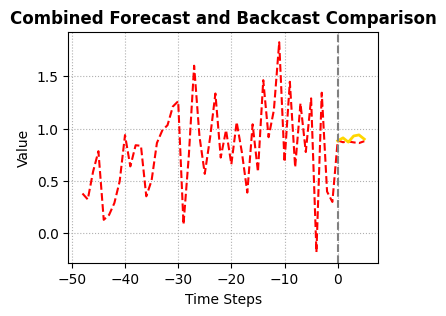

Epoch = 601, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 602, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 603, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 604, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 605, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 606, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 607, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 608, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 609, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 610, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 611, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 612, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 613, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 614, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 615, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 616, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 617, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 618, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 619, Train Loss = 0.0013, Test Loss = 

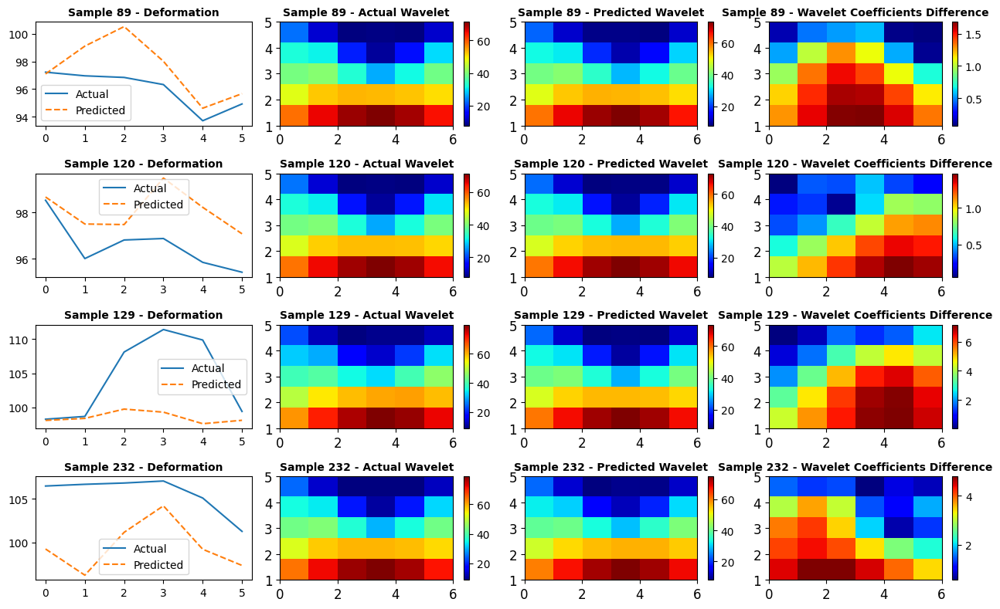

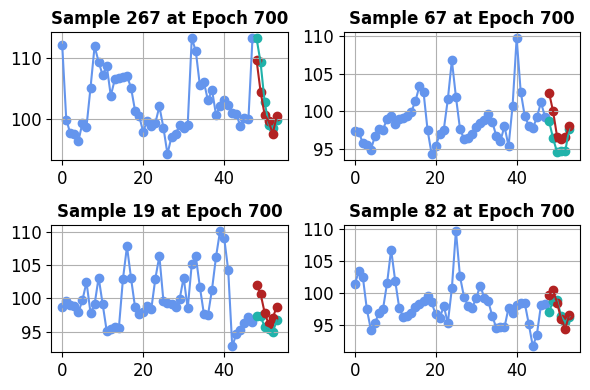

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.00953857,  0.30730745,  0.39347073,  0.11142394, -0.05893968,
       -0.5588878 , -0.28110403,  0.17202106, -0.13564478, -0.04517363,
        0.0097063 ,  0.33892557, -0.32423347, -0.21937875,  0.13968807,
        0.29265562,  0.09264424,  0.40201694, -0.11845125, -0.59686536,
        0.12934634,  0.46479738, -0.10113918, -0.04518736,  0.02045737,
        0.36616194, -0.40413344,  0.26031134, -0.20851085, -0.28264096,
       -0.3267643 , -0.47314787,  0.19109695,  0.03961643, -0.01486294,
       -0.29241496,  0.01283806,  0.4590479 ,  0.07012715,  0.02828032,
       -0.32353213,  0.35126737,  0.23168935,  0.14835076, -0.47167417,
        0.45583174,  0.06359688, -0.02523731], dtype=float32), 'forecast': array([ 0.6210698 , -0.36319178, -0.35465568,  0.3225603 , -0.07939061,
       -0.36908433], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.12164477, -0.25996736, -0.08923408,  0.3557521 , -0.2102

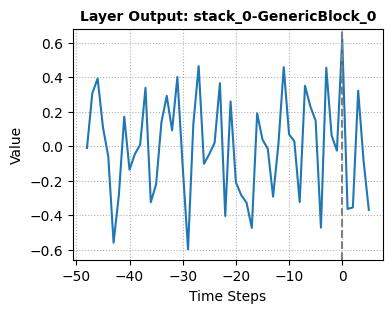

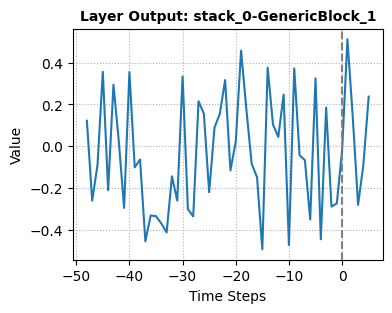

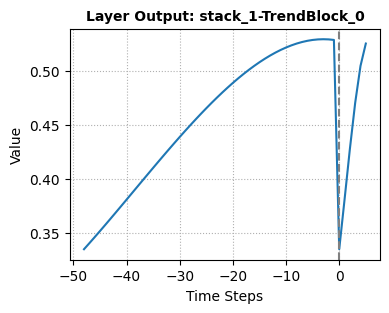

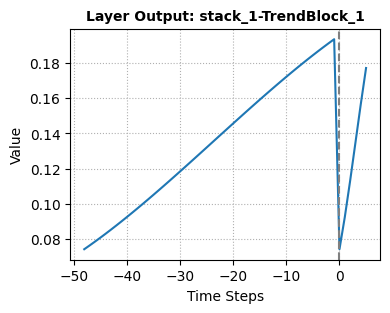

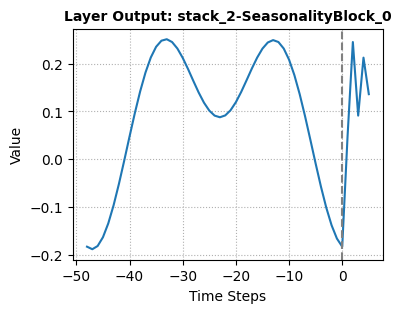

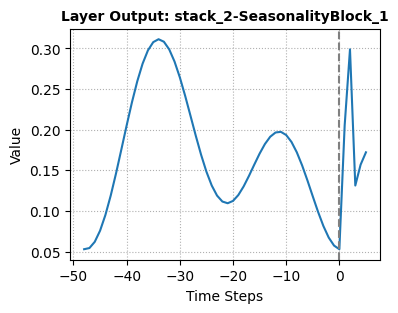

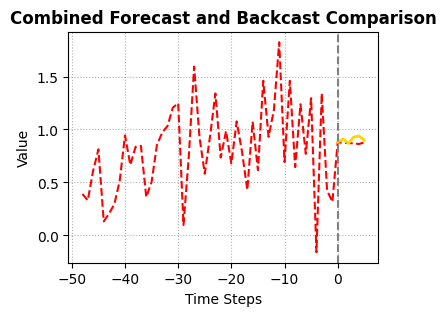

Epoch = 701, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 702, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 703, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 704, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 705, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 706, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 707, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 708, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 709, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 710, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 711, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 712, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 713, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 714, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 715, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 716, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 717, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 718, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 719, Train Loss = 0.0013, Test Loss = 

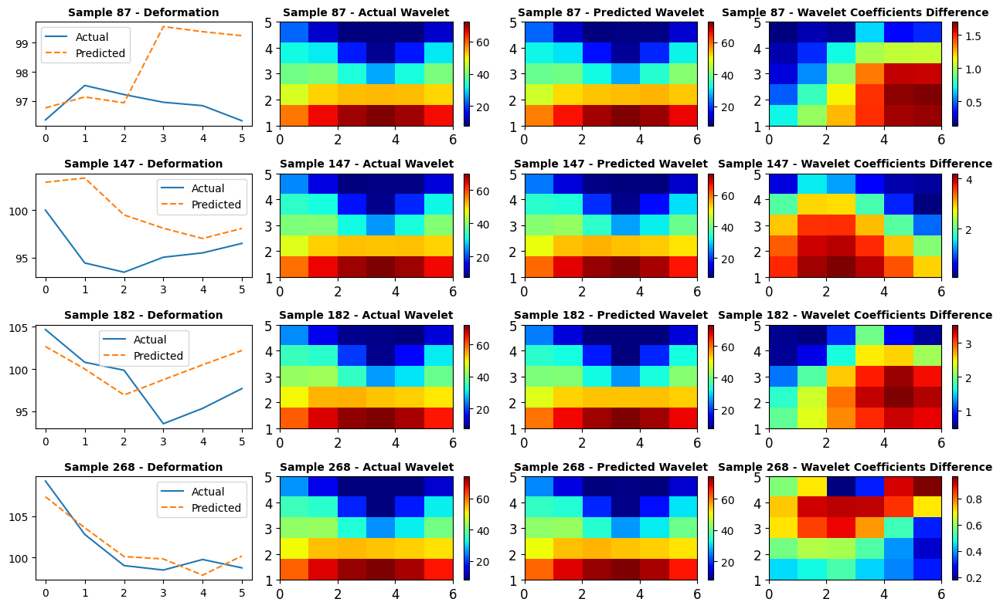

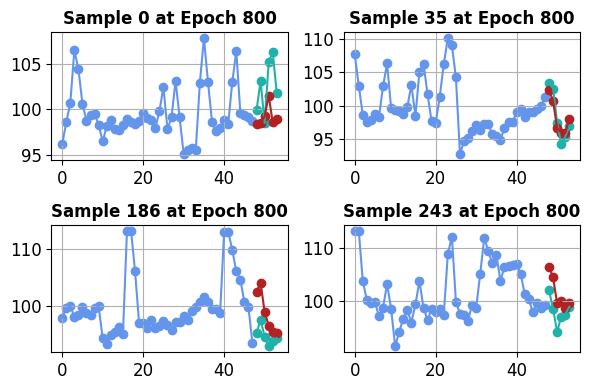

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-0.0043505 ,  0.302694  ,  0.39003518,  0.1069578 , -0.06408874,
       -0.5470087 , -0.28797325,  0.18325907, -0.13309188, -0.04464969,
        0.00415364,  0.34951767, -0.32576686, -0.21489492,  0.14407608,
        0.2897174 ,  0.10729858,  0.4086449 , -0.12532987, -0.5771469 ,
        0.14279966,  0.46458453, -0.09861481, -0.03464597,  0.03730374,
        0.37559497, -0.40007007,  0.2562731 , -0.19976723, -0.2834078 ,
       -0.32716155, -0.46455657,  0.19056307,  0.04662523, -0.03415912,
       -0.29924497,  0.00526468,  0.46280754,  0.07100375,  0.03029923,
       -0.31486276,  0.34522432,  0.22587514,  0.14927405, -0.45981917,
        0.45342728,  0.07900144, -0.0224721 ], dtype=float32), 'forecast': array([ 0.60948724, -0.3503381 , -0.3527853 ,  0.32088646, -0.08328832,
       -0.37880403], dtype=float32)}, 'stack_0-GenericBlock_1': {'backcast': array([ 0.11983919, -0.2602189 , -0.08070367,  0.36599183, -0.2125

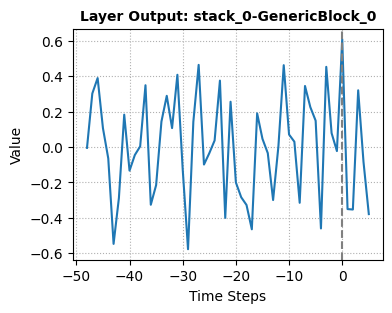

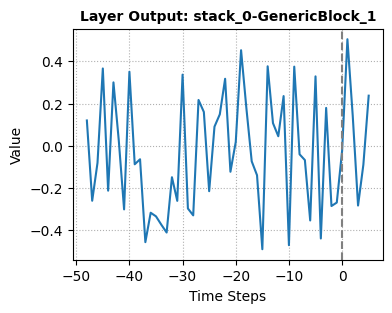

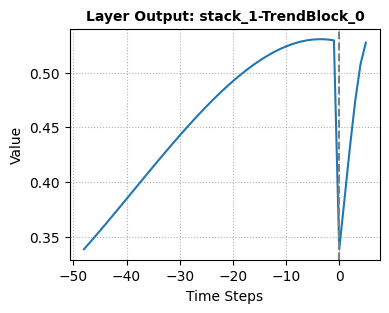

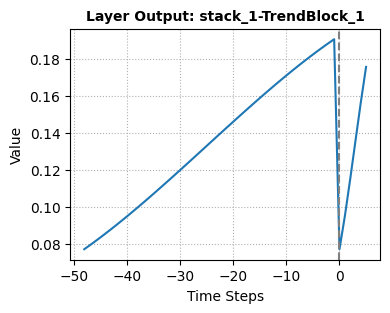

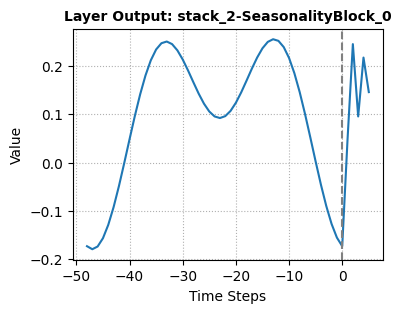

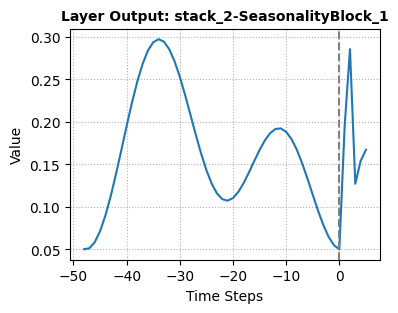

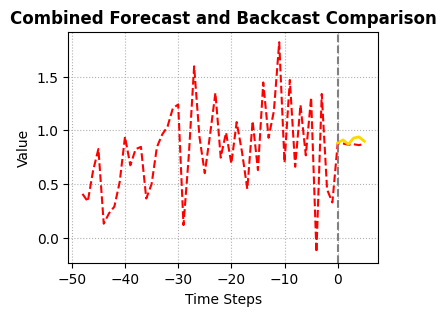

Epoch = 801, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 802, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 803, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 804, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 805, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 806, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 807, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 808, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 809, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 810, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 811, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 812, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 813, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 814, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 815, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 816, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 817, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 818, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 819, Train Loss = 0.0013, Test Loss = 

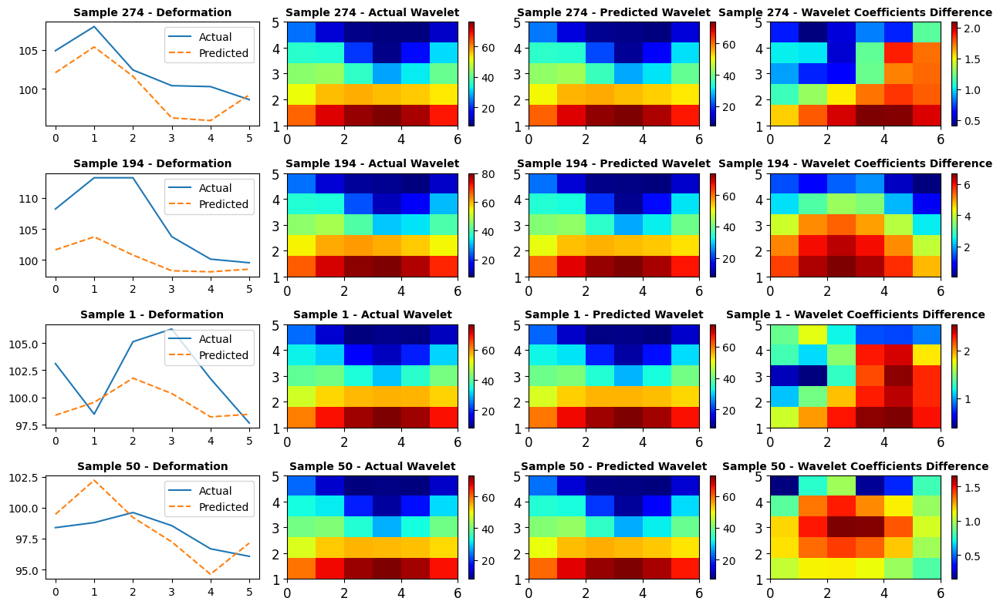

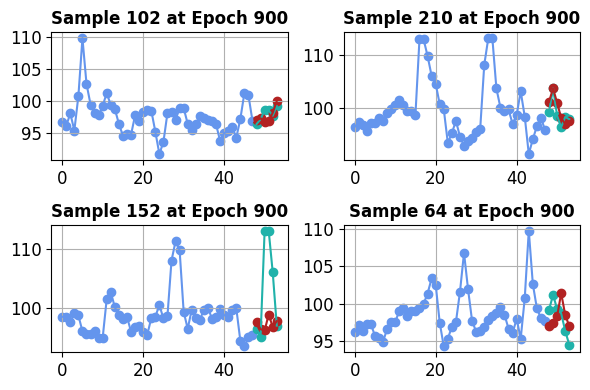

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([-2.18725676e-04,  2.98471272e-01,  3.87138873e-01,  1.02249593e-01,
       -6.65275902e-02, -5.38443685e-01, -2.92666286e-01,  1.90159127e-01,
       -1.30501360e-01, -4.46066894e-02,  7.70249404e-04,  3.57794672e-01,
       -3.25619638e-01, -2.10385621e-01,  1.46026224e-01,  2.87276804e-01,
        1.17789514e-01,  4.13541913e-01, -1.30989164e-01, -5.62237442e-01,
        1.53206140e-01,  4.65518951e-01, -9.64810625e-02, -2.52185334e-02,
        4.96505946e-02,  3.82741362e-01, -3.94812703e-01,  2.55565226e-01,
       -1.91795290e-01, -2.83757180e-01, -3.28085750e-01, -4.57988322e-01,
        1.89780489e-01,  5.07128015e-02, -4.83299643e-02, -3.05445135e-01,
       -2.36081876e-04,  4.67299700e-01,  7.26711974e-02,  3.17995623e-02,
       -3.08715641e-01,  3.39208335e-01,  2.21807018e-01,  1.50782958e-01,
       -4.51126188e-01,  4.51005131e-01,  8.82931352e-02, -2.02540010e-02],
      dtype=float32), 'forecast': arr

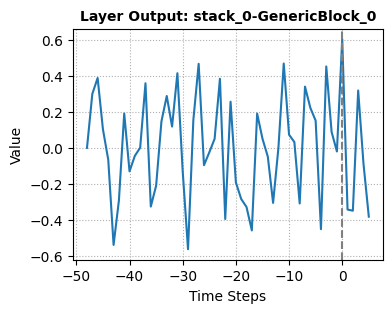

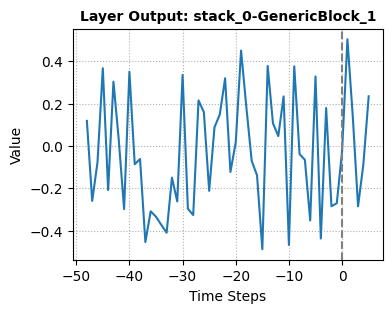

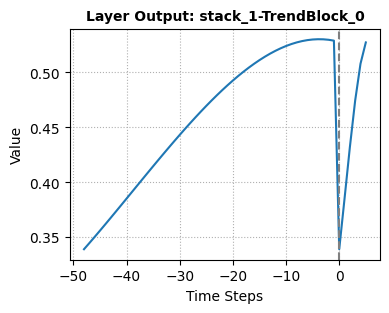

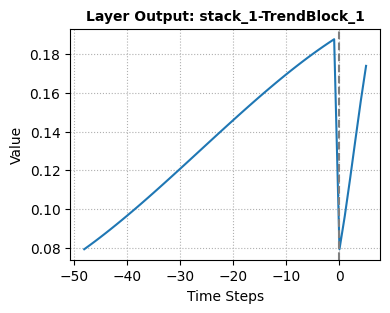

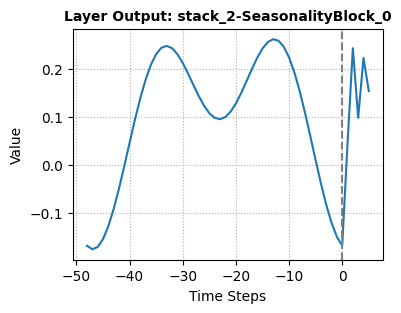

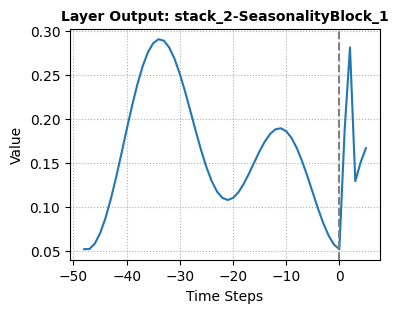

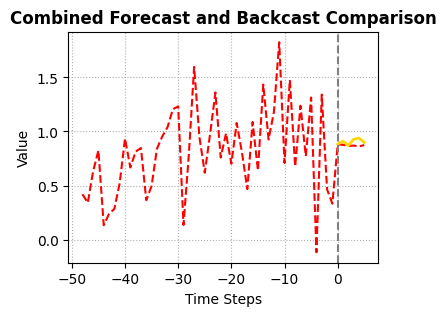

Epoch = 901, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 902, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 903, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 904, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 905, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 906, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 907, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 908, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 909, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 910, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 911, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 912, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 913, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 914, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 915, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 916, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 917, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 918, Train Loss = 0.0012, Test Loss = 0.0015
Epoch = 919, Train Loss = 0.0012, Test Loss = 

In [54]:
save_dir = 'plots_K3_3B1_48'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

From the results at site K1_3B4, both the observed and predicted values, as well as the wavelet analysis of these values, show a high degree of consistency.

In [55]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from math import sqrt


net.eval()
with torch.no_grad():

    _,predicted_test = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    predicted_test = predicted_test.detach().cpu().numpy() * norm_constant
    y_test_actual = y_test * norm_constant

    rmse = sqrt(mean_squared_error(y_test_actual, predicted_test))
    mae = mean_absolute_error(y_test_actual, predicted_test)

print(f"Test RMSE: {rmse}")
print(f"Test MAE: {mae}")

Test RMSE: 4.460692655889744
Test MAE: 3.0831289522176673


# Neural Network-Based Feature Extraction for Deformation Observations in the K3_3B1 (Input length: 60)

In [56]:
data_K3_3B1 = data[data.Station_id=='K3_3B1'][['Vertical displacement(mm)']]
data_K3_3B1

,Vertical displacement(mm)
date,
2022-02-02 00:00:00,78.735333
2022-02-02 03:00:00,76.416000
2022-02-02 06:00:00,79.454222
2022-02-02 09:00:00,76.285593
2022-02-02 12:00:00,79.687600
...,...
2022-08-01 09:00:00,99.295571
2022-08-01 12:00:00,99.256889
2022-08-01 15:00:00,112.854000


In [57]:
forecast_length = 6
backcast_length = 10 * forecast_length
batch_size = 32  # greater than 4 for viz

data_K3_3B1 = data_K3_3B1.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_K3_3B1) - forecast_length):
    x.append(data_K3_3B1[epoch - backcast_length:epoch])
    y.append(data_K3_3B1[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=60, forecast_length=6, share_thetas=False) at @138464852523904
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=60, forecast_length=6, share_thetas=False) at @138465182974928
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=60, forecast_length=6, share_thetas=True) at @138465182979872
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=60, forecast_length=6, share_thetas=True) at @138465182980544
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=60, forecast_length=6, share_thetas=True) at @138465182984816
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=60, forecast_length=6, share_thetas=True) at @138465182983088


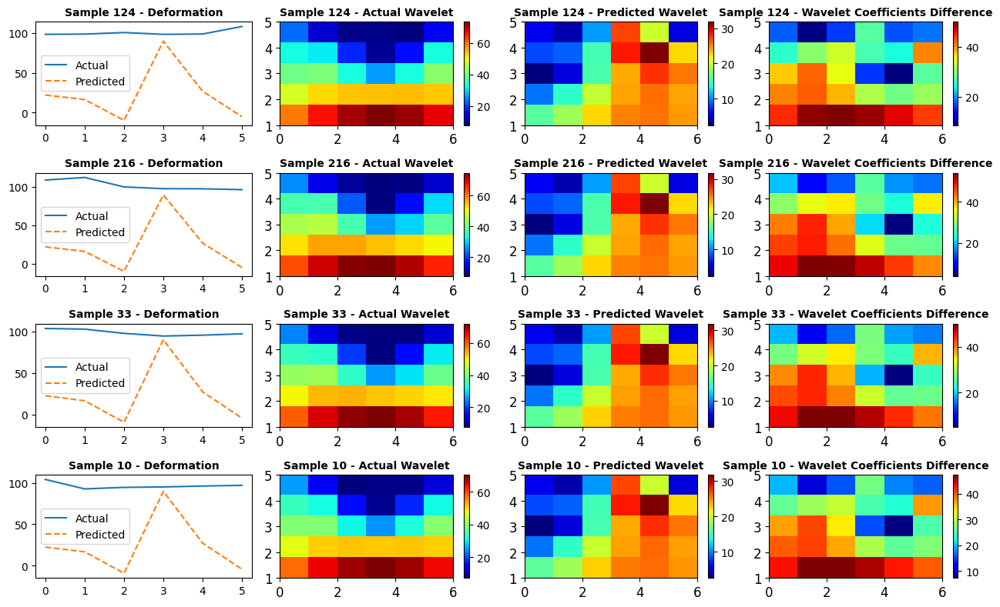

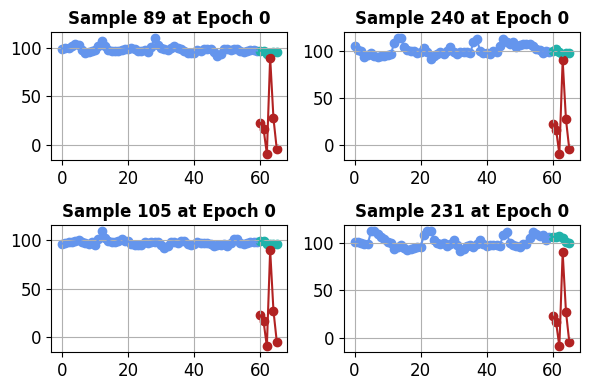

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.08576994,  0.30729052, -0.33369914, -0.42021748,  0.21439941,
        0.20803455, -0.400116  ,  0.04098772, -0.27951694, -0.17598526,
        0.12343008, -0.14681302,  0.08940195, -0.09608246, -0.39948398,
       -0.45280203,  0.33418676,  0.34963205, -0.11957832,  0.41329402,
       -0.48296696,  0.45162737,  0.4592066 ,  0.41087943,  0.36385357,
       -0.4528062 , -0.33707678, -0.1658624 ,  0.33484954,  0.05362125,
        0.42238253, -0.24742429, -0.24536885,  0.13496904,  0.39938194,
       -0.4191082 , -0.15454493, -0.40784612, -0.41297495,  0.17343134,
       -0.0893121 , -0.28241578,  0.28967524, -0.15458766, -0.4234952 ,
       -0.17394975,  0.15951845, -0.0277204 ,  0.34194398, -0.15230657,
       -0.05496928, -0.4091502 ,  0.3792962 , -0.02814921,  0.377172  ,
        0.01997204, -0.40068552, -0.36584705, -0.19312905,  0.38323167],
      dtype=float32), 'forecast': array([ 0.05316336,  0.05353709,  0.327

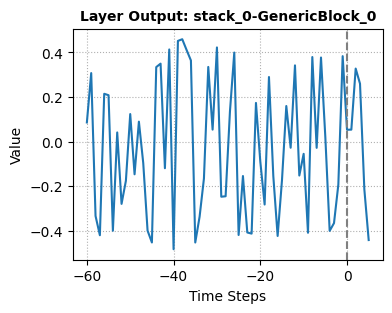

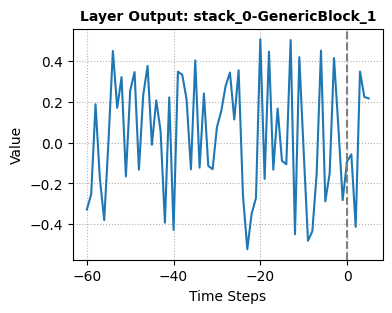

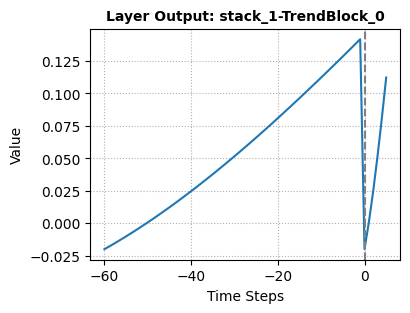

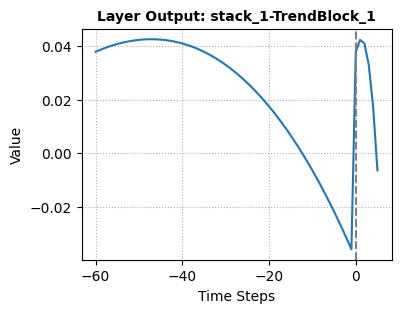

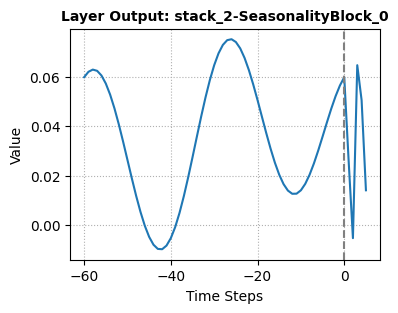

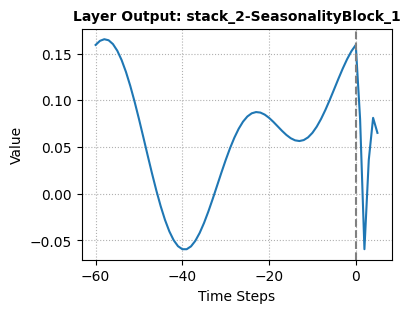

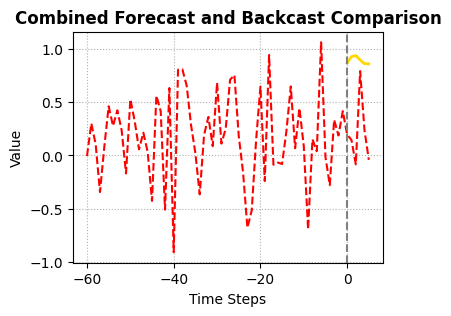

Epoch = 1, Train Loss = 0.6186, Test Loss = 0.5364
Epoch = 2, Train Loss = 0.3545, Test Loss = 0.3021
Epoch = 3, Train Loss = 0.1849, Test Loss = 0.1465
Epoch = 4, Train Loss = 0.0809, Test Loss = 0.0577
Epoch = 5, Train Loss = 0.0306, Test Loss = 0.0183
Epoch = 6, Train Loss = 0.0124, Test Loss = 0.0062
Epoch = 7, Train Loss = 0.0064, Test Loss = 0.0029
Epoch = 8, Train Loss = 0.0045, Test Loss = 0.0023
Epoch = 9, Train Loss = 0.0040, Test Loss = 0.0021
Epoch = 10, Train Loss = 0.0039, Test Loss = 0.0021
Epoch = 11, Train Loss = 0.0038, Test Loss = 0.0021
Epoch = 12, Train Loss = 0.0038, Test Loss = 0.0021
Epoch = 13, Train Loss = 0.0038, Test Loss = 0.0021
Epoch = 14, Train Loss = 0.0037, Test Loss = 0.0020
Epoch = 15, Train Loss = 0.0037, Test Loss = 0.0020
Epoch = 16, Train Loss = 0.0037, Test Loss = 0.0020
Epoch = 17, Train Loss = 0.0037, Test Loss = 0.0020
Epoch = 18, Train Loss = 0.0037, Test Loss = 0.0020
Epoch = 19, Train Loss = 0.0037, Test Loss = 0.0020
Epoch = 20, Train Los

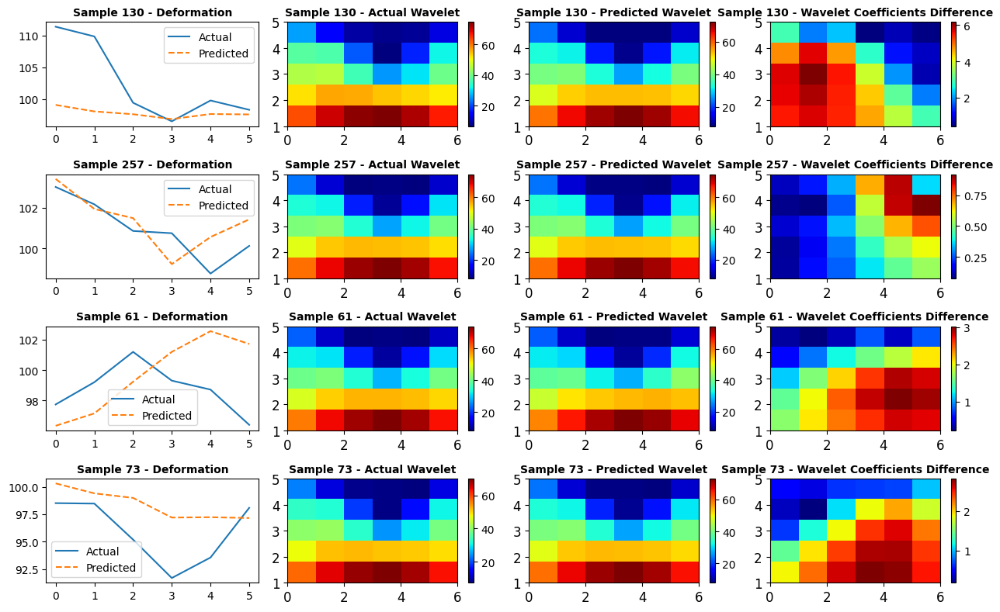

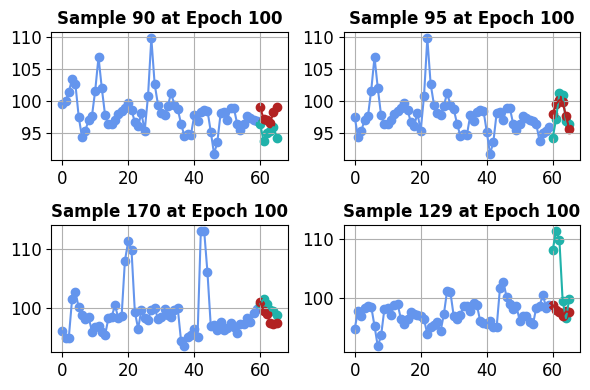

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.01186581,  0.30529562, -0.31645083, -0.36088702,  0.29665923,
        0.16054481, -0.40446514, -0.02466558, -0.275826  , -0.14769101,
        0.12151673, -0.17628008,  0.12751566, -0.12451048, -0.42260656,
       -0.49744943,  0.24564378,  0.3642461 , -0.20517956,  0.45553613,
       -0.50002205,  0.38239783,  0.4277146 ,  0.45907566,  0.44121015,
       -0.44507217, -0.3183717 , -0.20549221,  0.3785974 ,  0.02418965,
        0.37133977, -0.26684108, -0.18142033,  0.09109517,  0.29035568,
       -0.42238638, -0.20230511, -0.36607435, -0.4862515 ,  0.13350557,
       -0.04575167, -0.35824168,  0.306829  , -0.09853172, -0.43230423,
       -0.20295618,  0.24543613, -0.07891075,  0.34823337, -0.22625433,
       -0.06751973, -0.43537086,  0.37914997, -0.03156061,  0.36631545,
       -0.04327539, -0.44123137, -0.3357656 , -0.21628714,  0.37298885],
      dtype=float32), 'forecast': array([ 0.17815846,  0.11630148,  0.470

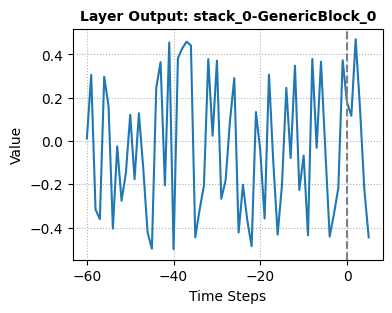

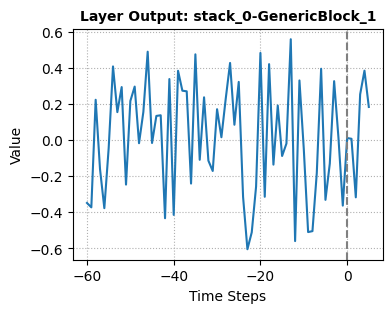

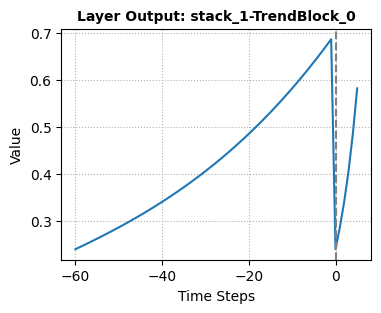

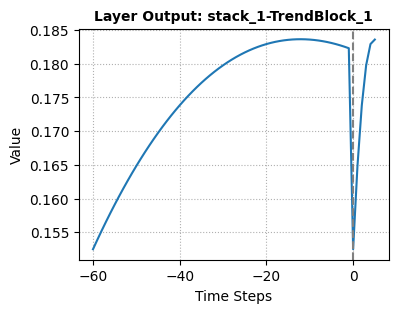

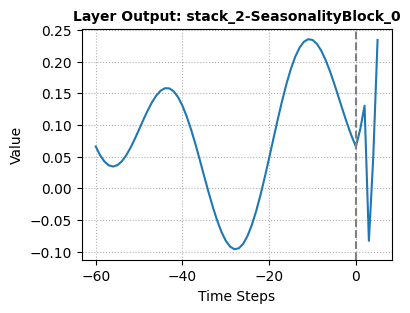

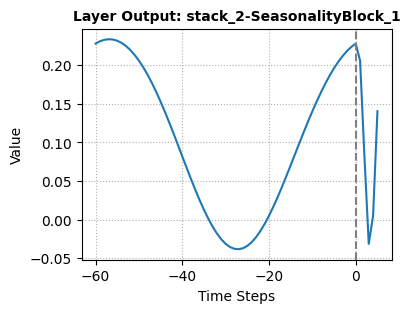

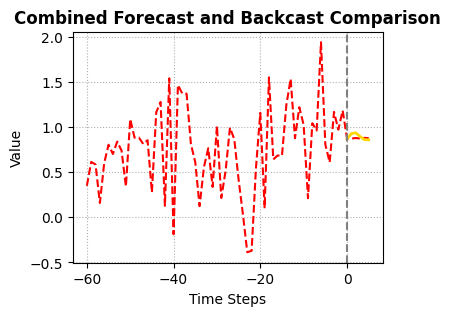

Epoch = 101, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 102, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 103, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 104, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 105, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 106, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 107, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 108, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 109, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 110, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 111, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 112, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 113, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 114, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 115, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 116, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 117, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 118, Train Loss = 0.0018, Test Loss = 0.0014
Epoch = 119, Train Loss = 0.0017, Test Loss = 

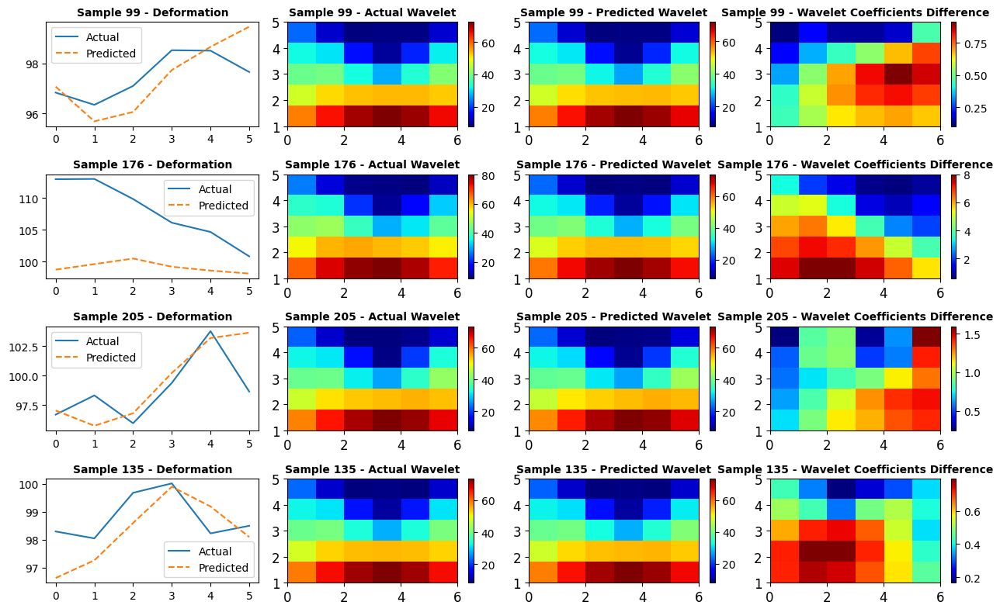

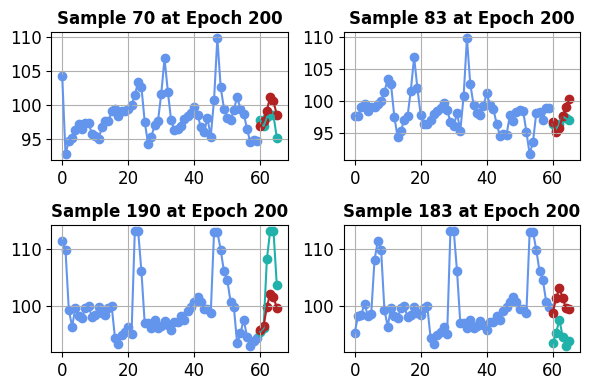

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.02789635,  0.3084067 , -0.31957045, -0.3734104 ,  0.28081995,
        0.16815785, -0.39882582, -0.01177547, -0.27625445, -0.15227418,
        0.12451031, -0.177538  ,  0.11476842, -0.12061151, -0.41610658,
       -0.48941344,  0.26080576,  0.35898992, -0.18034433,  0.44901025,
       -0.4964519 ,  0.39516827,  0.43196017,  0.4517836 ,  0.42258564,
       -0.43992427, -0.32431996, -0.18878296,  0.37772983,  0.02691173,
        0.38622153, -0.26477182, -0.19637616,  0.1015795 ,  0.31586257,
       -0.4203389 , -0.19412059, -0.37302816, -0.4670983 ,  0.14246686,
       -0.05470478, -0.3359495 ,  0.29640242, -0.11455458, -0.43365294,
       -0.19910812,  0.22554988, -0.0643384 ,  0.3457786 , -0.20946072,
       -0.06069558, -0.42708144,  0.37586725, -0.03281082,  0.3673727 ,
       -0.02775005, -0.43212938, -0.34072363, -0.21079944,  0.3741079 ],
      dtype=float32), 'forecast': array([ 0.16202374,  0.11012757,  0.452

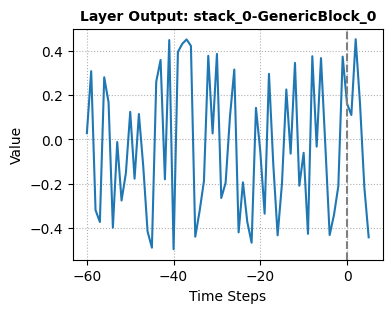

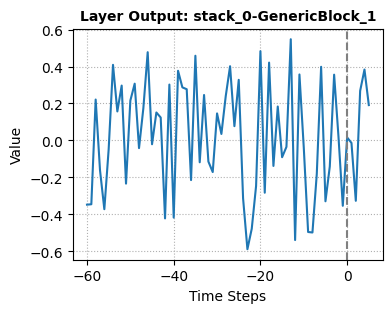

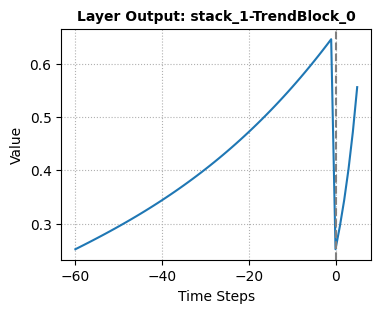

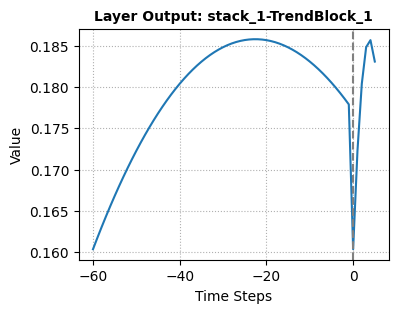

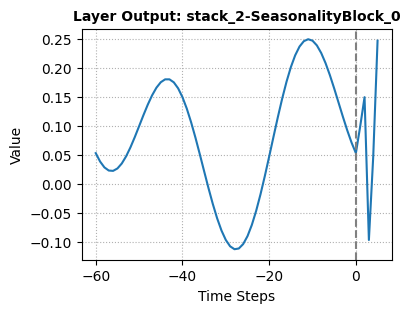

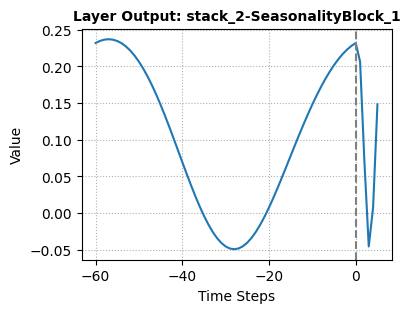

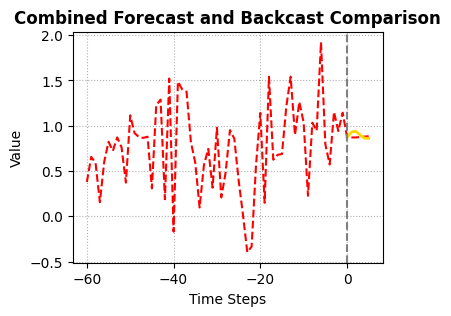

Epoch = 201, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 202, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 203, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 204, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 205, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 206, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 207, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 208, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 209, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 210, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 211, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 212, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 213, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 214, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 215, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 216, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 217, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 218, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 219, Train Loss = 0.0015, Test Loss = 

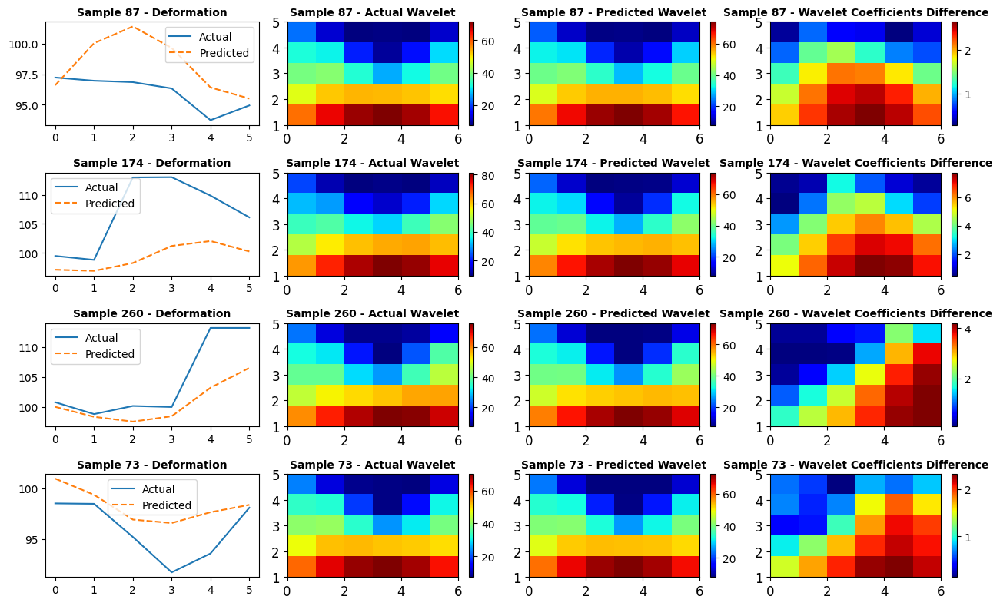

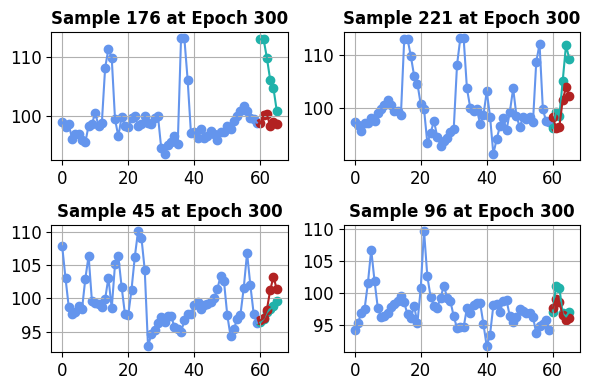

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.03636417,  0.3128674 , -0.31615794, -0.37794805,  0.27618486,
        0.17136312, -0.393226  , -0.00512157, -0.2754204 , -0.1516138 ,
        0.12931052, -0.1796094 ,  0.10820474, -0.12028661, -0.41258538,
       -0.48504144,  0.2653596 ,  0.3589075 , -0.16323225,  0.4467295 ,
       -0.49167818,  0.3991925 ,  0.4302596 ,  0.4474836 ,  0.4142914 ,
       -0.4341011 , -0.32688573, -0.18462135,  0.3796358 ,  0.02473257,
        0.39298397, -0.26732948, -0.20009334,  0.10782694,  0.32558322,
       -0.41974577, -0.1926178 , -0.37221837, -0.45748985,  0.1467888 ,
       -0.05759911, -0.32496366,  0.28544682, -0.12048101, -0.43780825,
       -0.1985943 ,  0.21547303, -0.05803316,  0.340342  , -0.20245114,
       -0.05660894, -0.42029175,  0.37265056, -0.0315985 ,  0.36910716,
       -0.01843893, -0.4257406 , -0.34273478, -0.2057249 ,  0.37415493],
      dtype=float32), 'forecast': array([ 0.15731351,  0.10991362,  0.443

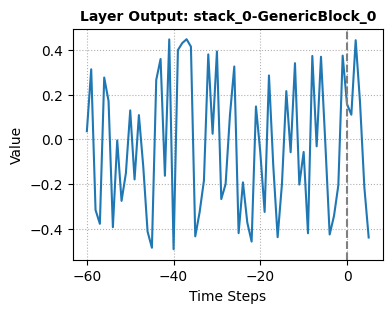

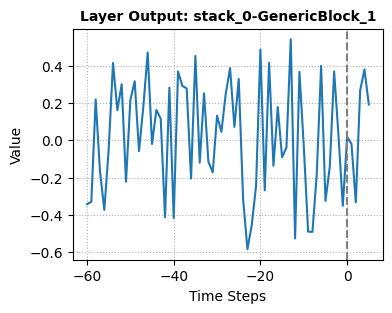

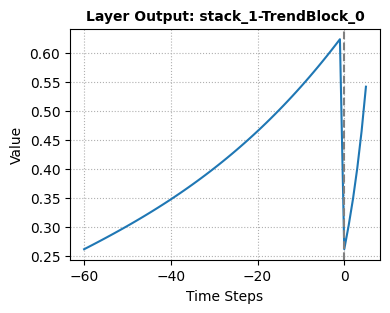

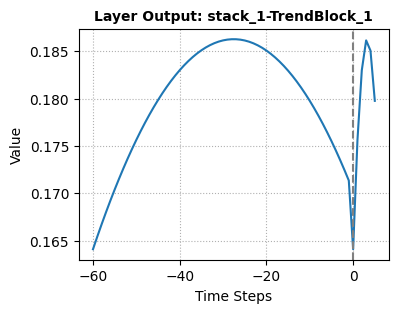

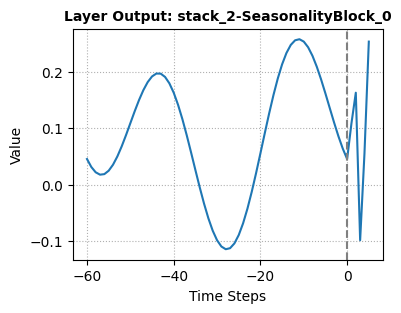

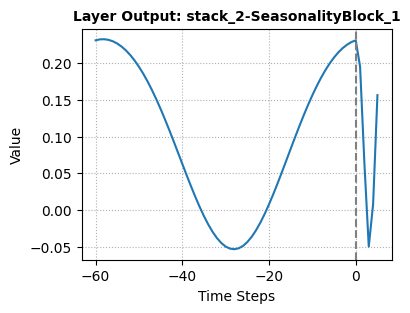

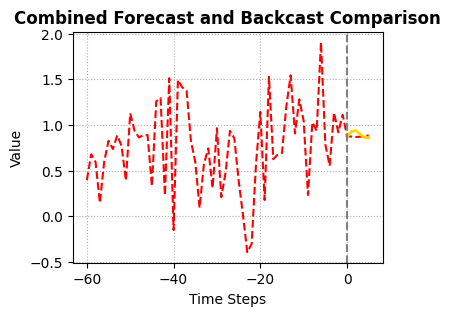

Epoch = 301, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 302, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 303, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 304, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 305, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 306, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 307, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 308, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 309, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 310, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 311, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 312, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 313, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 314, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 315, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 316, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 317, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 318, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 319, Train Loss = 0.0014, Test Loss = 

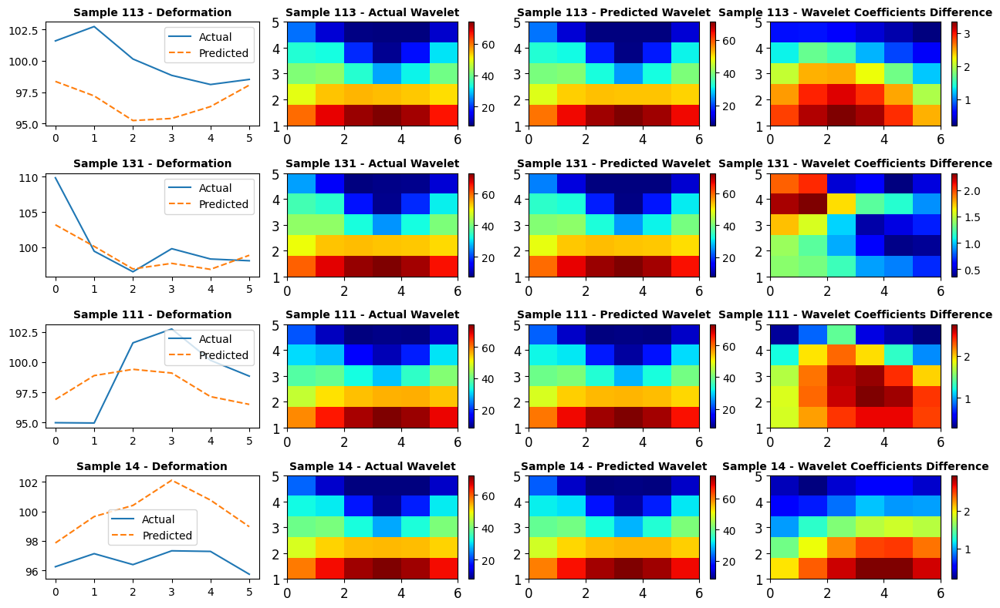

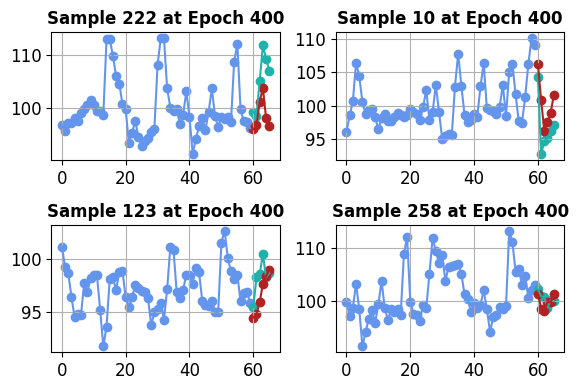

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 4.29799445e-02,  3.17525446e-01, -3.08392346e-01, -3.80604506e-01,
        2.73785084e-01,  1.74209550e-01, -3.88511389e-01,  2.94565019e-04,
       -2.75445104e-01, -1.47998005e-01,  1.33752048e-01, -1.80133820e-01,
        1.04815915e-01, -1.21433273e-01, -4.09140617e-01, -4.79986578e-01,
        2.66941309e-01,  3.61998349e-01, -1.48198366e-01,  4.43469673e-01,
       -4.84391809e-01,  4.02699798e-01,  4.26093012e-01,  4.43297952e-01,
        4.10629809e-01, -4.30311888e-01, -3.26627344e-01, -1.85185179e-01,
        3.80659282e-01,  2.12483872e-02,  3.96296531e-01, -2.72493213e-01,
       -1.99794725e-01,  1.11435369e-01,  3.30131352e-01, -4.18617576e-01,
       -1.93662971e-01, -3.69410932e-01, -4.52684551e-01,  1.49872959e-01,
       -5.80961369e-02, -3.18025023e-01,  2.76122302e-01, -1.23576611e-01,
       -4.43782210e-01, -1.97678030e-01,  2.09160596e-01, -5.56099378e-02,
        3.35126668e-01, -1.97805509e-0

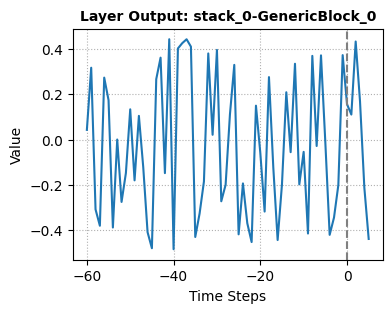

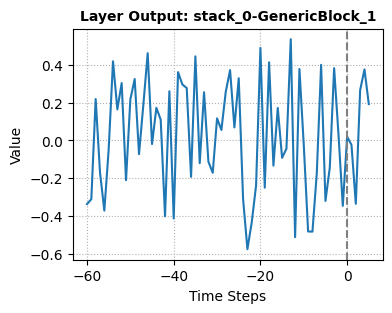

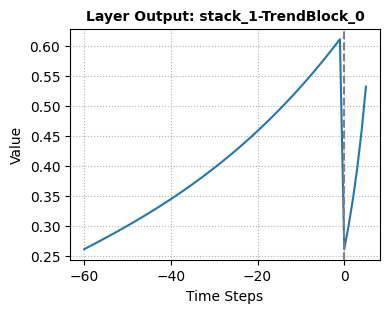

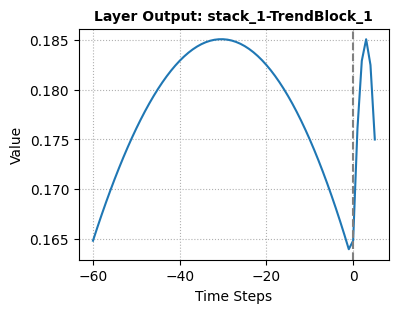

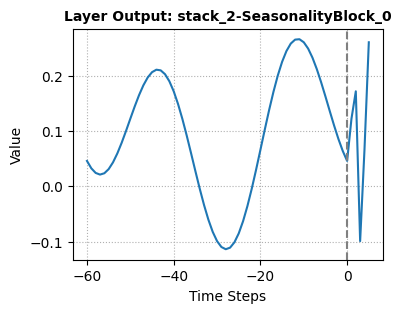

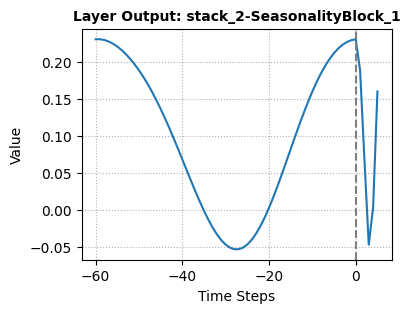

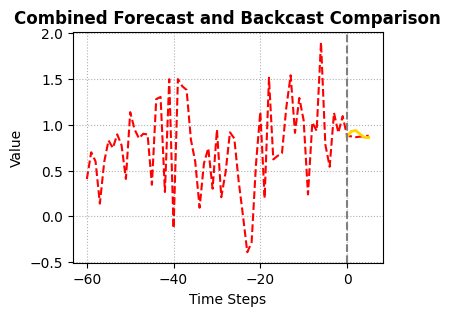

Epoch = 401, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 402, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 403, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 404, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 405, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 406, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 407, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 408, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 409, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 410, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 411, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 412, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 413, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 414, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 415, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 416, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 417, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 418, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 419, Train Loss = 0.0013, Test Loss = 

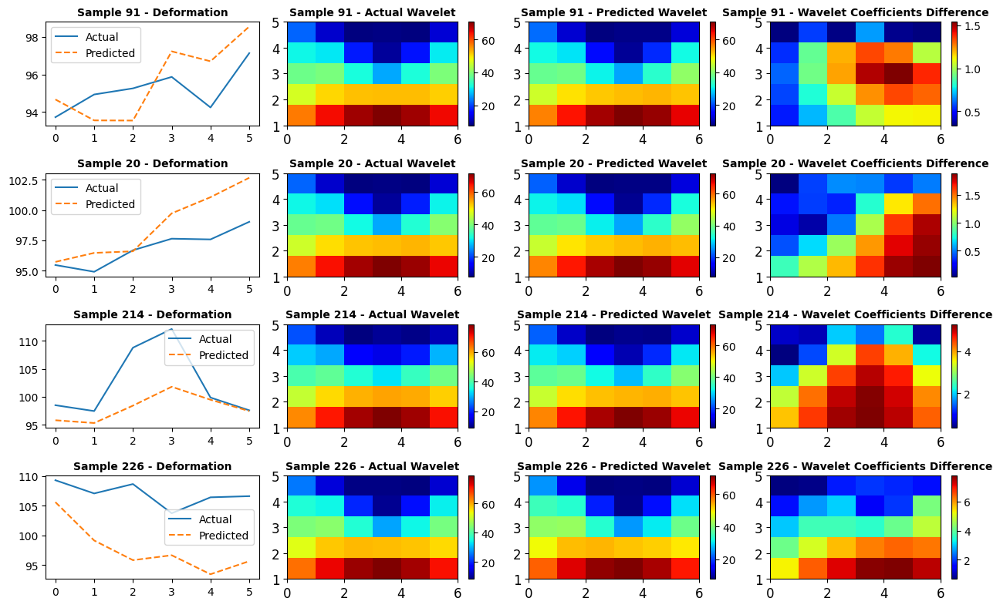

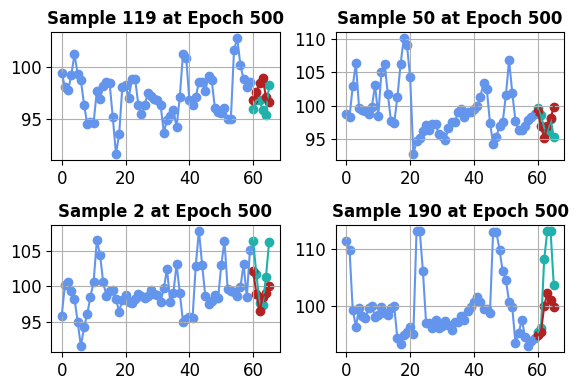

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.04626931,  0.31661686, -0.29611966, -0.38249427,  0.27561486,
        0.17690082, -0.38694817,  0.00410024, -0.27703902, -0.14221653,
        0.1356491 , -0.17401263,  0.10698936, -0.12312198, -0.40471232,
       -0.4735715 ,  0.2665078 ,  0.36669168, -0.13684838,  0.43748397,
       -0.4712601 ,  0.4062286 ,  0.42061457,  0.44064426,  0.4143483 ,
       -0.4296844 , -0.32192966, -0.1885396 ,  0.37848228,  0.01934594,
        0.39477384, -0.2775445 , -0.193214  ,  0.10920075,  0.32727787,
       -0.41180462, -0.19554631, -0.36643904, -0.45383576,  0.15182298,
       -0.05661001, -0.31603074,  0.27097723, -0.11872973, -0.44868645,
       -0.19483075,  0.21020383, -0.05850901,  0.33407193, -0.19605725,
       -0.05330005, -0.41425332,  0.36902487, -0.0239375 ,  0.37581897,
       -0.01223985, -0.41671425, -0.3461209 , -0.19683139,  0.37109777],
      dtype=float32), 'forecast': array([ 0.16800626,  0.11348617,  0.434

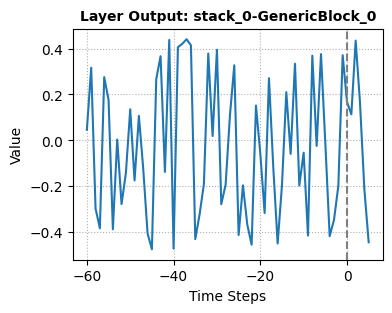

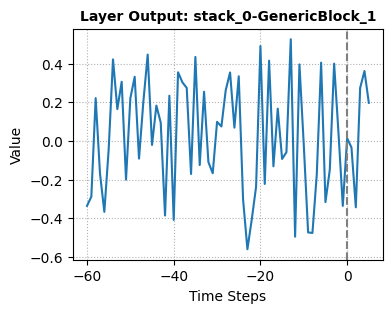

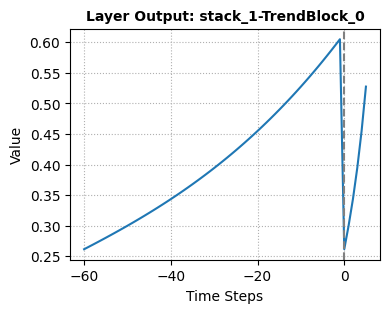

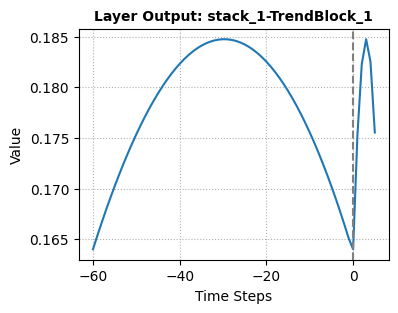

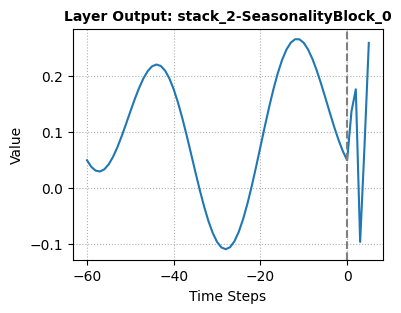

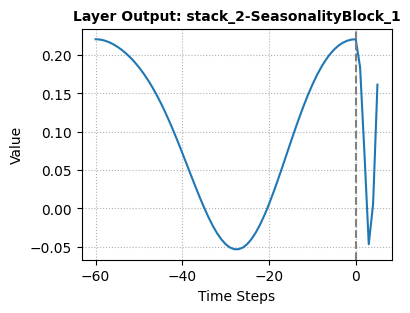

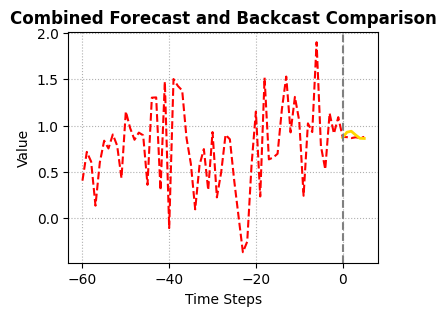

Epoch = 501, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 502, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 503, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 504, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 505, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 506, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 507, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 508, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 509, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 510, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 511, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 512, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 513, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 514, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 515, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 516, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 517, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 518, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 519, Train Loss = 0.0013, Test Loss = 

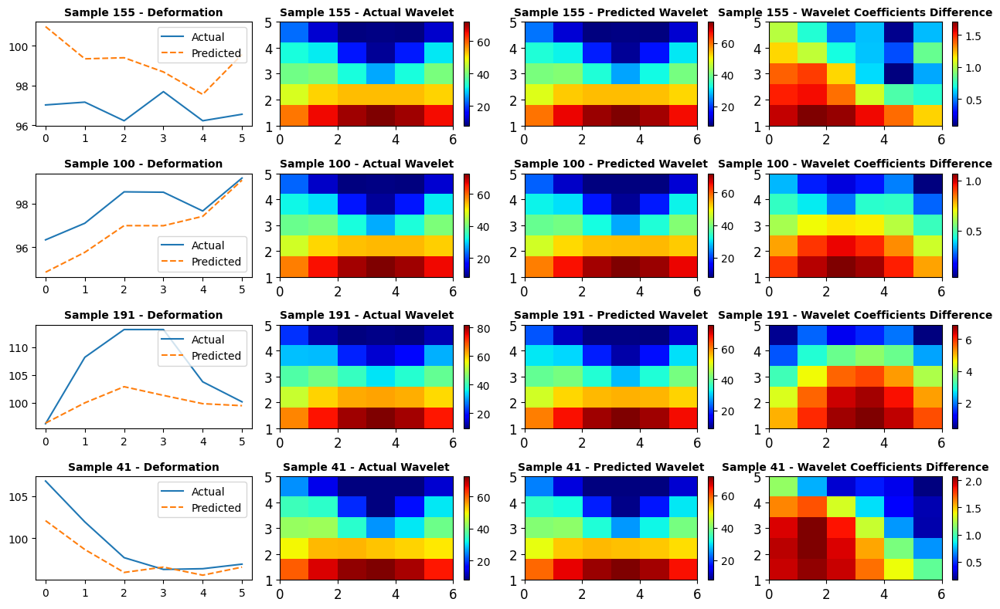

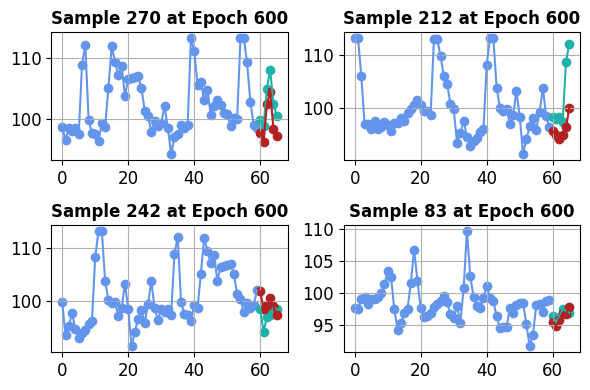

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.04549372,  0.32377395, -0.2919057 , -0.38010374,  0.28307146,
        0.17429794, -0.3927199 ,  0.00181179, -0.2718751 , -0.14170639,
        0.13098727, -0.1633765 ,  0.10723941, -0.1253954 , -0.40556794,
       -0.4709763 ,  0.27126515,  0.36652046, -0.12693761,  0.43448722,
       -0.467466  ,  0.4054221 ,  0.42425463,  0.4379398 ,  0.41474   ,
       -0.4148049 , -0.31652722, -0.18697429,  0.37249455,  0.02996556,
        0.3892343 , -0.2724833 , -0.18975477,  0.10794497,  0.32227907,
       -0.39844015, -0.18324324, -0.37086907, -0.45978814,  0.15466115,
       -0.05444505, -0.31981382,  0.27043387, -0.1148295 , -0.4464431 ,
       -0.18733843,  0.21164356, -0.06120716,  0.3426794 , -0.19504116,
       -0.0479018 , -0.41948694,  0.36941326, -0.01895448,  0.37806442,
       -0.01411961, -0.42330435, -0.3409901 , -0.19567685,  0.36796793],
      dtype=float32), 'forecast': array([ 0.18107657,  0.1101369 ,  0.445

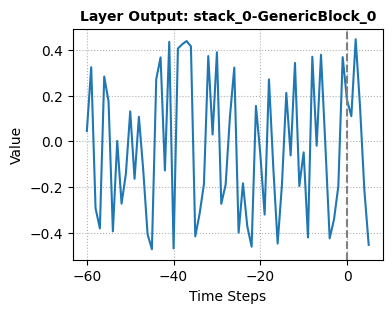

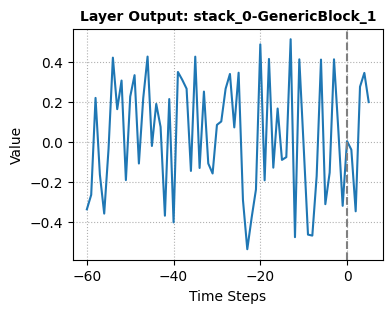

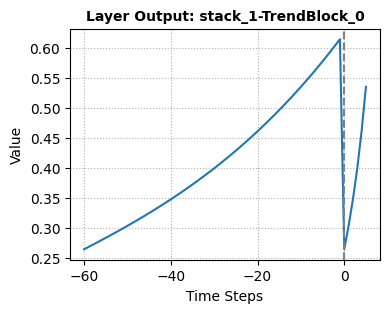

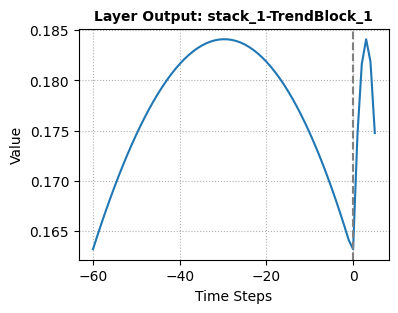

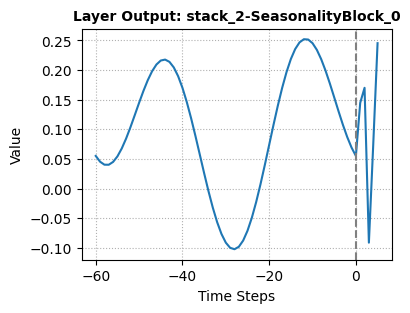

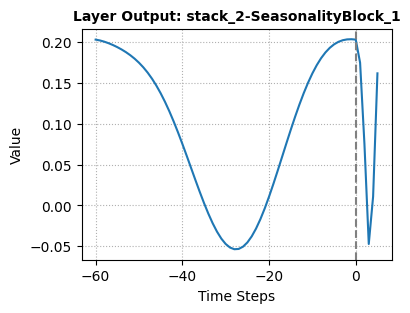

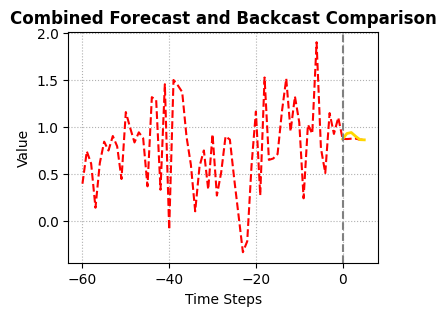

Epoch = 601, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 602, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 603, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 604, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 605, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 606, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 607, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 608, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 609, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 610, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 611, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 612, Train Loss = 0.0013, Test Loss = 0.0014
Epoch = 613, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 614, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 615, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 616, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 617, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 618, Train Loss = 0.0013, Test Loss = 0.0015
Epoch = 619, Train Loss = 0.0013, Test Loss = 

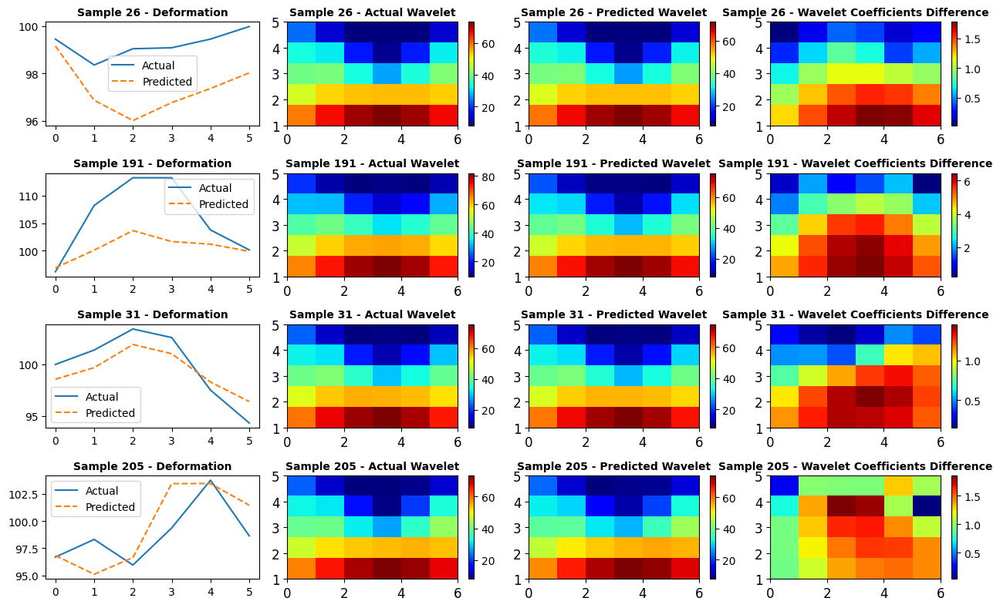

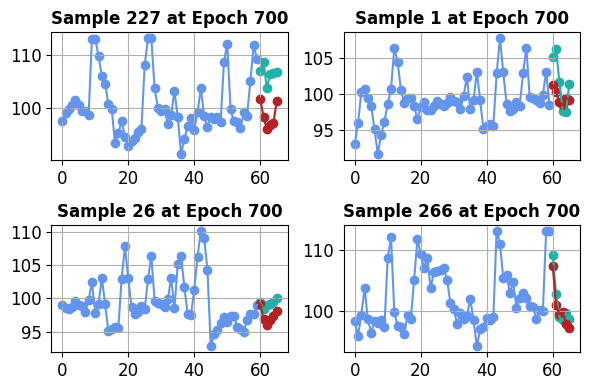

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.04678338,  0.3262512 , -0.2880969 , -0.37693477,  0.28665334,
        0.17522542, -0.39458793,  0.00058175, -0.270745  , -0.14190991,
        0.12825294, -0.15820748,  0.1086235 , -0.12189066, -0.40456626,
       -0.46698588,  0.27355695,  0.3628086 , -0.11912897,  0.42918363,
       -0.4556526 ,  0.40411505,  0.4227322 ,  0.43734792,  0.41439655,
       -0.40978634, -0.3132831 , -0.18127201,  0.37254682,  0.03709759,
        0.38785258, -0.2673085 , -0.18991697,  0.10569305,  0.32186145,
       -0.38999537, -0.1771964 , -0.37213734, -0.45419934,  0.1583489 ,
       -0.05896248, -0.31020895,  0.2728662 , -0.10628338, -0.44060916,
       -0.18494987,  0.21227337, -0.06223821,  0.3478073 , -0.19387195,
       -0.04711203, -0.4169108 ,  0.37096187, -0.02134406,  0.37436175,
       -0.01385542, -0.4212066 , -0.34081614, -0.19501922,  0.36742234],
      dtype=float32), 'forecast': array([ 0.19026414,  0.10362183,  0.455

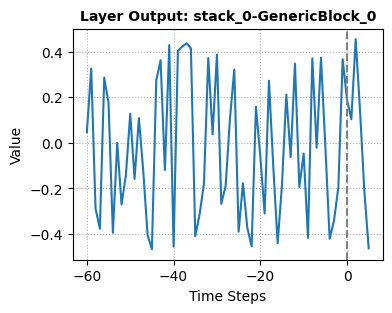

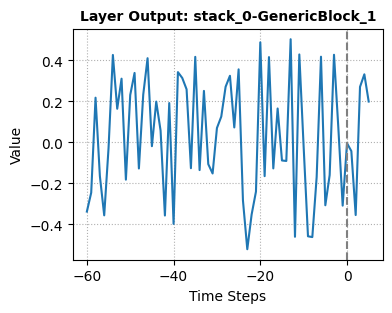

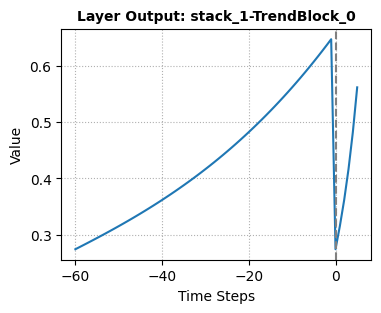

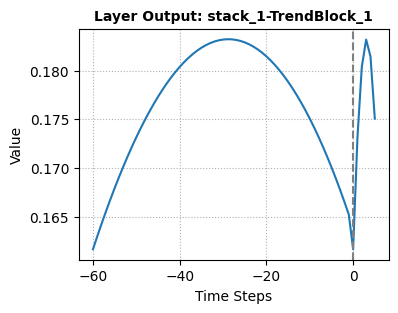

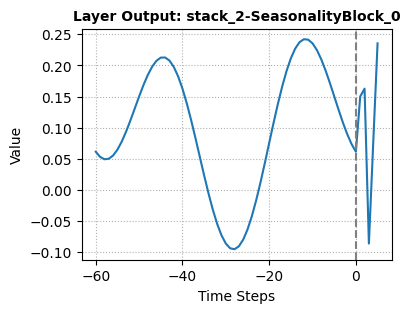

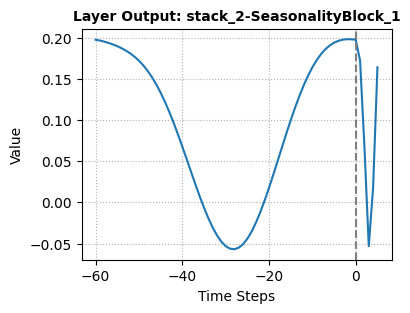

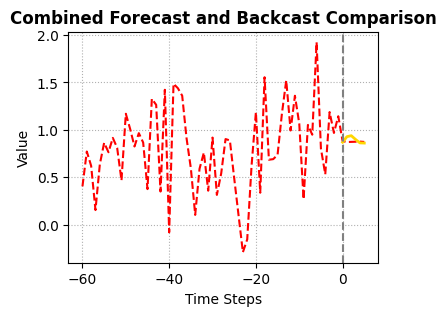

Epoch = 701, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 702, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 703, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 704, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 705, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 706, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 707, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 708, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 709, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 710, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 711, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 712, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 713, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 714, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 715, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 716, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 717, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 718, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 719, Train Loss = 0.0013, Test Loss = 

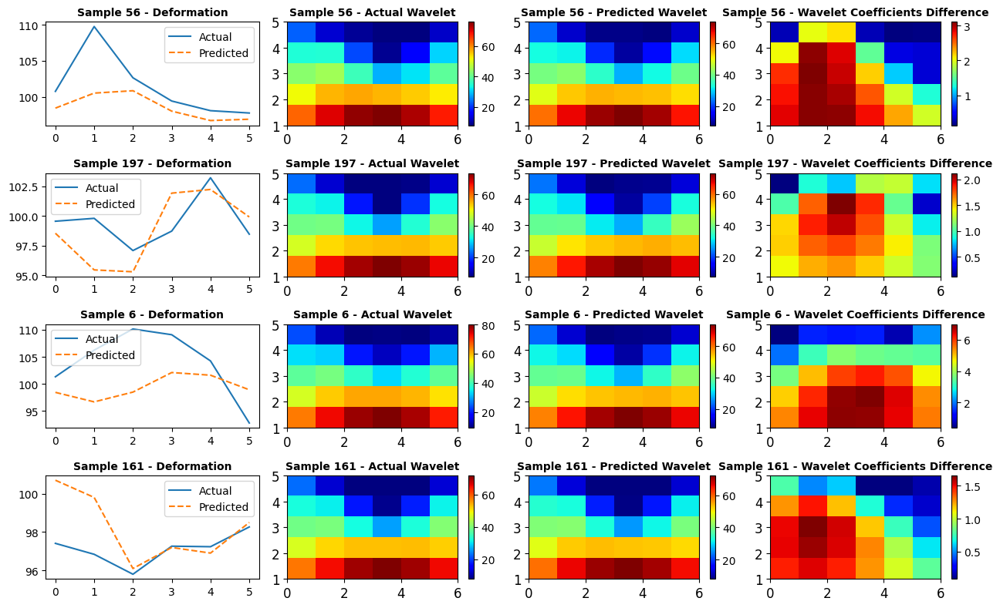

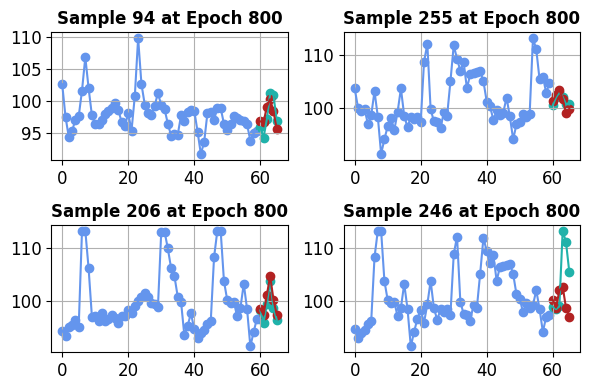

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.05062747,  0.32599193, -0.28570843, -0.3759189 ,  0.285     ,
        0.17871673, -0.38990724,  0.00323581, -0.27194598, -0.14056683,
        0.12992725, -0.1589874 ,  0.1082162 , -0.1194872 , -0.40149653,
       -0.4635413 ,  0.27370763,  0.3622112 , -0.11138683,  0.4255533 ,
       -0.4461439 ,  0.40496832,  0.42001092,  0.43470827,  0.41360646,
       -0.41218606, -0.31312707, -0.1796832 ,  0.37573406,  0.03571701,
        0.3902741 , -0.26911986, -0.19184501,  0.10656862,  0.32462072,
       -0.3905407 , -0.1779809 , -0.37022975, -0.4480126 ,  0.16091515,
       -0.06104405, -0.30173364,  0.27069598, -0.10481855, -0.44061944,
       -0.18548745,  0.20875317, -0.06157348,  0.34524658, -0.1916646 ,
       -0.04759103, -0.41200584,  0.37076902, -0.02203139,  0.37328514,
       -0.01109236, -0.41613418, -0.34361535, -0.19217107,  0.36736444],
      dtype=float32), 'forecast': array([ 0.18867782,  0.10114896,  0.453

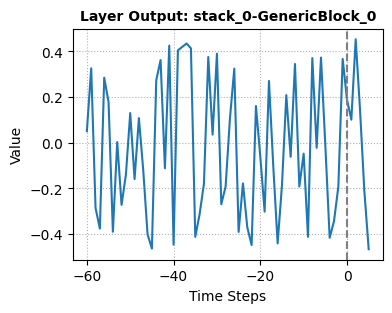

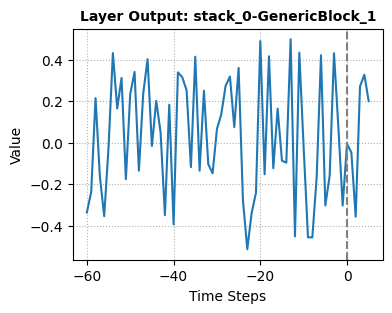

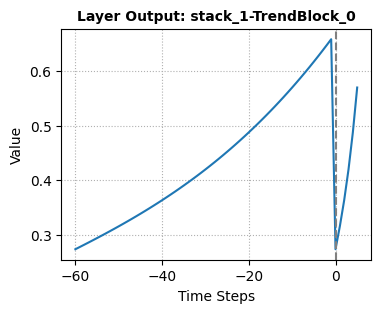

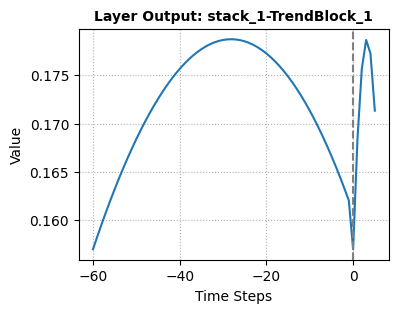

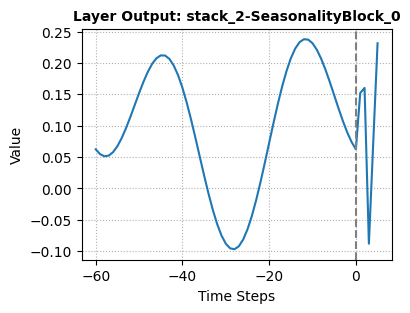

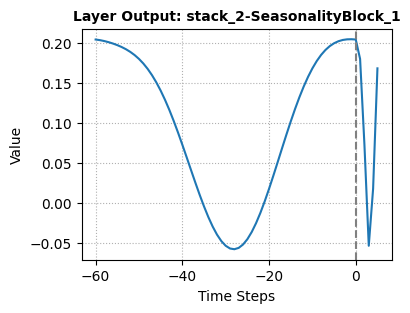

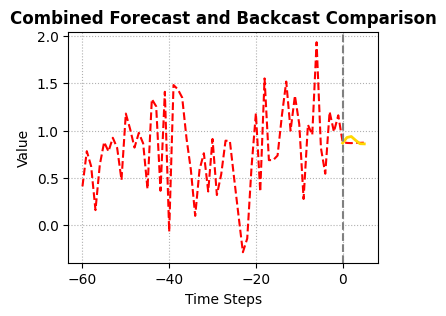

Epoch = 801, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 802, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 803, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 804, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 805, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 806, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 807, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 808, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 809, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 810, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 811, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 812, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 813, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 814, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 815, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 816, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 817, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 818, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 819, Train Loss = 0.0012, Test Loss = 

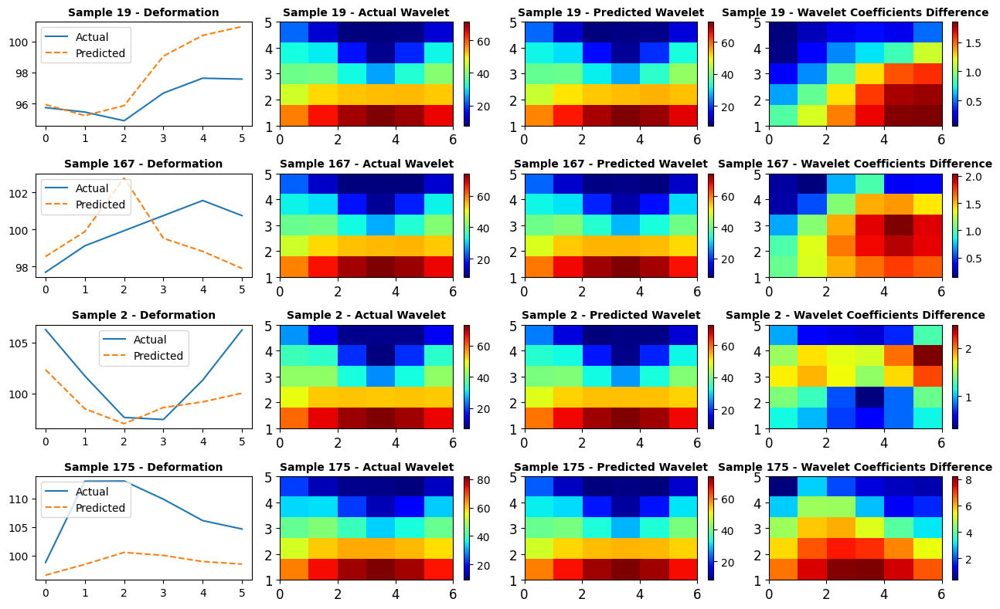

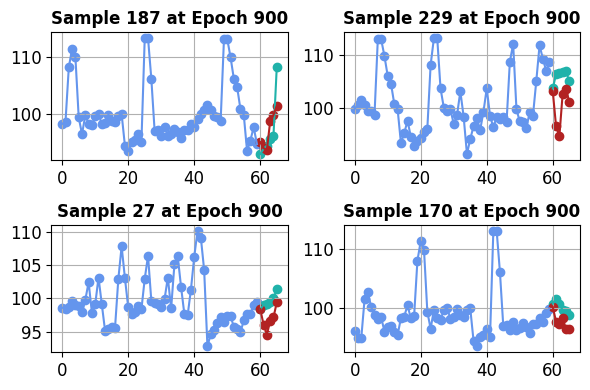

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.05545716,  0.32364878, -0.28519705, -0.37564266,  0.2815264 ,
        0.1825139 , -0.3857848 ,  0.00625118, -0.27451688, -0.1405818 ,
        0.13063863, -0.15956427,  0.10835993, -0.11565655, -0.39797816,
       -0.45899093,  0.274898  ,  0.3596978 , -0.10669193,  0.42104936,
       -0.43681177,  0.40675274,  0.41901886,  0.43279123,  0.41392   ,
       -0.41755214, -0.31417742, -0.17647633,  0.3781655 ,  0.03461135,
        0.39311025, -0.26947168, -0.19427124,  0.1066912 ,  0.32900026,
       -0.39079437, -0.17885695, -0.36861214, -0.4394419 ,  0.16372211,
       -0.06452367, -0.29235756,  0.27043122, -0.10146607, -0.4387742 ,
       -0.18686172,  0.20564137, -0.05976333,  0.34348044, -0.18903573,
       -0.04879555, -0.40663362,  0.37124076, -0.02498066,  0.37071627,
       -0.00821152, -0.40862396, -0.34784463, -0.18938084,  0.3677801 ],
      dtype=float32), 'forecast': array([ 0.18546458,  0.09876144,  0.451

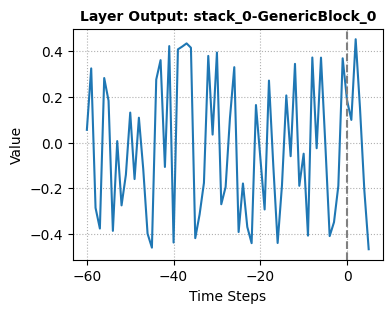

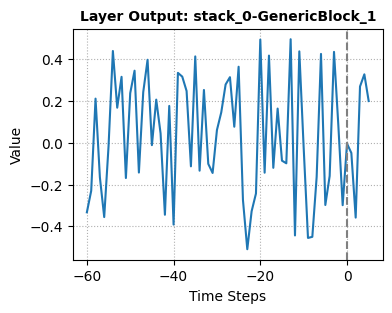

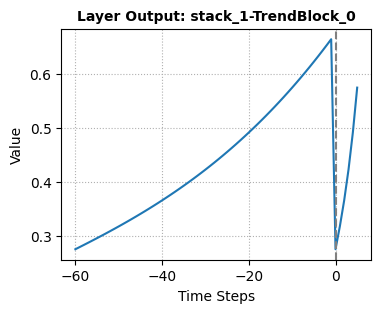

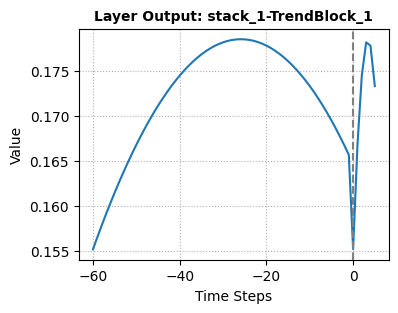

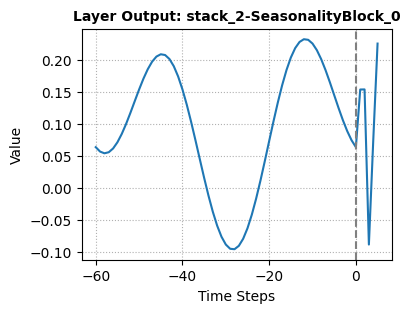

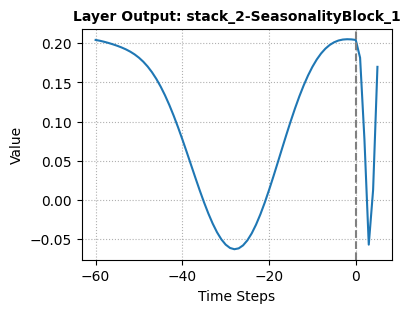

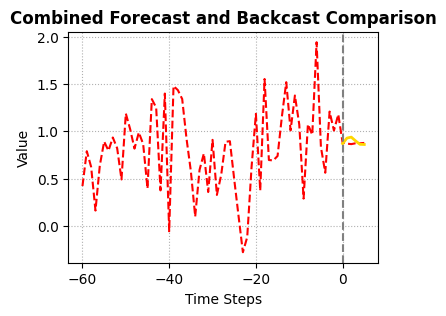

Epoch = 901, Train Loss = 0.0012, Test Loss = 0.0014
Epoch = 902, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 903, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 904, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 905, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 906, Train Loss = 0.0012, Test Loss = 0.0014
Epoch = 907, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 908, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 909, Train Loss = 0.0012, Test Loss = 0.0014
Epoch = 910, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 911, Train Loss = 0.0012, Test Loss = 0.0014
Epoch = 912, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 913, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 914, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 915, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 916, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 917, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 918, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 919, Train Loss = 0.0012, Test Loss = 

In [58]:
save_dir = 'plots_K3_3B1_60'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

In [59]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from math import sqrt


net.eval()
with torch.no_grad():

    _,predicted_test = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    predicted_test = predicted_test.detach().cpu().numpy() * norm_constant
    y_test_actual = y_test * norm_constant

    rmse = sqrt(mean_squared_error(y_test_actual, predicted_test))
    mae = mean_absolute_error(y_test_actual, predicted_test)

print(f"Test RMSE: {rmse}")
print(f"Test MAE: {mae}")

Test RMSE: 4.19851562080841
Test MAE: 2.9587341319862612


# Neural Network-Based Feature Extraction for Deformation Observations in the K3_3B1 (Input length: 100)

In [60]:
data_K3_3B1 = data[data.Station_id=='K3_3B1'][['Vertical displacement(mm)']]
data_K3_3B1

,Vertical displacement(mm)
date,
2022-02-02 00:00:00,78.735333
2022-02-02 03:00:00,76.416000
2022-02-02 06:00:00,79.454222
2022-02-02 09:00:00,76.285593
2022-02-02 12:00:00,79.687600
...,...
2022-08-01 09:00:00,99.295571
2022-08-01 12:00:00,99.256889
2022-08-01 15:00:00,112.854000


In [61]:
forecast_length = 6
backcast_length = 100
batch_size = 32  # greater than 4 for viz

data_K3_3B1 = data_K3_3B1.values.flatten()  # just keep np array here for simplicity.

# data backcast/forecast generation.
x, y = [], []
for epoch in range(backcast_length, len(data_K3_3B1) - forecast_length):
    x.append(data_K3_3B1[epoch - backcast_length:epoch])
    y.append(data_K3_3B1[epoch:epoch + forecast_length])
x = np.array(x)
y = np.array(y)

# split train/test.
c = int(len(x) * 0.8)
x_train, y_train = x[:c], y[:c]
x_test, y_test = x[c:], y[c:]

# normalization.
norm_constant = np.max(x_train)
x_train, y_train = x_train / norm_constant, y_train / norm_constant  # Normalize the data
x_test, y_test = x_test / norm_constant, y_test / norm_constant

| N-Beats
| --  Stack Generic (#0) (share_weights_in_stack=False)
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=100, forecast_length=6, share_thetas=False) at @138464847887856
     | -- GenericBlock(units=32, thetas_dim=4, backcast_length=100, forecast_length=6, share_thetas=False) at @138464849468608
| --  Stack Trend (#1) (share_weights_in_stack=False)
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=100, forecast_length=6, share_thetas=True) at @138464570015696
     | -- TrendBlock(units=32, thetas_dim=4, backcast_length=100, forecast_length=6, share_thetas=True) at @138464847884352
| --  Stack Seasonality (#2) (share_weights_in_stack=False)
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=100, forecast_length=6, share_thetas=True) at @138466048935296
     | -- SeasonalityBlock(units=32, thetas_dim=6, backcast_length=100, forecast_length=6, share_thetas=True) at @138466048945376


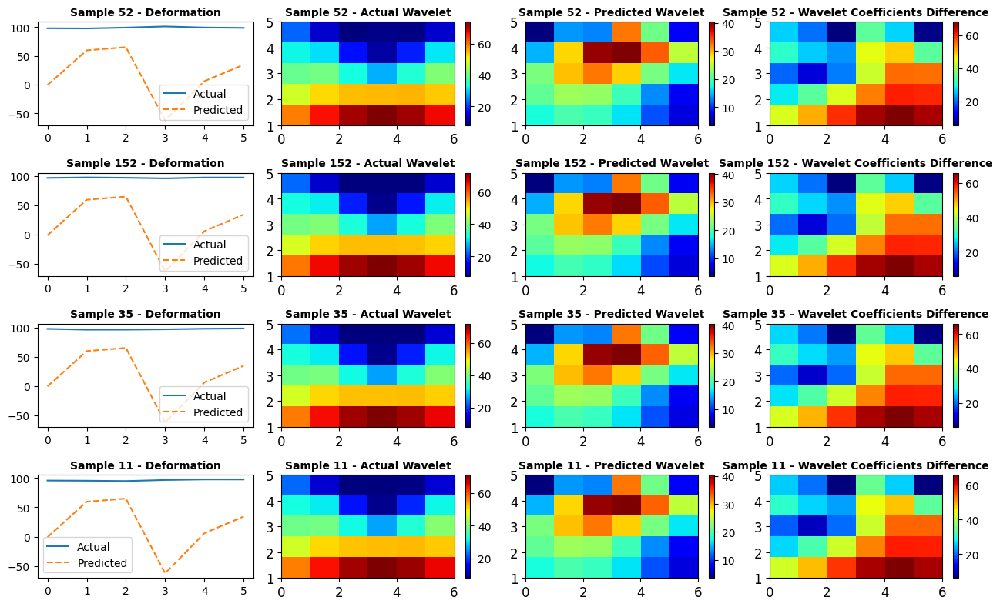

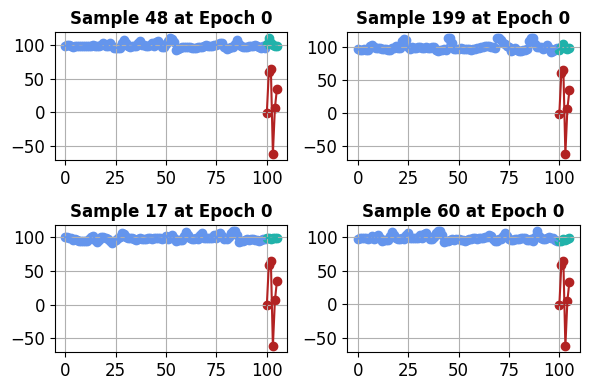

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.13070348, -0.2564107 , -0.11970314, -0.32876086,  0.26761523,
        0.03291059, -0.4455872 , -0.40384135,  0.5357943 ,  0.3803884 ,
       -0.4885515 , -0.30165422,  0.42311728, -0.30759794, -0.05517642,
        0.47202462,  0.43624192, -0.37564185, -0.22874175,  0.2495779 ,
       -0.49248427,  0.4150905 , -0.42726314, -0.5025425 , -0.38789415,
        0.47124028,  0.11887075,  0.09576194,  0.00904656, -0.39550737,
        0.4614202 , -0.13412376,  0.4651558 ,  0.11181761, -0.01016386,
       -0.00558393, -0.11841913,  0.03107473, -0.43549886,  0.3010825 ,
        0.37181556,  0.45821545, -0.444207  ,  0.25065556, -0.17270122,
        0.38210753,  0.19714276, -0.25311384, -0.11594085, -0.22861785,
       -0.11042223,  0.03447515, -0.02608035,  0.39857155, -0.05853092,
       -0.17980239,  0.2971447 , -0.26690385,  0.00080768,  0.27061453,
        0.06694061, -0.33523703,  0.02767187,  0.34034038, -0.18358241,
  

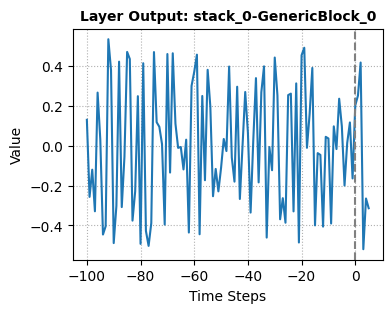

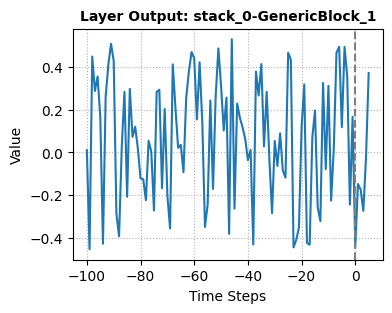

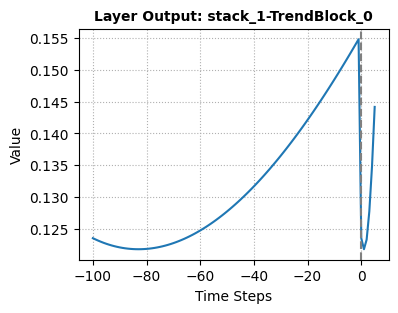

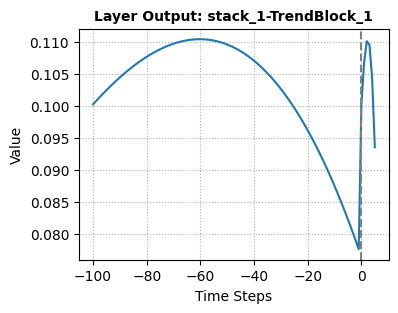

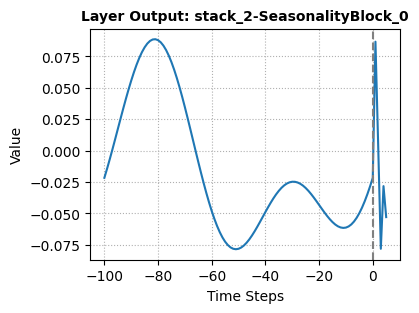

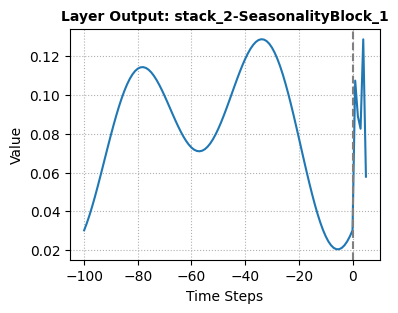

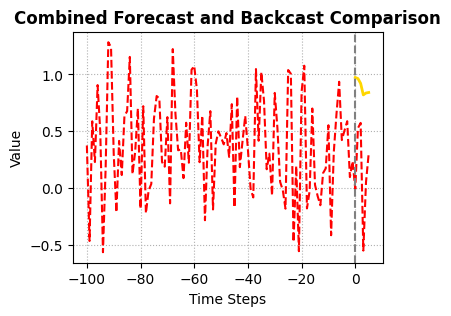

Epoch = 1, Train Loss = 0.8218, Test Loss = 0.6817
Epoch = 2, Train Loss = 0.4520, Test Loss = 0.3295
Epoch = 3, Train Loss = 0.2036, Test Loss = 0.1318
Epoch = 4, Train Loss = 0.0879, Test Loss = 0.0554
Epoch = 5, Train Loss = 0.0405, Test Loss = 0.0203
Epoch = 6, Train Loss = 0.0141, Test Loss = 0.0032
Epoch = 7, Train Loss = 0.0044, Test Loss = 0.0018
Epoch = 8, Train Loss = 0.0035, Test Loss = 0.0019
Epoch = 9, Train Loss = 0.0035, Test Loss = 0.0018
Epoch = 10, Train Loss = 0.0035, Test Loss = 0.0018
Epoch = 11, Train Loss = 0.0035, Test Loss = 0.0018
Epoch = 12, Train Loss = 0.0035, Test Loss = 0.0018
Epoch = 13, Train Loss = 0.0035, Test Loss = 0.0018
Epoch = 14, Train Loss = 0.0034, Test Loss = 0.0018
Epoch = 15, Train Loss = 0.0034, Test Loss = 0.0018
Epoch = 16, Train Loss = 0.0034, Test Loss = 0.0018
Epoch = 17, Train Loss = 0.0034, Test Loss = 0.0017
Epoch = 18, Train Loss = 0.0034, Test Loss = 0.0017
Epoch = 19, Train Loss = 0.0034, Test Loss = 0.0017
Epoch = 20, Train Los

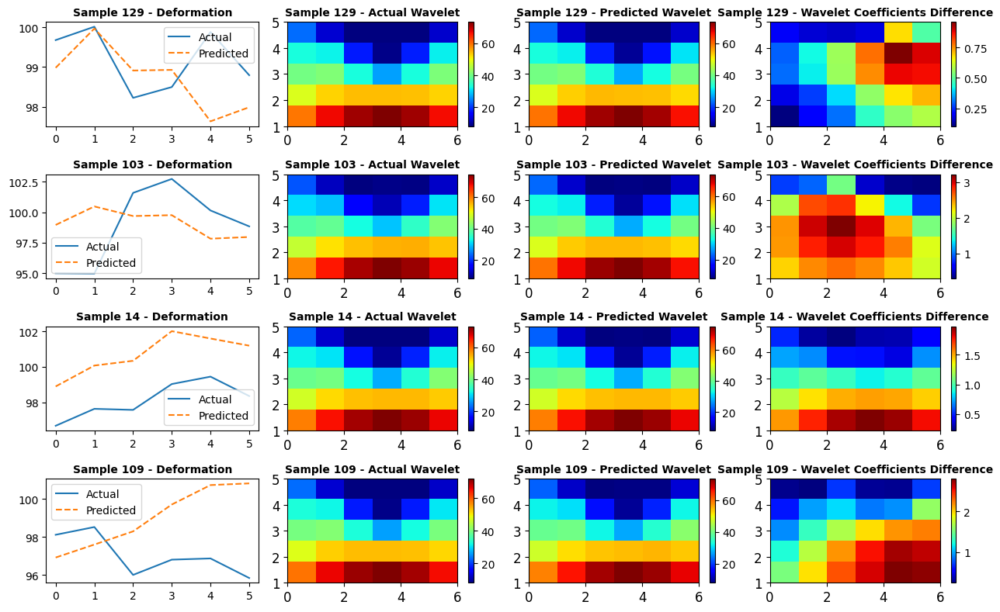

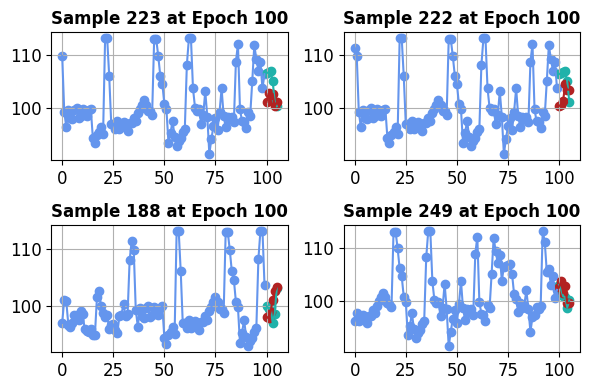

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 3.7353881e-02, -3.6973867e-01, -1.7410441e-01, -4.5529205e-01,
        3.4646383e-01, -7.8951918e-02, -4.4497961e-01, -4.5228496e-01,
        6.5172654e-01,  2.8648075e-01, -5.5185431e-01, -3.0376112e-01,
        3.9063913e-01, -2.0364502e-01,  2.0884780e-02,  4.2202535e-01,
        4.4075215e-01, -4.8260027e-01, -2.1407403e-01,  1.3901173e-01,
       -5.3694838e-01,  2.8457263e-01, -6.0781330e-01, -5.6063879e-01,
       -4.0001366e-01,  3.6598998e-01,  2.4232678e-02,  7.7217445e-02,
       -1.1777276e-01, -3.5354677e-01,  4.5454916e-01, -2.2171766e-01,
        4.6976447e-01,  5.1079702e-02,  1.8681671e-03, -2.9393764e-02,
       -2.0133731e-01, -6.5099590e-02, -5.0755018e-01,  2.6201457e-01,
        3.3205238e-01,  4.0191239e-01, -6.3335603e-01,  2.7104509e-01,
       -3.1696883e-01,  4.4342306e-01,  1.9588977e-01, -3.7446457e-01,
       -4.2742938e-02, -4.0917331e-01, -2.9829669e-01,  1.3085060e-02,
       -1.11792

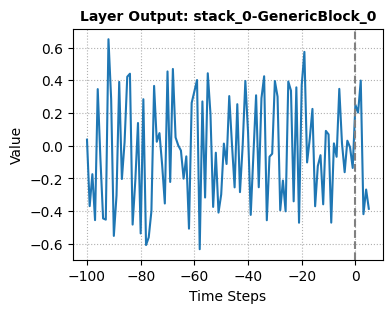

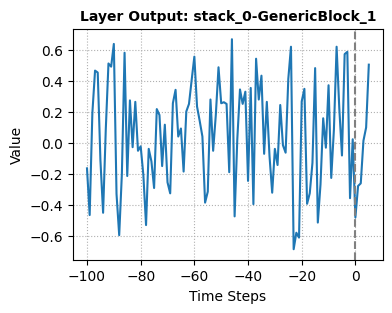

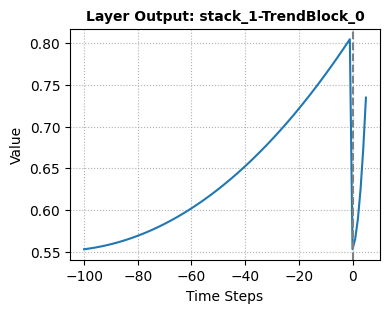

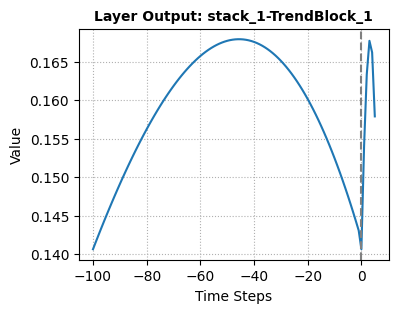

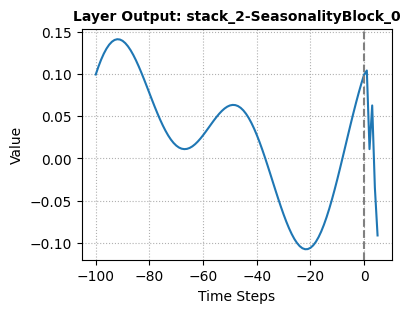

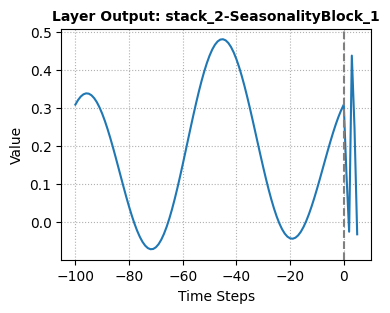

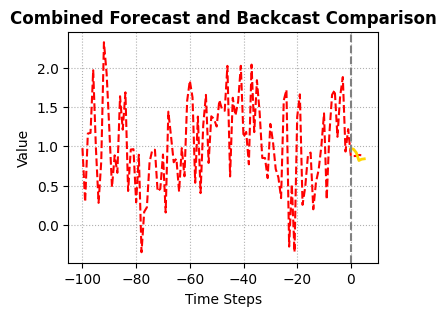

Epoch = 101, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 102, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 103, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 104, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 105, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 106, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 107, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 108, Train Loss = 0.0021, Test Loss = 0.0014
Epoch = 109, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 110, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 111, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 112, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 113, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 114, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 115, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 116, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 117, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 118, Train Loss = 0.0020, Test Loss = 0.0014
Epoch = 119, Train Loss = 0.0020, Test Loss = 

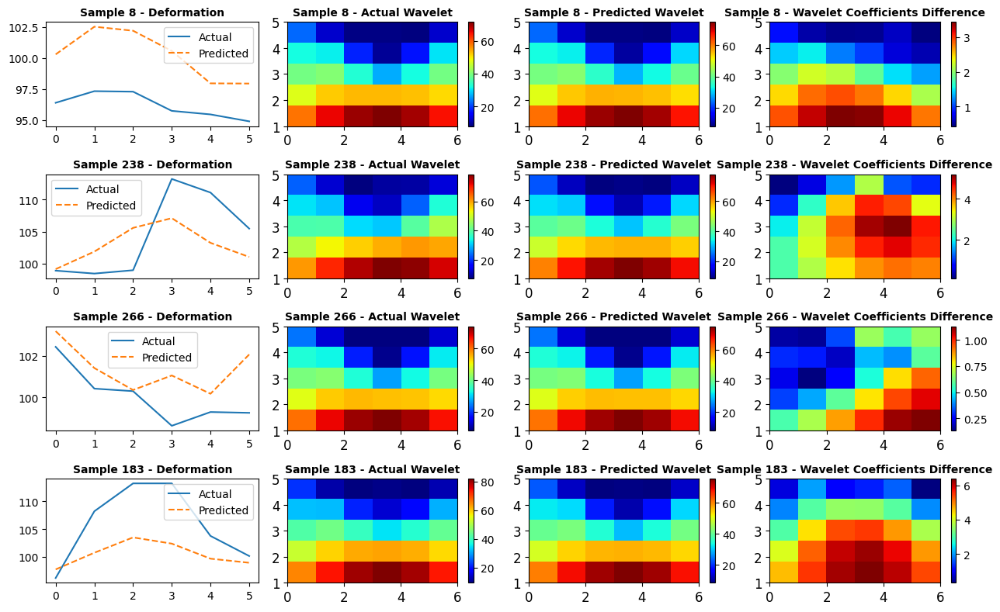

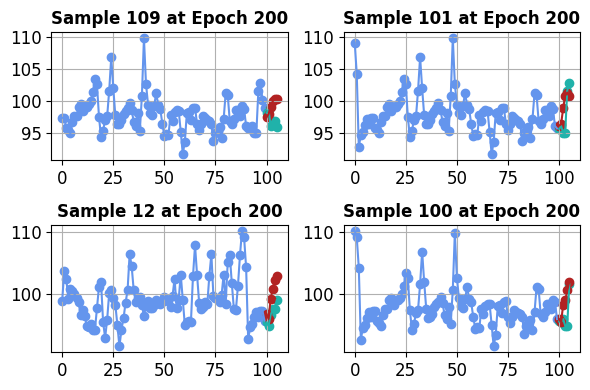

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.05896442, -0.33727294, -0.1643213 , -0.4055607 ,  0.3206811 ,
       -0.04244453, -0.44943756, -0.43236867,  0.61111194,  0.31757453,
       -0.5369685 , -0.29681477,  0.40808266, -0.24156377, -0.01101101,
        0.43038297,  0.43471313, -0.44738224, -0.22757266,  0.17270969,
       -0.53237617,  0.3239042 , -0.54983693, -0.54134727, -0.39667404,
        0.3960479 ,  0.05338795,  0.08115679, -0.07602075, -0.37583685,
        0.4484818 , -0.19397737,  0.46629176,  0.07126465,  0.00182317,
       -0.02713146, -0.174245  , -0.03383578, -0.4805161 ,  0.2698633 ,
        0.34474266,  0.4197856 , -0.5695839 ,  0.26237604, -0.27006376,
        0.4201686 ,  0.19661866, -0.34169906, -0.06764088, -0.35369262,
       -0.23898466,  0.01799252, -0.07689964,  0.33227277, -0.007775  ,
       -0.22640848,  0.2667185 , -0.27847952, -0.00111899,  0.3475656 ,
        0.07092731, -0.39146084, -0.02280369,  0.32803404, -0.2293968 ,
  

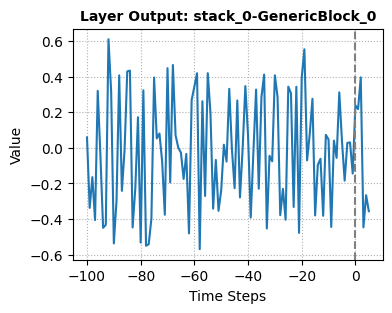

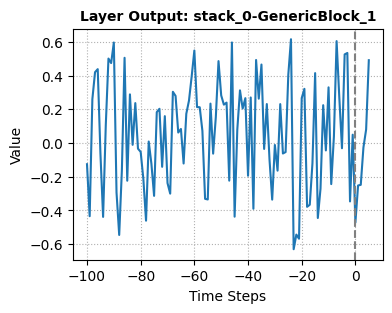

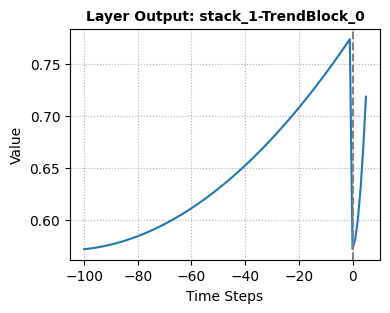

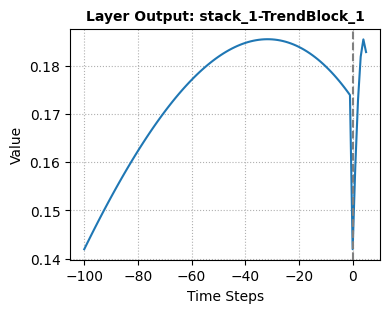

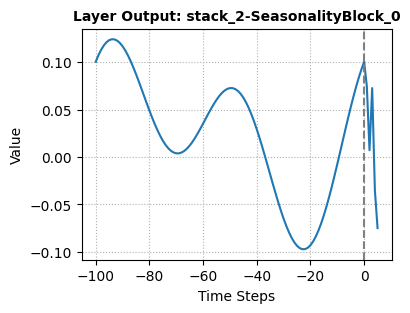

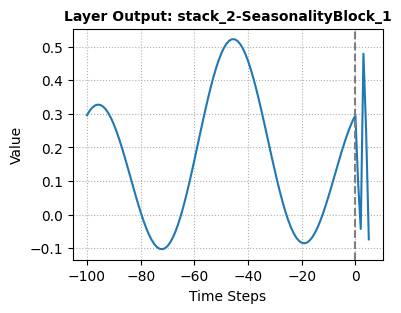

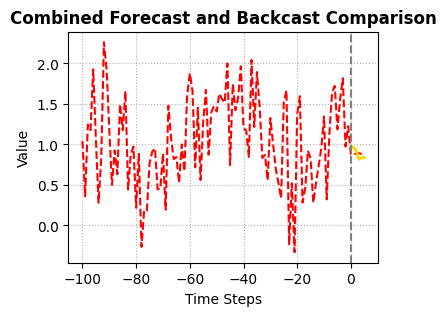

Epoch = 201, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 202, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 203, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 204, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 205, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 206, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 207, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 208, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 209, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 210, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 211, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 212, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 213, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 214, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 215, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 216, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 217, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 218, Train Loss = 0.0016, Test Loss = 0.0013
Epoch = 219, Train Loss = 0.0016, Test Loss = 

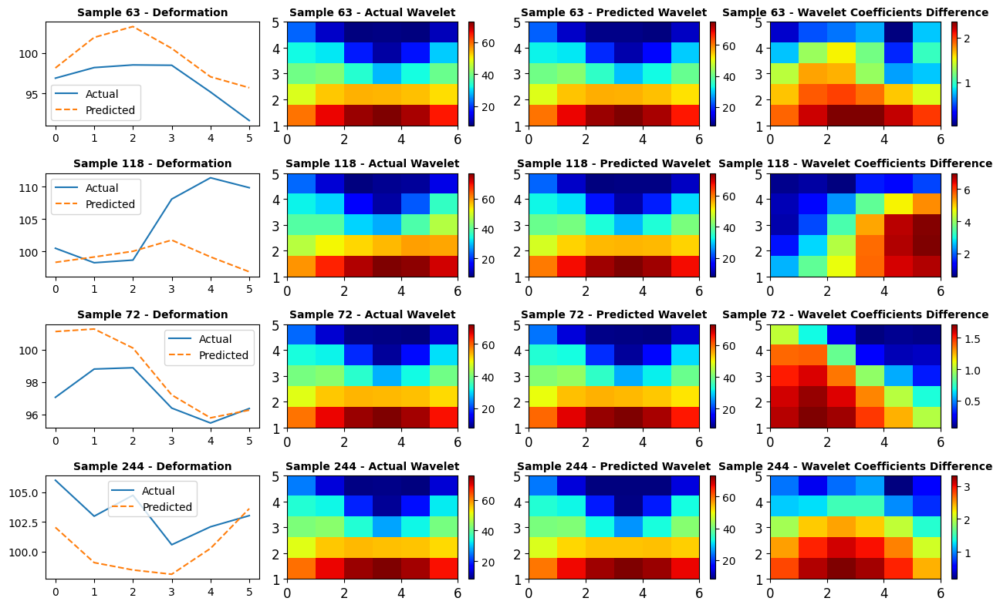

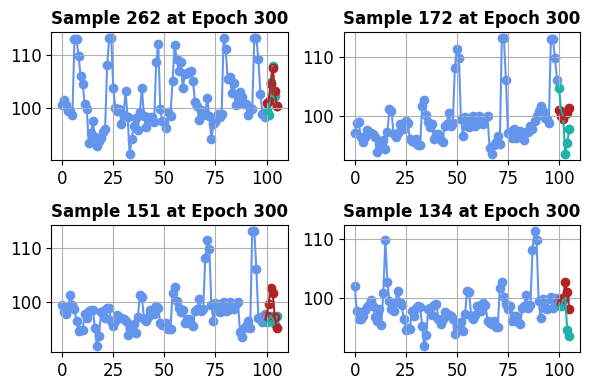

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.08452921, -0.30578294, -0.15734908, -0.36709756,  0.3010395 ,
       -0.01029717, -0.4537829 , -0.4156307 ,  0.57466197,  0.3439721 ,
       -0.52481323, -0.29727346,  0.421771  , -0.27484056, -0.03817723,
        0.44121382,  0.42812997, -0.4190187 , -0.23905988,  0.20554903,
       -0.5227433 ,  0.3577765 , -0.49907255, -0.51889485, -0.39583153,
        0.42276397,  0.07657357,  0.08367442, -0.04300718, -0.3870515 ,
        0.44360474, -0.173694  ,  0.4646804 ,  0.08921359,  0.00218184,
       -0.02581729, -0.15187764, -0.01122955, -0.46199864,  0.2743887 ,
        0.35200998,  0.4341748 , -0.5134067 ,  0.25301516, -0.22824955,
        0.3972978 ,  0.19590153, -0.30772877, -0.0907663 , -0.30307034,
       -0.1948853 ,  0.01853024, -0.04938987,  0.3562945 , -0.02621128,
       -0.20156963,  0.27357534, -0.27415225, -0.00600904,  0.30220142,
        0.06376751, -0.36235055,  0.00845008,  0.3391624 , -0.21112953,
  

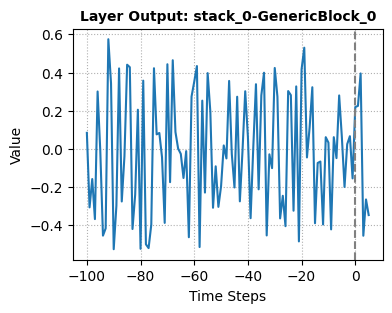

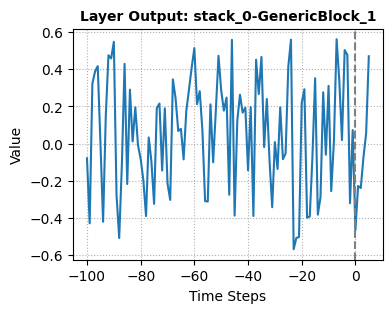

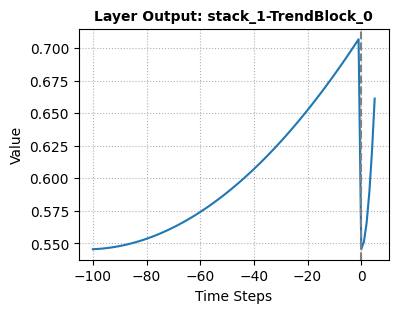

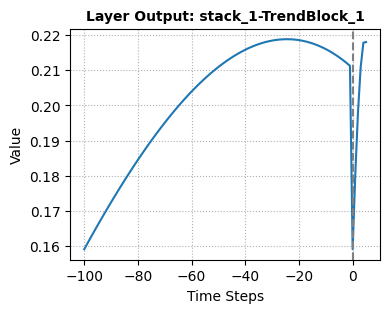

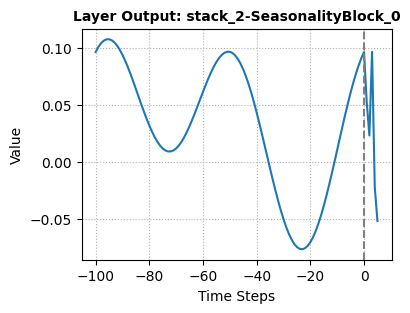

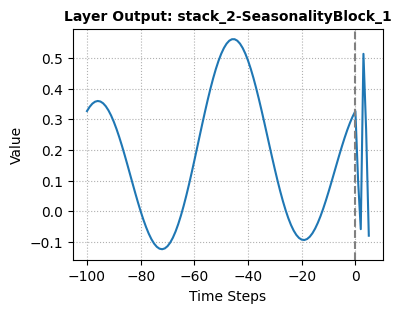

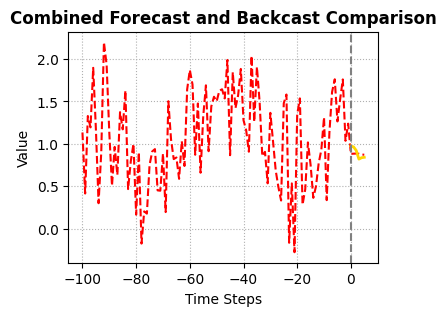

Epoch = 301, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 302, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 303, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 304, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 305, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 306, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 307, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 308, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 309, Train Loss = 0.0015, Test Loss = 0.0013
Epoch = 310, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 311, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 312, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 313, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 314, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 315, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 316, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 317, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 318, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 319, Train Loss = 0.0014, Test Loss = 

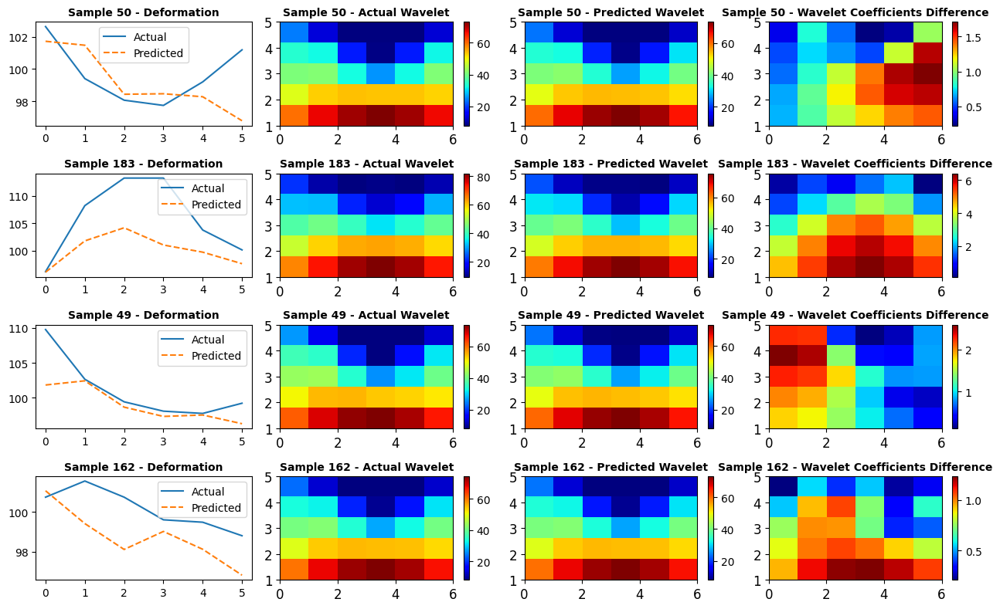

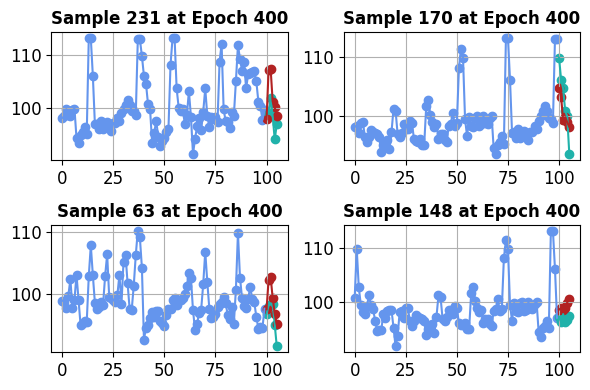

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.10306188, -0.28432024, -0.15675075, -0.35036623,  0.29188544,
        0.00705704, -0.45583007, -0.4080807 ,  0.55511266,  0.35700402,
       -0.51709515, -0.30023566,  0.428004  , -0.292597  , -0.05571228,
        0.44647926,  0.42313454, -0.40619683, -0.24298008,  0.22435243,
       -0.5144961 ,  0.37750512, -0.47129187, -0.50132114, -0.39611825,
        0.4393286 ,  0.08857317,  0.08519286, -0.02633041, -0.387562  ,
        0.4386663 , -0.16730781,  0.46400398,  0.09529203,  0.00356637,
       -0.02251168, -0.14218804, -0.00257479, -0.45496312,  0.27430496,
        0.35912314,  0.4361498 , -0.48293215,  0.25282162, -0.20438096,
        0.38114548,  0.1954051 , -0.28636667, -0.10540719, -0.27499297,
       -0.17300697,  0.02093459, -0.03761032,  0.3678955 , -0.04151355,
       -0.18100898,  0.27321026, -0.2706463 , -0.01218389,  0.273194  ,
        0.06383991, -0.34781736,  0.02666348,  0.34079897, -0.2053119 ,
  

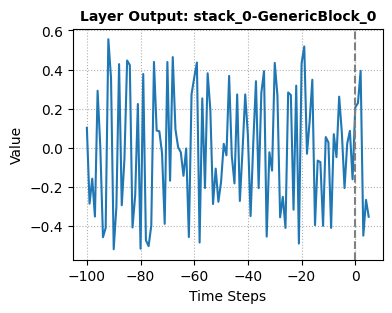

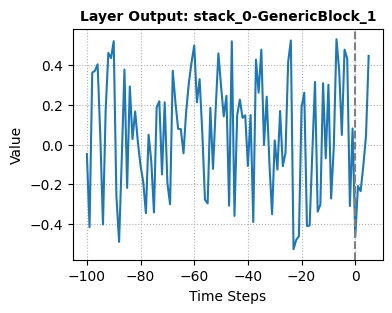

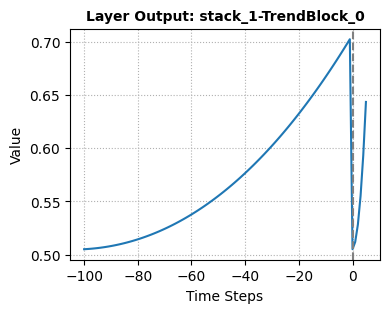

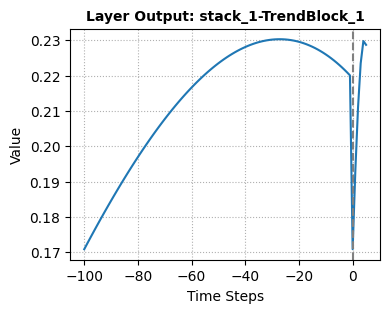

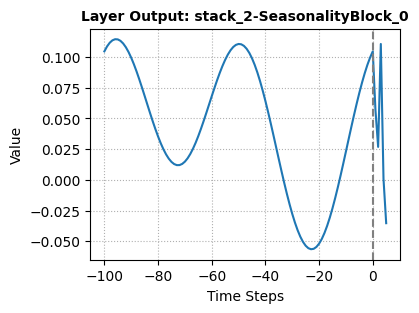

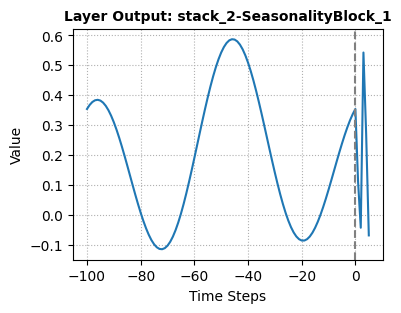

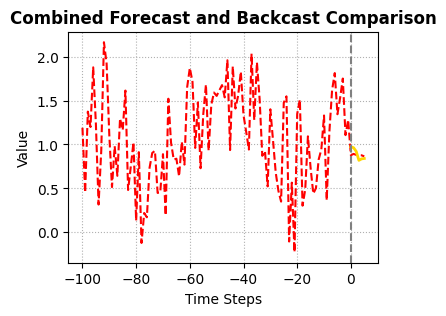

Epoch = 401, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 402, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 403, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 404, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 405, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 406, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 407, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 408, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 409, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 410, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 411, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 412, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 413, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 414, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 415, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 416, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 417, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 418, Train Loss = 0.0014, Test Loss = 0.0013
Epoch = 419, Train Loss = 0.0014, Test Loss = 

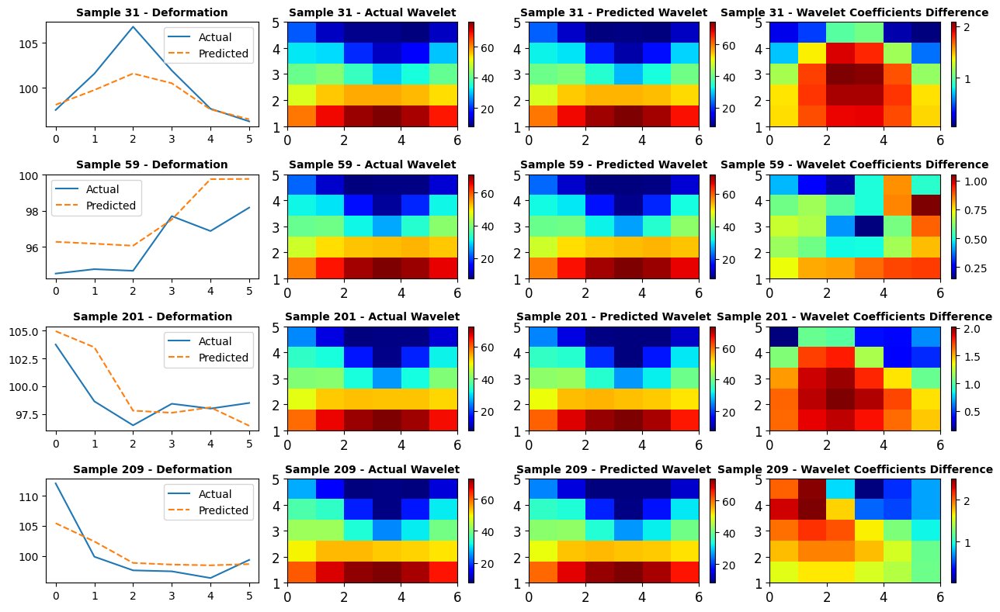

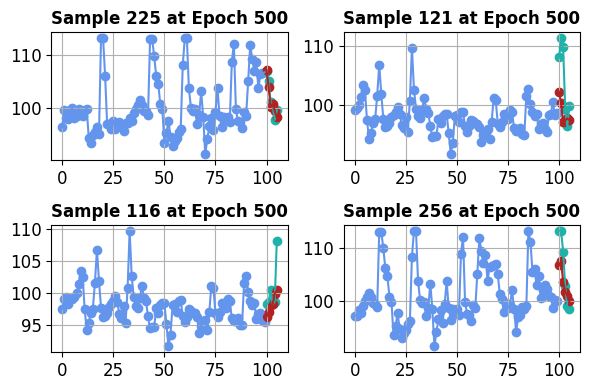

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.10744476, -0.27726442, -0.15404402, -0.3371757 ,  0.28081447,
        0.01379148, -0.45668253, -0.4030453 ,  0.5419653 ,  0.3626261 ,
       -0.51064456, -0.29377422,  0.43570444, -0.29715413, -0.0619221 ,
        0.44689053,  0.41940415, -0.39738676, -0.23749654,  0.2270805 ,
       -0.5145928 ,  0.38517088, -0.45765892, -0.49448794, -0.39322388,
        0.44644305,  0.09647252,  0.08579194, -0.0160146 , -0.39246124,
        0.4355487 , -0.15798995,  0.4577532 ,  0.09912874,  0.00301192,
       -0.01651761, -0.13494238,  0.00260051, -0.44455758,  0.27524245,
        0.35786152,  0.4398223 , -0.46816924,  0.24905619, -0.18856563,
        0.3749029 ,  0.19430509, -0.2775326 , -0.11158402, -0.26484448,
       -0.16126189,  0.02162372, -0.03370516,  0.37381074, -0.04603744,
       -0.17135598,  0.27754706, -0.26814175, -0.011191  ,  0.26139465,
        0.05878173, -0.33918086,  0.03787237,  0.3487463 , -0.20012952,
  

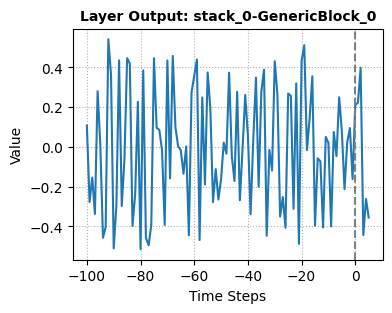

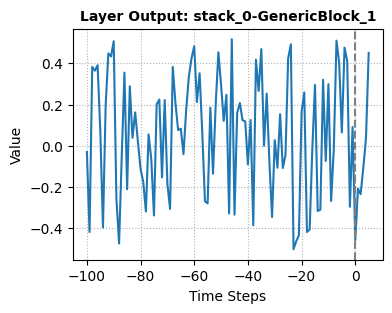

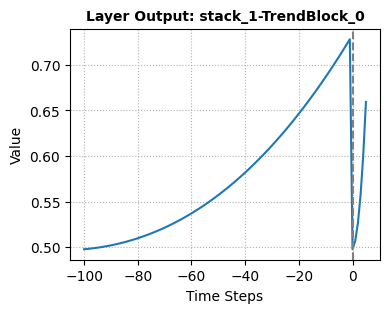

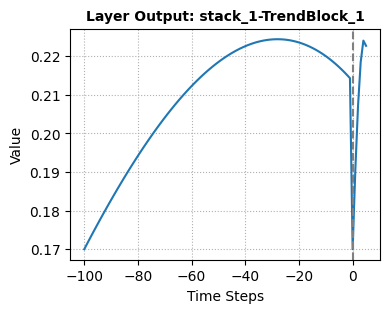

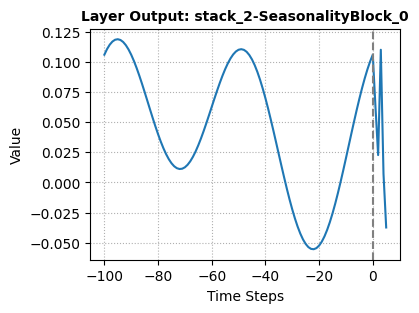

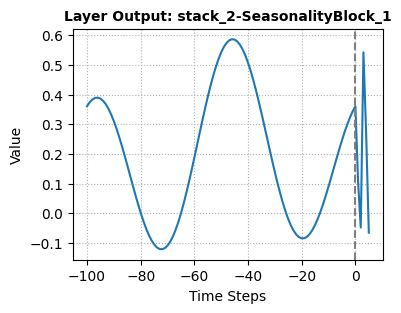

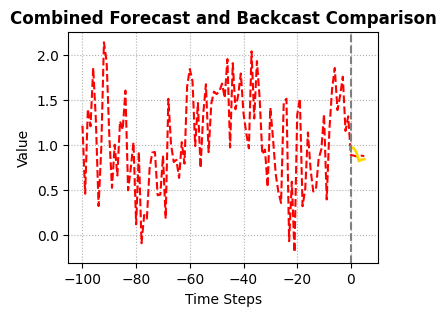

Epoch = 501, Train Loss = 0.0013, Test Loss = 0.0012
Epoch = 502, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 503, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 504, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 505, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 506, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 507, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 508, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 509, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 510, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 511, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 512, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 513, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 514, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 515, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 516, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 517, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 518, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 519, Train Loss = 0.0013, Test Loss = 

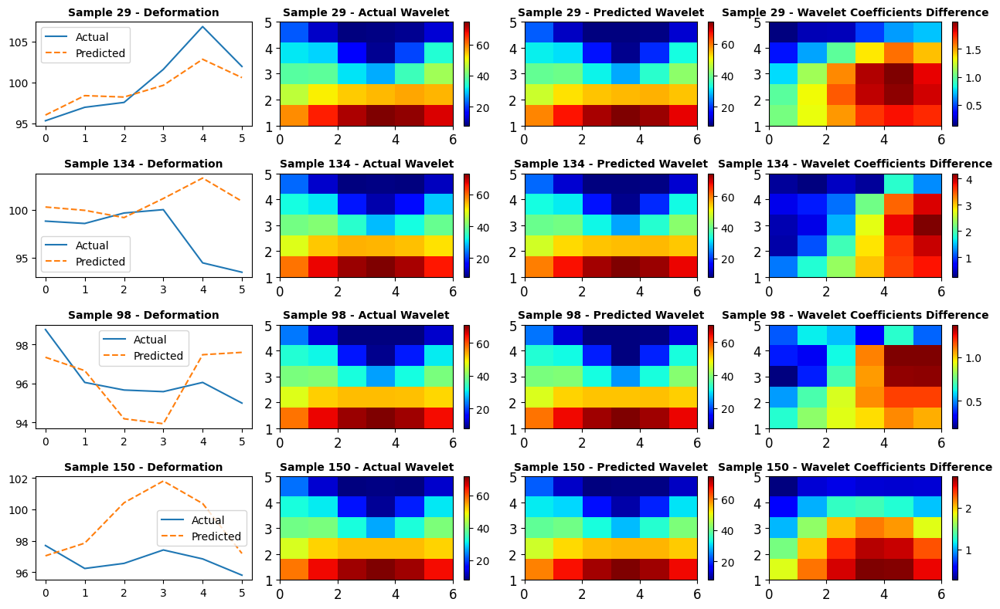

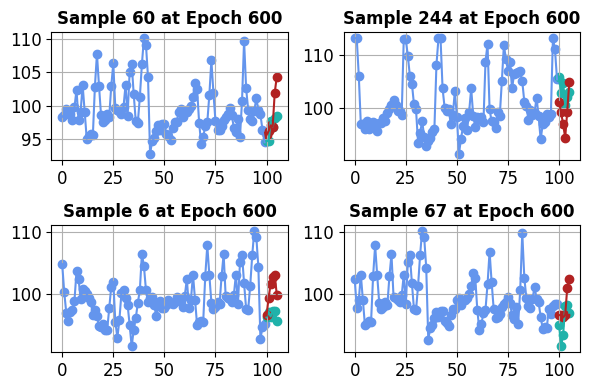

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.10827854, -0.27064896, -0.1495815 , -0.322794  ,  0.26866132,
        0.01939706, -0.45596442, -0.39745608,  0.5270062 ,  0.36504808,
       -0.5039644 , -0.28308836,  0.44254184, -0.29724273, -0.06659357,
        0.44663596,  0.4150848 , -0.38825122, -0.23135744,  0.22698238,
       -0.51633495,  0.39272162, -0.44138855, -0.48703906, -0.3868098 ,
        0.45333746,  0.10447455,  0.08494498, -0.00298207, -0.39700714,
        0.4345727 , -0.1460314 ,  0.4511713 ,  0.10320447,  0.00076124,
       -0.01275932, -0.12414155,  0.01037045, -0.432196  ,  0.27483153,
        0.35373116,  0.44430834, -0.45083347,  0.24341069, -0.17260493,
        0.372618  ,  0.19221272, -0.27227077, -0.11751228, -0.25728986,
       -0.15245728,  0.02020971, -0.02817525,  0.38075015, -0.04802666,
       -0.1624876 ,  0.28286672, -0.267073  , -0.01032418,  0.2521918 ,
        0.05802589, -0.32751197,  0.04631361,  0.3585977 , -0.19513741,
  

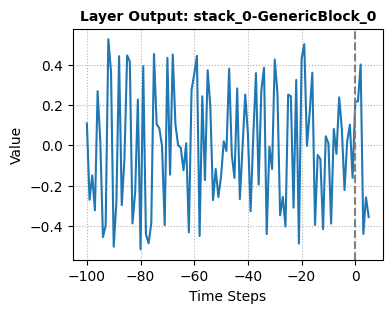

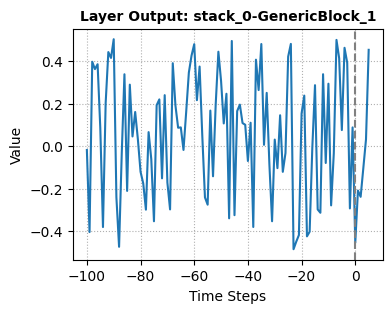

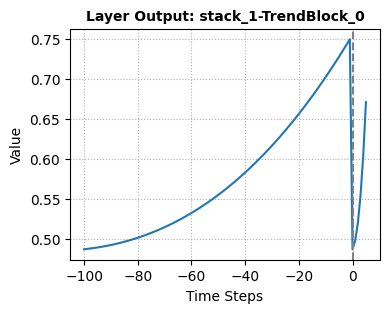

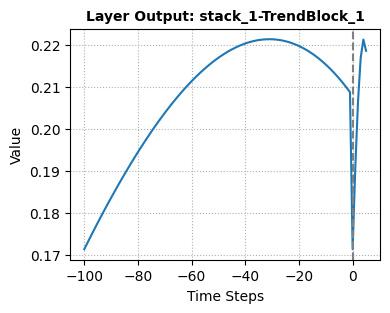

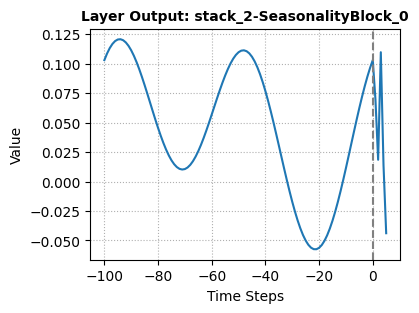

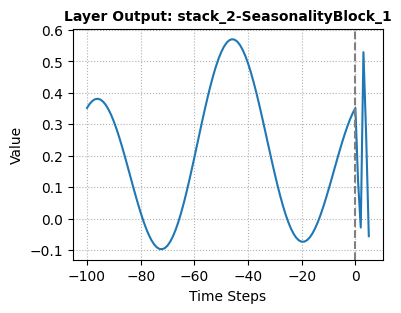

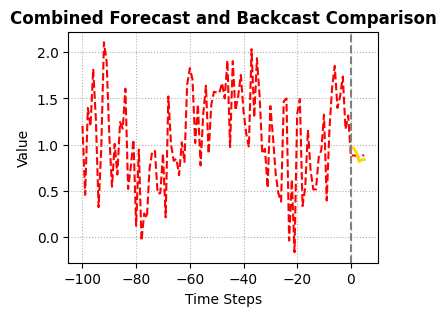

Epoch = 601, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 602, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 603, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 604, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 605, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 606, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 607, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 608, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 609, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 610, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 611, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 612, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 613, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 614, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 615, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 616, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 617, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 618, Train Loss = 0.0013, Test Loss = 0.0013
Epoch = 619, Train Loss = 0.0013, Test Loss = 

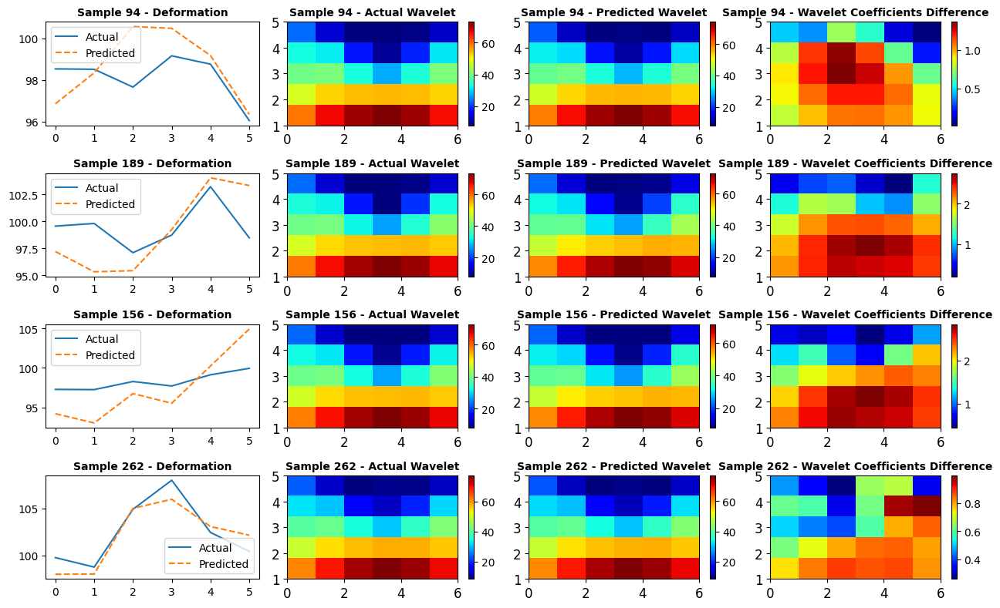

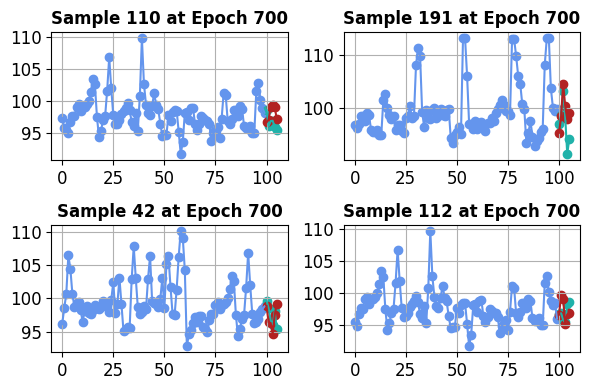

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 1.06127858e-01, -2.66651601e-01, -1.48106754e-01, -3.12187374e-01,
        2.61756033e-01,  2.33189166e-02, -4.55726326e-01, -3.93543929e-01,
        5.15751183e-01,  3.67113799e-01, -5.01059651e-01, -2.73095071e-01,
        4.50194150e-01, -2.97040790e-01, -7.06749856e-02,  4.43730414e-01,
        4.11287218e-01, -3.81734908e-01, -2.30488762e-01,  2.24238038e-01,
       -5.20086229e-01,  3.97810966e-01, -4.28376645e-01, -4.82572079e-01,
       -3.79173428e-01,  4.58434403e-01,  1.09321319e-01,  8.41809362e-02,
        7.07691815e-03, -4.03150976e-01,  4.33373153e-01, -1.39075264e-01,
        4.44353849e-01,  1.04463272e-01, -7.50933250e-04, -1.33687416e-02,
       -1.17898993e-01,  1.76486839e-02, -4.21100706e-01,  2.73350745e-01,
        3.52425367e-01,  4.45803612e-01, -4.37636644e-01,  2.39621475e-01,
       -1.62217215e-01,  3.71556133e-01,  1.92938194e-01, -2.70756334e-01,
       -1.20140329e-01, -2.53374219e-0

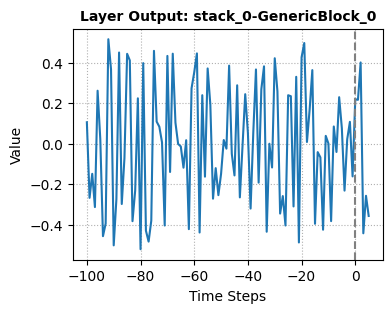

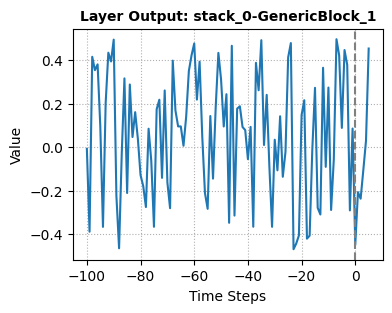

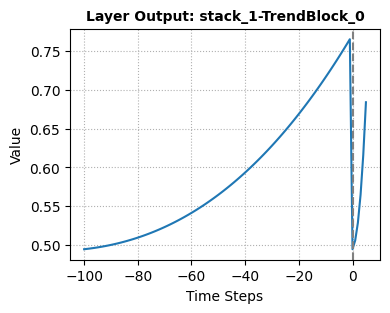

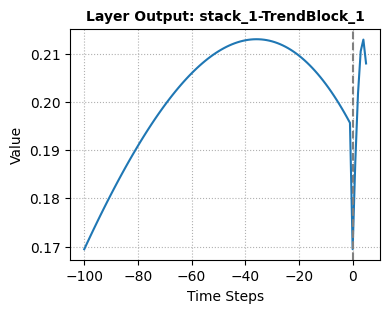

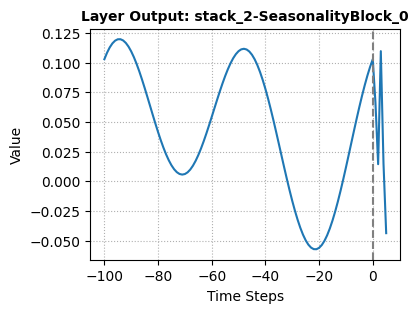

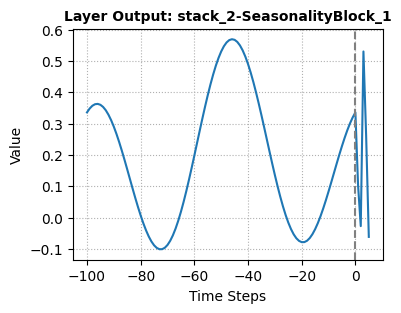

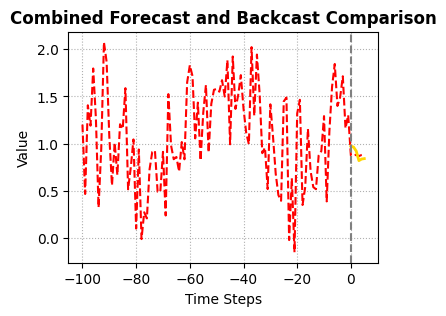

Epoch = 701, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 702, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 703, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 704, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 705, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 706, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 707, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 708, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 709, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 710, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 711, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 712, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 713, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 714, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 715, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 716, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 717, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 718, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 719, Train Loss = 0.0012, Test Loss = 

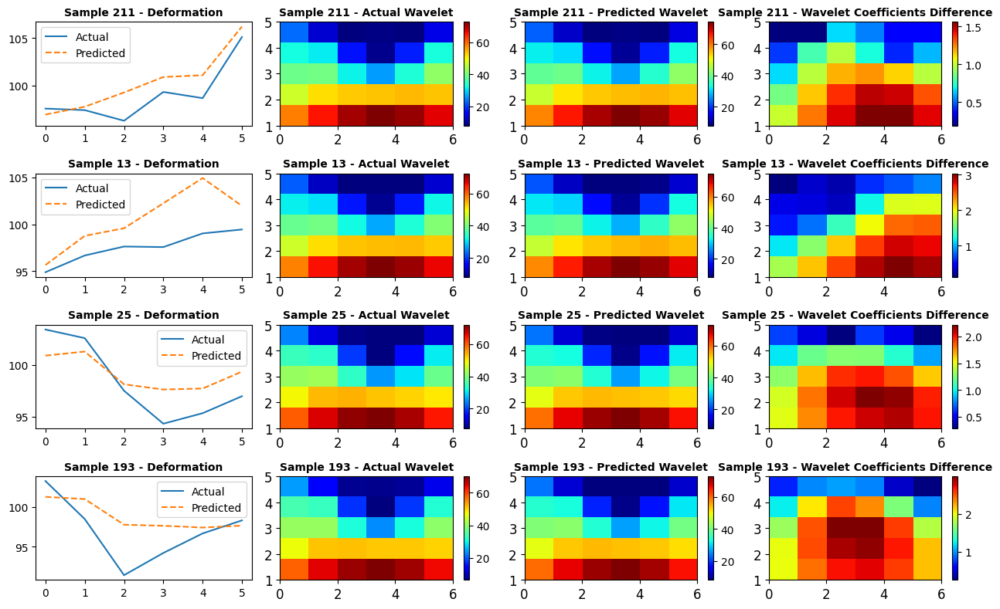

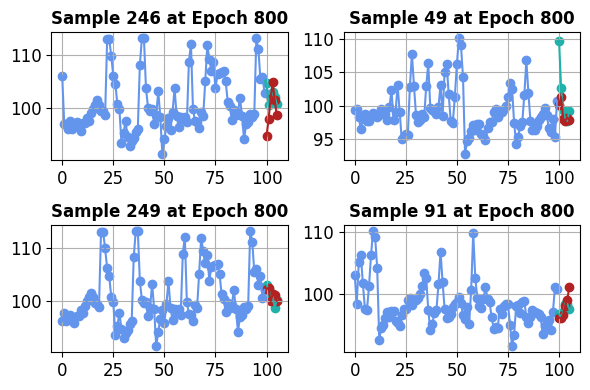

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 1.06844008e-01, -2.56652266e-01, -1.51532531e-01, -3.03400606e-01,
        2.59285092e-01,  2.94177290e-02, -4.54946369e-01, -3.89594764e-01,
        5.03735483e-01,  3.69892269e-01, -5.01131296e-01, -2.64719754e-01,
        4.58668083e-01, -3.01341146e-01, -7.84410685e-02,  4.41370249e-01,
        4.07131702e-01, -3.76387894e-01, -2.30326042e-01,  2.25182176e-01,
       -5.20062983e-01,  4.03974146e-01, -4.12491143e-01, -4.75005835e-01,
       -3.74141216e-01,  4.65191573e-01,  1.12635650e-01,  8.38678032e-02,
        1.86294671e-02, -4.05885220e-01,  4.29383487e-01, -1.34933397e-01,
        4.37075317e-01,  1.02724597e-01,  2.15236578e-04, -1.29421586e-02,
       -1.14186004e-01,  2.01334804e-02, -4.12251443e-01,  2.71253854e-01,
        3.54617655e-01,  4.41119373e-01, -4.24248040e-01,  2.39486545e-01,
       -1.50954202e-01,  3.66219580e-01,  1.93613470e-01, -2.65022010e-01,
       -1.23075716e-01, -2.49395490e-0

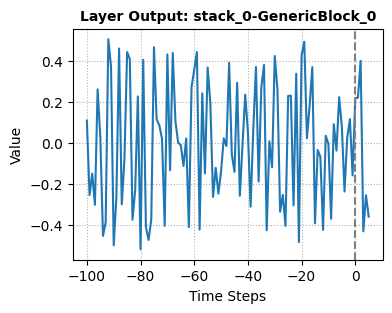

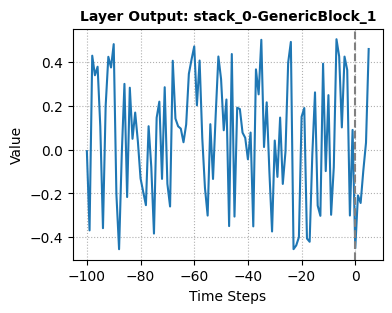

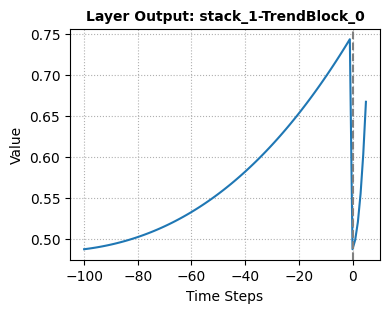

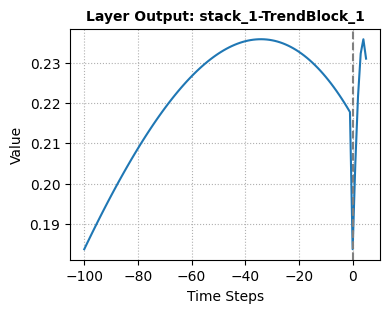

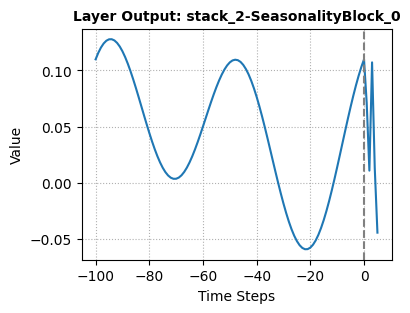

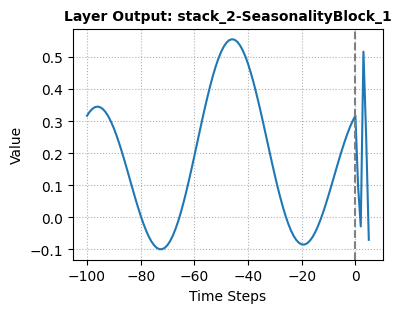

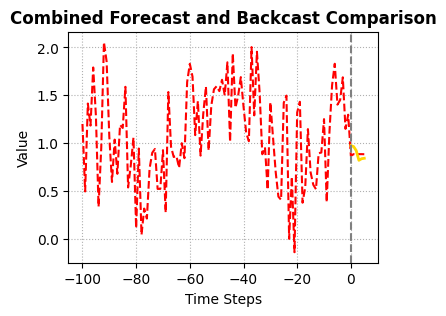

Epoch = 801, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 802, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 803, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 804, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 805, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 806, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 807, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 808, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 809, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 810, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 811, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 812, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 813, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 814, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 815, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 816, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 817, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 818, Train Loss = 0.0012, Test Loss = 0.0013
Epoch = 819, Train Loss = 0.0012, Test Loss = 

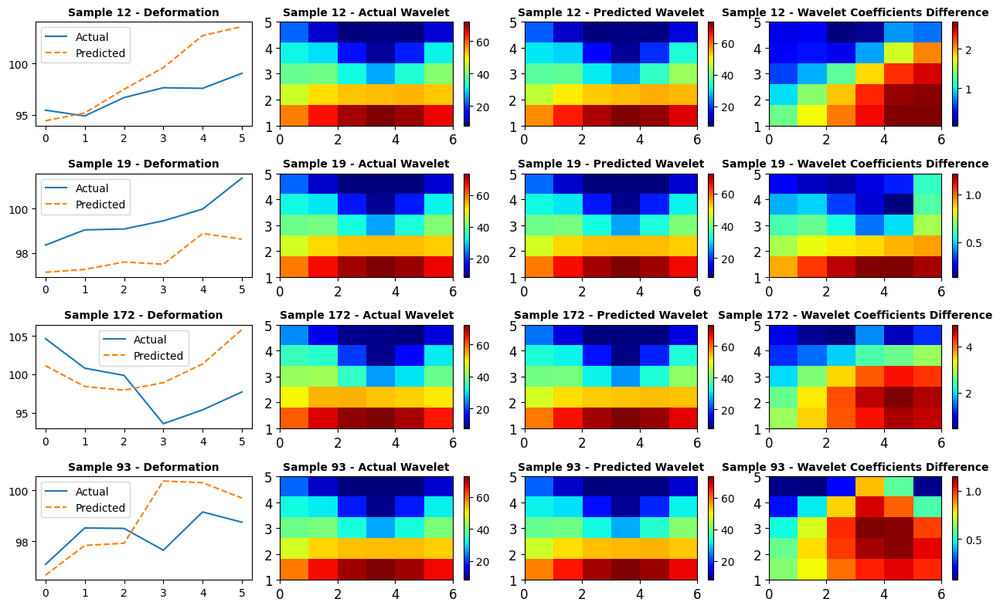

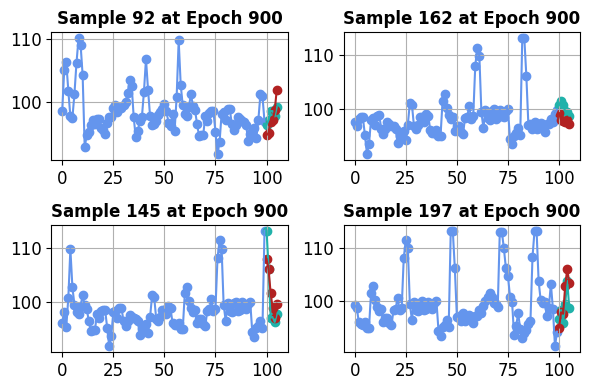

Intermediary outputs: {'stack_0-GenericBlock_0': {'backcast': array([ 0.10657338, -0.25313273, -0.15099226, -0.2979571 ,  0.25514942,
        0.03190195, -0.45433065, -0.3866324 ,  0.49801427,  0.3722768 ,
       -0.49931833, -0.26028708,  0.4612302 , -0.30074018, -0.08161853,
        0.4408455 ,  0.40594864, -0.37211534, -0.2307866 ,  0.22500126,
       -0.51853514,  0.4051794 , -0.40782076, -0.47178432, -0.37011603,
        0.46707436,  0.11378891,  0.083593  ,  0.02271831, -0.40705645,
        0.42956758, -0.13002235,  0.43548536,  0.10451073, -0.00056773,
       -0.01629555, -0.11030542,  0.02444067, -0.40820345,  0.26918864,
        0.3554888 ,  0.44327077, -0.41939718,  0.23621139, -0.14599873,
        0.36463845,  0.19340272, -0.26290303, -0.12471861, -0.24691772,
       -0.13852789,  0.01929842, -0.01428723,  0.39170194, -0.05711195,
       -0.14033356,  0.2939026 , -0.25789335, -0.00748874,  0.22805506,
        0.05030935, -0.30917436,  0.06928104,  0.3720677 , -0.18729395,
  

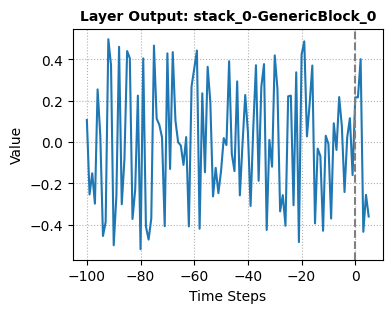

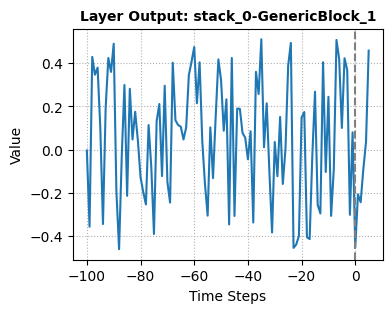

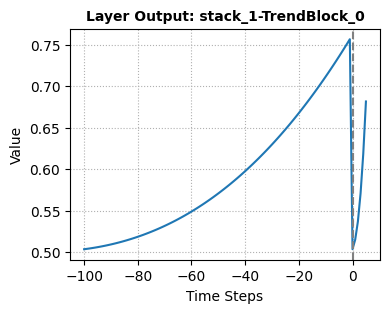

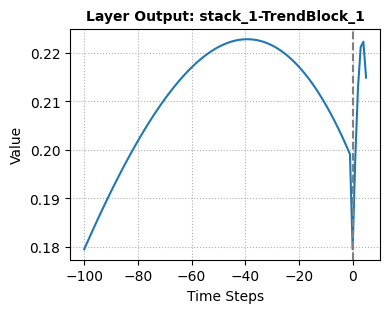

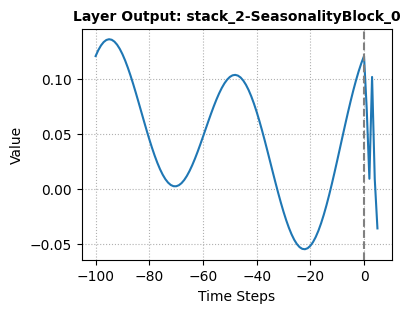

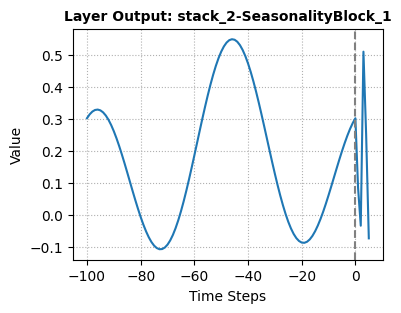

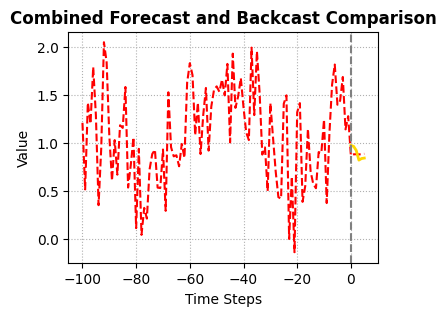

Epoch = 901, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 902, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 903, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 904, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 905, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 906, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 907, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 908, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 909, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 910, Train Loss = 0.0011, Test Loss = 0.0013
Epoch = 911, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 912, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 913, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 914, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 915, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 916, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 917, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 918, Train Loss = 0.0010, Test Loss = 0.0013
Epoch = 919, Train Loss = 0.0010, Test Loss = 

In [62]:
save_dir = 'plots_K3_3B1_100'
os.makedirs(save_dir, exist_ok=True)


net = NBeatsNet2(
    backcast_length=backcast_length,
    forecast_length=forecast_length,
    stack_types=(NBeatsNet2.GENERIC_BLOCK, NBeatsNet2.TREND_BLOCK, NBeatsNet2.SEASONALITY_BLOCK),
    nb_blocks_per_stack=2,
    thetas_dim=(4, 4, 4),
    hidden_layer_units=32
)

optimiser = optim.Adam(lr=1e-4, params=net.parameters())

grad_step = 0


net.enable_intermediate_outputs()

grad_step = 0
for epoch in range(1000):
    net.train()
    train_loss = []
    for x_train_batch, y_train_batch in data_generator(x_train, y_train, batch_size):
        grad_step += 1
        optimiser.zero_grad()
        _, forecast = net(torch.tensor(x_train_batch, dtype=torch.float).to(net.device))
        loss = F.mse_loss(forecast, torch.tensor(y_train_batch, dtype=torch.float).to(net.device))
        train_loss.append(loss.item())
        loss.backward()
        optimiser.step()
    train_loss = np.mean(train_loss)

    net.eval()
    _, forecast = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    test_loss = F.mse_loss(forecast, torch.tensor(y_test, dtype=torch.float)).item()
    p = forecast.detach().numpy()

    if epoch % 100 == 0:

        plt.figure(figsize=(13, 8))

        for i, sample_idx in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):

            actual = y_test[sample_idx] * norm_constant
            predicted = p[sample_idx] * norm_constant


            scales = np.arange(1, min(len(actual), 128))
            actual_cwt, _ = pywt.cwt(actual, scales, 'cmor')
            predicted_cwt, _ = pywt.cwt(predicted, scales, 'cmor')


            cwt_diff = actual_cwt - predicted_cwt


            plt.subplot(4, 4, i * 4 + 1)
            plt.plot(actual, label='Actual')
            plt.plot(predicted, label='Predicted', linestyle='--')
            plt.title(f'Sample {sample_idx} - Deformation',fontweight='bold',fontsize=10)
            plt.legend(fontsize=10)
            plt.xticks(fontsize=10)
            plt.yticks(fontsize=10)

            plt.subplot(4, 4, i * 4 + 2)
            plt.imshow(np.abs(actual_cwt), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Actual Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

            plt.subplot(4, 4, i * 4 + 3)
            plt.imshow(np.abs(predicted_cwt), extent=[0, len(predicted), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Predicted Wavelet',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)



            plt.subplot(4, 4, i * 4 + 4)
            plt.imshow(np.abs(cwt_diff), extent=[0, len(actual), 1, max(scales)], cmap='jet', aspect='auto')
            plt.title(f'Sample {sample_idx} - Wavelet Coefficients Difference',fontweight='bold',fontsize=10)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
            cbar = plt.colorbar()
            cbar.ax.tick_params(labelsize=10)

        plt.tight_layout()



        pdf_filename = f'Wavelet_feature_in_epoch_{epoch}.pdf'
        plt.savefig(os.path.join(save_dir, pdf_filename))
        plt.show()



        subplots = [221, 222, 223, 224]
        plt.figure(1,figsize=(6, 4))
        for plot_id, i in enumerate(np.random.choice(range(len(x_test)), size=4, replace=False)):
            ff, xx, yy = p[i] * norm_constant, x_test[i] * norm_constant, y_test[i] * norm_constant
            plt.subplot(subplots[plot_id])
            plt.grid()
            plot_scatter(range(0, backcast_length), xx, color='#6495ED')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), yy, color='#20B2AA')
            plot_scatter(range(backcast_length, backcast_length + forecast_length), ff, color='#B22222')
            plt.title(f'Sample {i} at Epoch {epoch}',fontweight='bold',fontsize=12)
            plt.xticks(fontsize=12)
            plt.yticks(fontsize=12)
        plt.tight_layout()
        pdf_filename = f'forecast_comparison_epoch_{epoch}.pdf'
        pdf_path = os.path.join(save_dir, pdf_filename)
        plt.savefig(pdf_path)
        plt.show()

        with torch.no_grad():
            predictions, outputs = net.get_generic_and_interpretable_outputs()
            print("Intermediary outputs:", outputs)
            plot_layer_outputs(outputs,epoch)
            plot_combined_forecast_backcast(predictions,  y_test[0],epoch)

    print(f'Epoch = {epoch + 1}, Train Loss = {train_loss:.4f}, Test Loss = {test_loss:.4f}')

In [63]:
from sklearn.metrics import mean_squared_error, mean_absolute_error
from math import sqrt


net.eval()
with torch.no_grad():

    _,predicted_test = net(torch.tensor(x_test, dtype=torch.float).to(net.device))
    predicted_test = predicted_test.detach().cpu().numpy() * norm_constant
    y_test_actual = y_test * norm_constant

    rmse = sqrt(mean_squared_error(y_test_actual, predicted_test))
    mae = mean_absolute_error(y_test_actual, predicted_test)

print(f"Test RMSE: {rmse}")
print(f"Test MAE: {mae}")

Test RMSE: 4.110049195674111
Test MAE: 2.9999326677214064


# Conclusion
Overall, in the context of 3-hour interval oscillatory deformation patterns, the features extracted by the STEN model significantly demonstrate the capture of highly consistent periodic oscillations in the original data. This strong performance exhibits robustness across various input scenarios. We consider this to be an interesting observation. Moving forward, we aim to explore further how neural networks can be adapted to different frequency domains or periods to accurately represent and elucidate the response patterns under the influence of various external factors.

In [64]:
import os
from google.colab import files


# Download all Results
folders_to_zip = [
    '/content/plots_K3_3B1_100',
    '/content/plots_K3_3B1_24',
    '/content/plots_K3_3B1_36',
    '/content/plots_K3_3B1_48',
    '/content/plots_K3_3B1_60',
    '/content/FFT_analysis_results'

]


zip_path = '/content/collected_data_for_Creepinglandslide_3h_various_length.zip'


os.system(f"zip -r {zip_path} " + " ".join(folders_to_zip))

files.download(zip_path)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>